In [1]:
import pyspark
import datetime

In [2]:
sc = pyspark.SparkContext(master="spark://10.0.0.3:6060")
from pyspark.sql import SQLContext
sqlContext = SQLContext(sc)

http://10.0.0.3:4040/

In [83]:
from pyspark.sql import functions as F
import pyspark
import numpy as np
import sys

def seedKernel(dataB, dataIdValue, centroids, k, metric):
    data = dataB.value
    point = dataIdValue[1]
    minD = sys.maxsize 
    for j in range(len(centroids)): 
        distance = metric(point, data[centroids[j]]) 
        minD = min(minD, distance) 
    return int(minD)

def seedClusters(dataB, dataFrame, k, metric):
    data = dataB.value
    centroids = list(np.random.choice(data.shape[0], 1, replace=False))
    for i in range(k - 1):
        print("clusterSeed", i)
        dist = []
        mK = dataFrame.rdd.map(lambda dataIdValue: seedKernel(dataB, dataIdValue, centroids, k, metric))
        mK_collect = mK.collect()
        dist = np.array(mK_collect) 
        next_centroid = np.argmax(dist)
        centroids.append(next_centroid) 
        dist = []
    print(centroids)
    return centroids 

def nearestCenteroidKernel(dataIdValue, centeroidIdValues, metric):
    dataId, dataValue = dataIdValue
    dataNp = np.asarray(dataValue)
    distances = []
    for centeroidId, centeroidValue in centeroidIdValues:
        centeroidNp = np.asarray(centeroidValue)
        distance = metric(dataNp, centeroidNp)
        distances.append(distance)
    distances = np.asarray(distances)
    closestCenteroid = np.argmin(distances)
    return int(closestCenteroid)

def optimiseClusterMembershipSpark(data, dataFrame, n, metric, intitalClusterIndices=None):
    dataShape = data.shape
    dataRDD = dataFrame.rdd
    lengthOfData = dataShape[0]
    if intitalClusterIndices is None:
        index = np.random.choice(lengthOfData, n, replace=False)
    else:
        index = intitalClusterIndices
    listIndex = [int(i) for i in list(index)]
    centeroidIdValues = [(i,data[index[i]]) for i in range(len(index))]
    dataRDD = dataRDD.filter(lambda dataIdValue: int(dataIdValue["id"]) not in listIndex)
    associatedClusterPoints = dataRDD.map(lambda dataIdValue: (dataIdValue[0],nearestCenteroidKernel(dataIdValue, centeroidIdValues, metric)))
    clusters = associatedClusterPoints.toDF(["id", "bestC"]).groupBy("bestC").agg(F.collect_list("id").alias("cluster"))
    return index, clusters

def costKernel(dataB, testCenteroid, clusterData, metric):
    data = dataB.value
    cluster = np.asarray(clusterData)
    lenCluster = cluster.shape[0]
    lenFeature = data.shape[1]
    testCenteroidColumn = np.zeros(shape=(lenCluster, lenFeature), dtype=data.dtype)
    newClusterColumn = np.zeros(shape=(lenCluster, lenFeature), dtype=data.dtype)
    for i in range(0, lenCluster):
        newClusterColumn[i] = data[cluster[i]]
        testCenteroidColumn[i] = data[int(testCenteroid)] 
    pairwiseDistance =  metric(newClusterColumn, testCenteroidColumn)# (np.absolute(newClusterColumn-testCenteroidColumn).sum(axis=1))# metric(newClusterColumn, testCenteroidColumn)
    cost = np.sum(pairwiseDistance)
    return float(cost) #newClusterColumn.shape[1]

def optimiseCentroidSelectionSpark(dataB, dataFrame, centeroids, clustersFrames, metric):
    data = dataB.value
    dataRDD = dataFrame.rdd
    dataShape = data.shape
    newCenteroidIds = []
    totalCost = 0
    totalTime = None
    print(" ")
    for clusterIdx in range(len(centeroids)):
        clusterStartTime = datetime.datetime.now()
        print("cluster:(", clusterIdx, ")------------STARTED")
        oldCenteroid = centeroids[clusterIdx]
        clusterFrame = clustersFrames.filter(clustersFrames.bestC == clusterIdx).select(F.explode(clustersFrames.cluster))
        clusterData = clusterFrame.collect()
        if clusterData:
            clusterData = [clusterData[i].col for i in range(len(clusterData))]
        else:
            clusterData = []
        cluster = np.asarray(clusterData)
        costData = clusterFrame.rdd.map(lambda pointId: (pointId[0], costKernel(dataB, pointId[0], clusterData, metric)))
        #costDataCollect = costData.collect()
        #print(("costDataCollect", costDataCollect))
        #costDataCollectN = np.asarray(costDataCollect)
        #cost = np.sum(costDataCollectN)
        #print(costData.toDF().show())
        cost = costData.map(lambda pointIdCost: pointIdCost[1]).sum()
        pointResult = costData.takeOrdered(1, key = lambda pointId_Cost: pointId_Cost[1])
        totalCost = totalCost + cost
        ##pointResult = costData.sortBy(lambda pointId_Cost: pointId_Cost[1]).take(1)
        if (pointResult):
            bestPoint = pointResult[0][0]
        else:
            bestPoint = oldCenteroid
        #bestPoint = np.argmax(costDataCollectN)
        newCenteroidIds.append(bestPoint)
        clusterTime = datetime.datetime.now() - clusterStartTime
        print("elapsed: " + str(clusterTime))
        print("------------------------FINISHED")
        print(" ")
        if totalTime is not None:
            totalTime = totalTime + clusterTime
        else:
            totalTime = clusterTime
    print("--------------------------------------------------------------")
    print(("routine took<<<", (str(totalTime))))
    return (newCenteroidIds, totalCost)

#vector metrics
def hammingVector(stack1, stack2):
    return (stack1 != stack2).sum(axis=1)
def euclideanVector(stack1, stack2):
    return (np.absolute(stack2-stack1)).sum(axis=1)
# point metrics
def euclideanPoint(p1, p2): 
    return np.sum((p1 - p2)**2) 
def hammingPoint(p1, p2): 
    return np.sum((p1 != p2))

def fit(sc, data, nRegions = 2, metric = "euclidean", seeding = "heuristic"):
    if metric == "euclidean":
        pointMetric = euclideanPoint
        vectorMetric = euclideanVector
    elif metric == "hamming":
        pointMetric = hammingPoint
        vectorMetric = hammingVector
    else:
        print("unsuported metric")
        return

    dataN = np.asarray(data)
    dataB = sc.broadcast(dataN)
    seeds = None
    dataFrame  = sc.parallelize(data).zipWithIndex().map(lambda xy: (xy[1],xy[0])).toDF(["id", "vector"]).cache()
    if (seeding == "heuristic"):
        seeds = list(seedClusters(dataB, dataFrame, nRegions, pointMetric))
    elif (seeding == "random"):
        seeds = None
    else:
        seeds = seeding
    lastCenteroids, lastClusters = optimiseClusterMembershipSpark(dataN, dataFrame, nRegions, pointMetric, seeds)
    print(("starting centeroids", lastCenteroids))
    lastCost = float('inf')
    iteration = 0
    escape = False
    while not escape:
        iteration = iteration + 1
        currentCenteroids, currentCost = optimiseCentroidSelectionSpark(dataB, dataFrame, lastCenteroids, lastClusters, vectorMetric)
        currentCenteroids, currentClusters = optimiseClusterMembershipSpark(dataN, dataFrame, nRegions, pointMetric, currentCenteroids)
        print((currentCost<lastCost, currentCost, lastCost, currentCost - lastCost))
        print(("new centeroids:", currentCenteroids))
        if (currentCost<lastCost):
            print(("iteration",iteration,"cost improving...", currentCost, lastCost))
            lastCost = currentCost
            lastCenteroids = currentCenteroids
            lastClusters = currentClusters
        else:
            print(("iteration",iteration,"cost got worse or did not improve", currentCost, lastCost))
            escape = True
        print("##############################################################")
    bc = lastClusters.collect()
    #unpackedClusters = [bc[i].cluster for i in range(len(bc))]
    clusterObj = {}
    for i in range(len(bc)):
        clusterObj[str(bc[i].bestC)] = bc[i].cluster
    unpackedClusters = []
    for i in range(len(lastCenteroids)):
        stri = str(i)
        if stri in clusterObj:
            unpackedClusters.append(clusterObj[stri])
        else:
            unpackedClusters.append([])
    return (lastCenteroids, unpackedClusters)

In [4]:
import numpy as np #maths
visualFeatureVocabulary = None
visualFeatureVocabularyList = None
with open("data/ORBvoc.txt", "r") as fin:
    extractedFeatures = list(map(lambda x: x.split(" ")[2:-2], fin.readlines()[1:]))
    dedupedFeatureStrings = set()
    for extractedFeature in extractedFeatures:
        strRep = ".".join(extractedFeature)
        dedupedFeatureStrings.add(strRep)
    finalFeatures = []
    for dedupedFeatureStr in list(dedupedFeatureStrings):
        finalFeatures.append([int(i) for i in dedupedFeatureStr.split(".")])
    visualFeatureVocabulary = np.asarray(finalFeatures, dtype=np.uint8)
    visualFeatureVocabularyList  = list(finalFeatures)
print(visualFeatureVocabulary.shape)

(1062686, 32)


In [5]:
%%time
#ret = fit(sc, visualFeatureVocabularyList, 4, "hamming")
#ret = KMedoids.fit(sc, visualFeatureVocabularyList, 4, "hamming")

CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 5.72 µs


In [6]:
#ret[1].show()
#ret[0]

In [7]:
from pyclustering.cluster import cluster_visualizer
from pyclustering.utils import read_sample
from pyclustering.samples.definitions import FCPS_SAMPLES
from pyclustering.samples.definitions import SIMPLE_SAMPLES
sample = read_sample(FCPS_SAMPLES.SAMPLE_GOLF_BALL)


In [8]:
%%time
bestCentroids, bestClusters = fit(sc, sample, 6) #"hamming"

clusterSeed 0
clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
[973, 3013, 0, 952, 993, 1018]
('starting centeroids', [973, 3013, 0, 952, 993, 1018])
 
cluster:( 0 )------------STARTED
elapsed: 0:00:03.787053
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.662370
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:01.628357
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:02.702713
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:02.293017
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:01.559574
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:00:15.633084')
(True, 3441848.3584019984, inf, -inf)
('new centeroids:', [1966, 3587, 15, 1449, 1689, 1117])
('iteration', 1, 'cost improving...', 3441848.3584019984, inf)
###############################

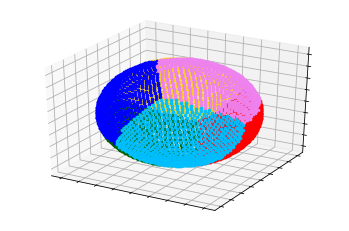

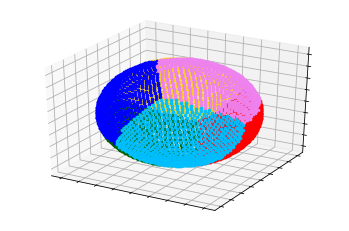

In [9]:
visualizer = cluster_visualizer()
visualizer.append_clusters(bestClusters, sample)
visualizer.show()
#print(bestClustersData)

In [10]:
%%time
initCenteroids = [245624, 0, 2, 5, 6, 9, 13, 21, 33, 37, 44, 55, 58, 61, 92, 131, 175, 183, 257, 263, 425, 660, 755, 797, 800, 1097, 1289, 1513, 2051, 4005, 4382, 5597, 6763, 7118, 10701, 12323, 14348, 30528, 33863, 47500, 53398, 77360, 87744, 101499, 125925, 127333, 143082, 162477, 268387, 328194, 445580, 448231, 524647, 615262, 639498, 1041316, 1, 18, 40, 51, 63, 67, 68, 75, 104, 109, 112, 117, 119, 120, 146, 153, 161, 163, 164, 168, 179, 194, 214, 250, 273, 290, 351, 363, 364, 370, 383, 390, 436, 455, 462, 474, 481, 536, 558, 581, 602, 616, 693, 705, 734, 762, 904, 918, 927, 950, 1075, 1113, 1152, 1198]
bestCentroidsORB, bestClustersORB = fit(sc, visualFeatureVocabularyList, 110, "hamming", initCenteroids)

('starting centeroids', [245624, 0, 2, 5, 6, 9, 13, 21, 33, 37, 44, 55, 58, 61, 92, 131, 175, 183, 257, 263, 425, 660, 755, 797, 800, 1097, 1289, 1513, 2051, 4005, 4382, 5597, 6763, 7118, 10701, 12323, 14348, 30528, 33863, 47500, 53398, 77360, 87744, 101499, 125925, 127333, 143082, 162477, 268387, 328194, 445580, 448231, 524647, 615262, 639498, 1041316, 1, 18, 40, 51, 63, 67, 68, 75, 104, 109, 112, 117, 119, 120, 146, 153, 161, 163, 164, 168, 179, 194, 214, 250, 273, 290, 351, 363, 364, 370, 383, 390, 436, 455, 462, 474, 481, 536, 558, 581, 602, 616, 693, 705, 734, 762, 904, 918, 927, 950, 1075, 1113, 1152, 1198])
 
cluster:( 0 )------------STARTED
elapsed: 0:17:38.367727
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:05:16.382406
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:44:59.968056
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 1:07:26.316510
------------------------FINISHED
 
cluster:

elapsed: 0:06:16.318814
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:02:17.481687
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:02:16.165215
------------------------FINISHED
 
cluster:( 85 )------------STARTED
elapsed: 0:07:55.721471
------------------------FINISHED
 
cluster:( 86 )------------STARTED
elapsed: 0:02:54.522042
------------------------FINISHED
 
cluster:( 87 )------------STARTED
elapsed: 0:05:20.205734
------------------------FINISHED
 
cluster:( 88 )------------STARTED
elapsed: 0:02:51.554923
------------------------FINISHED
 
cluster:( 89 )------------STARTED
elapsed: 0:02:30.232643
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:04:35.111335
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:01:57.057275
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:08:16.367425
------------------------FINISHED
 
cluster:( 9

elapsed: 0:02:25.919533
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:02:17.996239
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:04:19.643336
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:07:32.409252
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:07:56.999233
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:04:45.872636
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:03:30.981867
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:07:07.334723
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:02:35.248912
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:03:31.961204
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:02:37.984883
------------------------FINISHED
 
cluster:( 5

elapsed: 0:24:01.657842
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:27:26.079735
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:08:07.597948
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:12:54.797195
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:23:35.812762
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:06:54.826960
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:07:35.033242
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:13:12.509050
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:16:14.775529
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:14:03.294222
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:06:24.453995
------------------------FINISHED
 
cluster:( 2

elapsed: 0:01:51.352627
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:02:49.910350
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:01:50.127581
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:02:25.745125
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:04:30.434155
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:01:51.642709
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:04:58.061125
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '14:01:56.868434')
(True, 418104820786.0, 428861281176.0, -10756460390.0)
('new centeroids:', [1055284, 113701, 1056333, 673831, 997407, 960407, 32158, 775984, 947224, 622294, 104431, 667436, 796374, 593031, 471951, 310089, 140566, 830339, 1262, 420177, 237084, 469100, 189607, 993854, 574090, 

elapsed: 0:10:00.550864
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:02:25.875131
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:05:21.226653
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:03:56.983085
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:03:05.873318
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:06:48.344261
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:03:23.203970
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:02:32.542966
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:03:54.801072
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:02:42.020995
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:05:43.839666
------------------------FINISHED
 
cluster:( 8

In [11]:
#(bestCentroidsORB, bestClustersORB)
print("done!")

done!


In [12]:
print(bestCentroidsORB)

[1055284, 113701, 1056333, 673831, 997407, 960407, 32158, 775984, 947224, 622294, 104431, 667436, 796374, 593031, 471951, 310089, 140566, 830339, 1262, 420177, 237084, 469100, 189607, 993854, 574090, 462076, 804397, 462421, 164849, 420079, 939441, 19151, 16645, 384138, 123185, 79993, 841126, 804652, 902490, 583799, 1026392, 812676, 43049, 554553, 305994, 455574, 771612, 13630, 252920, 987101, 897266, 229966, 380746, 480749, 769123, 471615, 19129, 551271, 129544, 175141, 808770, 484299, 492457, 485531, 877658, 840021, 141250, 966681, 326245, 518695, 925342, 836367, 294076, 131850, 494743, 559815, 778812, 663930, 771895, 663490, 1035501, 1026322, 599760, 1007685, 219606, 30633, 702926, 97845, 400918, 2854, 290123, 588770, 1026429, 768898, 52082, 289467, 125157, 767716, 789913, 930997, 340674, 25271, 896072, 1008305, 284441, 346835, 931177, 133384, 920868, 734206]


In [13]:
print(bestClustersORB)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [15]:
import json
data = {'centroids': bestCentroidsORB, 'clusters': bestClustersORB}
dataString = json.dumps({'centroids': bestCentroidsORB, 'clusters': bestClustersORB})
with open("110ORB.json", "w") as fout:
    json.dump(data, fout)

In [16]:
print(data["centroids"])

[1055284, 113701, 1056333, 673831, 997407, 960407, 32158, 775984, 947224, 622294, 104431, 667436, 796374, 593031, 471951, 310089, 140566, 830339, 1262, 420177, 237084, 469100, 189607, 993854, 574090, 462076, 804397, 462421, 164849, 420079, 939441, 19151, 16645, 384138, 123185, 79993, 841126, 804652, 902490, 583799, 1026392, 812676, 43049, 554553, 305994, 455574, 771612, 13630, 252920, 987101, 897266, 229966, 380746, 480749, 769123, 471615, 19129, 551271, 129544, 175141, 808770, 484299, 492457, 485531, 877658, 840021, 141250, 966681, 326245, 518695, 925342, 836367, 294076, 131850, 494743, 559815, 778812, 663930, 771895, 663490, 1035501, 1026322, 599760, 1007685, 219606, 30633, 702926, 97845, 400918, 2854, 290123, 588770, 1026429, 768898, 52082, 289467, 125157, 767716, 789913, 930997, 340674, 25271, 896072, 1008305, 284441, 346835, 931177, 133384, 920868, 734206]


In [17]:
[len(i) for i in bestClustersORB]

[17084,
 3637,
 6506,
 11313,
 5531,
 17270,
 17360,
 17692,
 6598,
 15026,
 6875,
 7830,
 6204,
 9313,
 5746,
 6639,
 11420,
 9796,
 4002,
 9404,
 2978,
 8871,
 23432,
 6797,
 6349,
 6628,
 4067,
 5402,
 18528,
 13904,
 10125,
 8477,
 3562,
 12342,
 15574,
 8685,
 1634,
 11676,
 8042,
 15444,
 7885,
 16099,
 6244,
 1810,
 5773,
 25361,
 3658,
 7350,
 4187,
 11206,
 3711,
 6697,
 537,
 1537,
 7294,
 11342,
 23884,
 11400,
 7476,
 9922,
 14580,
 11787,
 9937,
 6674,
 6099,
 13813,
 3198,
 11898,
 2248,
 20335,
 6651,
 4206,
 5602,
 21209,
 12416,
 14335,
 5771,
 11121,
 4915,
 22547,
 12631,
 18055,
 16888,
 8860,
 23033,
 3981,
 15937,
 8602,
 5530,
 12431,
 5249,
 1359,
 6976,
 16499,
 6947,
 13004,
 4220,
 11895,
 7563,
 7045,
 7730,
 6517,
 12238,
 11027,
 8318,
 1390,
 9831,
 12000,
 6806,
 9536]

In [84]:
class Layer:
    levelData = None
    children = []
    parent = None
    wordLayer = False
    def __init__(self, levelData, wordLayer = False, children=None, parent=None):
        self.parent = parent
        self.wordLayer = wordLayer
        self.children = children
        self.levelData = np.asarray(levelData)

#temp = None
def createLayer(centroidIndices, clustersIndicies, data, parent=None, k=110):
    #global temp
    centroidData = np.asarray([data[i] for i in centroidIndices])
    print(centroidData.shape)
    children = []
    parentLayer = Layer(centroidData, False, children, parent)
    for i in range(len(centroidIndices)):
        print((i, len(centroidIndices), len(clustersIndicies) ))
        #print(clustersIndicies)
        clusterIndices = clustersIndicies[i]
        clusterData = [data[i] for i in clusterIndices]
        lenCluster = len(clusterIndices)
        #print(i, lenCluster, k, lenCluster > k)
        if lenCluster > k:
            # we should fit again
            childCenteroids, childClusters = fit(sc, clusterData, k)
            #temp = (childCenteroids, childClusters, bc)
            print((childCenteroids, childClusters))
            clusterLayer = createLayer(childCenteroids, childClusters, clusterData, parentLayer, k)
            children.append(clusterLayer)
        else:
            clusterLayer = Layer(clusterData, True, None, parentLayer)
            children.append(clusterLayer)
    parentLayer.children = children
    return parentLayer

In [ ]:
%%time
layers = createLayer(bestCentroidsORB, bestClustersORB, visualFeatureVocabularyList)
layers

(110, 32)
(0, 110, 110)
clusterSeed 0
clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed

elapsed: 0:00:06.363576
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:06.541313
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:06.409671
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:06.500521
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:06.460894
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:06.540162
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:06.390821
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:06.556004
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:06.450727
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:06.385141
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.428644
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:06.439093
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:06.546082
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:06.571729
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:06.351820
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:06.439349
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:06.503856
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:06.356365
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:06.406125
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:06.694068
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:06.361586
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:06.419699
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:06.535960
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:06.427282
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:06.459933
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:06.422356
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:06.410809
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:06.558072
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:06.419272
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:06.363776
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:06.535729
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:06.609234
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:06.430712
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:06.449917
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:06.542771
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:06.403370
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:06.401446
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:06.363101
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:06.503370
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:06.549693
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:06.488652
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:06.400249
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:06.468124
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:06.554975
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:06.582784
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:06.522864
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:06.457797
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:06.516100
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:06.580456
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:06.543592
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:06.499405
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:06.389687
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.434409
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:06.432154
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:06.423816
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:06.403031
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:06.401358
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:06.519151
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:06.552512
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:06.530301
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:06.554001
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:06.450584
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:06.475294
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:06.479711
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:06.441142
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:06.455465
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:06.484365
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:06.479616
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:06.479016
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:06.455572
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:06.420719
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:06.531349
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:06.423774
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:06.458971
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:06.551560
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:06.441977
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:06.668210
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:06.443880
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:06.431045
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:06.467250
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:06.457812
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:06.537734
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:06.448187
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:06.482714
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:06.489735
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:06.372260
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:06.486916
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:06.480421
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:06.567723
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:06.424167
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:06.467017
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:06.383185
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:06.464051
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:06.522677
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:06.648039
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:06.454742
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.445412
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:06.516338
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:06.446188
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:06.483846
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:06.345997
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:06.653966
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:06.530390
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:06.444626
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:06.618321
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:06.426356
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:06.466193
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:06.451890
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:06.538760
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:06.465098
------------------------FINISHED
 
cluster:( 3

([6213, 14150, 686, 5352, 13077, 11102, 14702, 12695, 487, 4537, 3065, 9324, 6745, 2224, 11262, 14700, 11043, 8502, 11873, 3381, 2460, 15075, 12096, 8631, 300, 14439, 15624, 7539, 7043, 2645, 7412, 5951, 6027, 13541, 7786, 4514, 9614, 2615, 3322, 16822, 16569, 11835, 1335, 9395, 2209, 16146, 15016, 13329, 1569, 9537, 10879, 10494, 5319, 14553, 10971, 16653, 10516, 12230, 6979, 4136, 1994, 7810, 16955, 4949, 15638, 16909, 14302, 10348, 16472, 6466, 15095, 279, 426, 10369, 2512, 11134, 4756, 5095, 8654, 12394, 6574, 9980, 1446, 12401, 931, 11727, 3922, 4208, 15688, 9850, 14012, 8500, 16669, 15495, 3391, 12033, 11630, 8602, 8358, 13919, 14631, 5022, 11090, 3677, 8130, 2934, 544, 8063, 7843, 14907], [[17, 20, 23, 72, 127, 163, 170, 257, 268, 330, 443, 484, 496, 535, 630, 641, 719, 749, 762, 798, 818, 832, 847, 854, 880, 971, 1019, 1046, 1093, 1128, 1153, 1171, 1186, 1200, 1222, 1262, 1291, 1308, 1341, 1343, 1359, 1382, 1498, 1518, 1522, 1550, 1665, 1687, 1690, 1726, 1732, 1733, 1739, 1740,

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.575663
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.555990
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.624434
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.543621
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.597003
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.515734
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.521296
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.606637
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.514363
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.537144
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.582600
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.648952
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.561190
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.568813
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.577682
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.553566
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.530459
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.586313
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.523216
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.530289
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.553843
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.525857
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.572274
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.530999
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.559507
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.532719
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.571694
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.524610
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.579618
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.542522
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.538300
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.532908
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.508301
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.557696
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.529685
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.565651
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.545769
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.584226
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.524832
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.532937
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.567160
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.569727
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.483759
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.528614
------------------------FINISHED
 
cluster:( 1

clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[79, 74, 88, 70, 59, 20, 155, 136, 134, 82, 93, 129, 101, 109, 60, 86, 44, 139, 48, 123, 144, 14, 83, 19, 51, 80, 150, 125, 103, 17, 35, 110, 120, 34, 41, 132, 25, 152, 151, 47, 108, 76, 119, 45, 146, 140, 112, 62, 1, 128, 49, 24, 92, 28, 81, 43, 75, 57, 4, 39, 13, 56, 21, 149, 77, 95, 121, 18, 54, 113, 114, 148, 124, 30, 40, 6, 11, 90, 116, 153, 0, 130, 42, 147, 22, 138, 154, 72, 73, 27, 32, 31, 98, 12, 117, 2, 100, 99, 127, 63, 8, 68, 3, 89, 23, 135, 115, 55, 78, 111]
('starting centeroids', [79, 74, 88, 70, 59, 20, 155, 136, 134, 82, 93, 129, 101, 109, 60, 86, 44, 139, 48, 123, 144, 14, 83, 19, 51, 80, 150, 125, 103, 17, 35, 110, 120, 34, 41, 132, 25, 152, 151, 47,

elapsed: 0:00:03.543559
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.546150
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.499191
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.592501
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.547743
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.515094
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.550033
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.514434
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.574574
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:14.661700
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.955281
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.568954
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.471467
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.516834
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.509326
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.522902
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.549610
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.520529
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.526566
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.472447
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:03.517596
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:00:03.473948
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.537205
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.527408
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.527215
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.482508
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.501754
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.478635
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.463380
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.505428
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.494699
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.521159
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.555423
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.525652
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.507423
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.519729
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.544458
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.539586
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.531183
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.494900
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.517347
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.488392
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.564215
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.528020
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.523760
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.552029
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.547802
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.509207
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.518530
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.529973
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.537470
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.569041
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.524320
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.550262
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.520310
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.541012
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.529407
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.468449
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.540840
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.529798
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.536927
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.468194
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.550688
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.523409
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.537996
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.482300
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.579368
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.579082
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.544531
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.579551
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.550544
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.513051
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.517199
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.573164
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.566075
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.558514
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.553655
------------------------FINISHED
 
cluster:( 7

clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSee

elapsed: 0:00:03.548373
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.574064
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.556065
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.551117
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.538929
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.526785
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.560346
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.540296
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.533725
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.554832
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.533230
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.498113
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.478520
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.545079
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.516001
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.561511
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.549780
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.547803
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.534274
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.525066
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.549886
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.524052
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.479441
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.547172
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.505861
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.520301
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.578053
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.560483
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.560896
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.513618
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.460498
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.571591
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.480380
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.504553
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.556775
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.512465
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.526032
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.489539
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.527924
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.513831
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.506757
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.545398
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.508879
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.536014
------------------------FINISHED
 
clust

elapsed: 0:00:03.595530
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.512696
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.515639
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.538374
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.581226
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.529599
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.572307
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.570282
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.515202
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.584525
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.556603
------------------------FINISHED
 
cluster:( 19

elapsed: 0:00:03.552117
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.485693
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.574371
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.519744
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.536802
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.543410
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.535399
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.524802
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.552323
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.621008
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.528793
------------------------FINISHED
 
clu

elapsed: 0:00:03.549003
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.546589
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.629652
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.568517
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.617170
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.568449
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.595522
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.587191
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.577189
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.596345
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.565587
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.562362
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.540800
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.591879
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.514821
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.536379
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.572486
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.567530
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.600206
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.562708
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.596025
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.569389
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.538420
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.548590
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.568439
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.569902
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.538480
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.518455
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.513418
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.519070
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.585055
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.556860
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.544638
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.591859
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.590276
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.566365
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.609872
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.602156
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.577955
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.627792
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.569078
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.582711
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.572090
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.567167
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.643585
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.623963
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.616149
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.647335
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.692213
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.667274
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.641129
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.612101
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.669739
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.652877
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.661455
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.639393
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.630773
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.682554
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.661228
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.607159
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.604239
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.719012
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.681032
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.642729
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.644259
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.639184
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.707062
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.643798
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.737814
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.660628
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.667002
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.702730
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.629092
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.645220
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.679732
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.603391
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.615064
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.685149
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.635159
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.627632
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.613015
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.630708
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.603572
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.638149
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.647016
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.675473
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.652482
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.619579
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.573401
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.635483
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.614681
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.611965
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.599929
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.599951
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.640243
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.584372
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.603043
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.631203
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.607870
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.581051
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.624268
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.595059
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.616752
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.684050
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.597163
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.606754
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.607089
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.612097
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.596346
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.654590
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.546633
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.527536
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.515316
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.532540
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.496189
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.537493
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.511894
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.543424
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.525218
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.492037
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.517904
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.509010
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.532507
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.557085
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.533885
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.521115
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.552034
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.482196
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.540953
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.565373
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.578370
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.527271
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.547825
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.553996
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.538968
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.500108
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.506371
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.514082
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.565053
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.532166
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.470322
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.613993
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.528274
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.557857
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.566914
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.570493
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.561760
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.502000
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.580800
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.535275
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.504675
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.547967
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.651284
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.506015
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.591923
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.586435
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.565511
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.579263
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.515706
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.587373
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.562370
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.585512
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.524707
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.492446
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.542247
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.585830
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.514798
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.500808
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.547664
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.539196
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.524799
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.552422
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.482368
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.523590
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.504730
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.505837
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.802407
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.526845
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.572791
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.523424
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.572432
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.525937
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.504900
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.531690
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.531757
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.543788
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.488472
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.502416
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.524990
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.540143
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.554754
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.560747
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.512599
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.533415
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.533546
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.571367
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.549236
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.506244
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.577010
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.530904
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.564509
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.507593
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.531168
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.510174
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.565688
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.538532
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.539438
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.552598
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.539202
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.524365
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.502386
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.573054
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.516226
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.534492
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.535181
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.516602
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.569531
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.555420
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.562698
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.568883
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.545314
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.548397
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.572852
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.577619
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.570065
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.546598
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.589344
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.563879
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.563307
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.546216
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.553256
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.588053
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.675962
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.643703
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.604170
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.610666
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.607672
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.572377
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.585988
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.618317
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.603600
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.607874
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.580072
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.622240
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.612458
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.603872
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.563113
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.588196
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.617356
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.582398
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.596011
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.593717
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.596783
------------------------FINISHED
 
cluster:( 4

([76, 133, 173, 78, 179, 61, 86, 152, 26, 59, 49, 43, 192, 5, 29, 181, 13, 19, 107, 2, 35, 67, 146, 15, 137, 128, 125, 182, 50, 105, 21, 58, 134, 126, 149, 30, 89, 194, 183, 57, 163, 169, 161, 124, 55, 42, 150, 148, 110, 171, 75, 66, 199, 164, 197, 165, 25, 151, 93, 201, 88, 160, 95, 158, 193, 113, 162, 11, 6, 90, 18, 87, 159, 168, 65, 8, 16, 62, 119, 189, 46, 157, 10, 117, 122, 47, 103, 174, 147, 83, 20, 135, 130, 92, 45, 63, 82, 14, 156, 91, 79, 36, 202, 144, 140, 38, 190, 153, 96, 136], [[12], [], [], [], [], [], [], [], [98, 170], [], [], [], [], [167], [], [], [], [], [], [], [], [84], [], [], [], [], [], [], [], [], [], [], [], [1], [71], [111], [], [], [77], [27, 70, 101, 108], [138], [], [112, 132, 175], [80], [0, 121], [], [], [40, 64, 185, 191], [], [], [72], [24, 109], [], [69, 102, 143], [176], [139, 166], [], [], [51, 184], [], [68, 177], [188], [37], [], [], [53, 60, 104, 142], [], [], [186, 198], [], [39, 44], [100, 114], [], [], [], [], [200], [17, 34, 129, 178, 203], [

elapsed: 0:00:03.572193
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.607346
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.573130
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.589482
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.626063
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.610515
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.640891
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.619449
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.603396
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.611001
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.598211
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.540448
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.536637
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.505547
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.525298
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.553155
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.522966
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.556648
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.608535
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.541310
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.536485
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.568644
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.525459
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.626169
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.604616
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.621216
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.581564
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.565486
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.557362
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.608485
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.586299
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.607198
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.587549
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.520853
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.503927
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.533789
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.533688
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.566929
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.551114
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.526967
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.534125
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.489580
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.536443
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.540806
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.492135
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.513722
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.525684
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.524192
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.523226
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.492386
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.559381
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.515796
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.516671
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.539058
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.555931
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.513781
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.544294
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.506300
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.468404
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.485674
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.517775
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.464605
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.547800
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.500189
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.496283
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.542739
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.495826
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.577790
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.438108
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.486826
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.518485
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.469999
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.523417
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.538652
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.485025
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.494169
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.500639
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.535621
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.549189
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.522449
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.512041
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.548688
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.534214
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.536607
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.520655
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.566012
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.541901
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.531273
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.479020
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.512846
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.506902
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.516009
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.561061
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.532231
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.506463
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.559905
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.521255
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.504341
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.494499
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.549607
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.529580
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.511961
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.547637
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.585564
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.518845
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.565200
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.595439
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.480055
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.574658
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.529044
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.566561
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.573552
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.567534
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.560963
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.542696
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.523845
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.575337
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.562588
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.565613
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.526215
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.589324
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.580873
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.522503
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.535530
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.541897
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.509404
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.532362
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.550055
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.549050
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.545127
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.574383
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.581354
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.567567
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.514047
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.556929
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.540173
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.554370
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.565146
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.524530
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.577310
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.545511
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.535977
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.550748
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.554680
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.541800
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.597894
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.552599
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.527595
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.567479
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.742424
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.573659
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.591284
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.579374
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.547858
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.591976
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.600575
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.562848
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.580806
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.579844
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.607266
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.563390
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.562910
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.602992
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.561466
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.590828
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.563739
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.624038
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.600382
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.581738
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.585969
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.613690
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.572307
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.565367
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.571354
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.544721
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.646780
------------------------FINISHED
 
cluster:( 16 )-

elapsed: 0:00:03.568656
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.573306
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.518887
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.534611
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.584334
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.536656
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.558573
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.511901
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.463736
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.547796
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.537646
------------------------FINISHED
 
cluste

elapsed: 0:00:03.513910
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.474455
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.539982
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.519605
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.422239
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.505310
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.535934
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.520858
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.523832
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.475264
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.524612
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.459893
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.502642
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.601332
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.478805
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.529793
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.534588
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.488100
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.469812
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.537069
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.508366
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.496749
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.500511
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.526508
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.524754
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.475426
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.482112
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.461487
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.481882
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.509331
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.504478
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.558162
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.464962
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.547914
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.514405
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.445478
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.484261
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.499191
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.525711
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.445670
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.494276
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.494260
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.507503
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.493071
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.483879
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.490722
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.523557
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.440014
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.488528
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.484557
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.480519
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.473536
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.608171
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.506158
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.481112
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.487636
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.552472
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.506450
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.487597
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.447437
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.548543
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.487698
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.574336
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.517642
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.471606
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.499662
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.493404
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.448685
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.449865
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.431354
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.459216
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.432398
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.499821
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.536023
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.451100
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.486543
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.460509
------------------------FINISHED
 
cluster:( 7

clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSee

elapsed: 0:00:03.470415
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.492423
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.456791
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.451741
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.482065
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.529536
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.494116
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.463920
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.534153
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.481959
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.671892
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.515061
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.503341
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.496297
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.510474
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.468820
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.505025
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.476314
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.494284
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.460043
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.486110
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.484606
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.560272
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.556937
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.535319
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.579439
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.520380
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.527533
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.553177
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.542710
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.554320
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.544050
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.593253
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.603784
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.565524
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.510268
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.573628
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.545981
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.585373
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.561002
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.582737
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.513064
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.588272
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.609467
------------------------FINISHED
 
cluster:( 4

([169, 229, 59, 233, 9, 85, 116, 67, 93, 146, 63, 30, 124, 77, 91, 130, 58, 22, 39, 155, 110, 160, 11, 38, 180, 27, 82, 3, 190, 226, 212, 72, 121, 62, 69, 150, 185, 47, 65, 107, 28, 42, 231, 159, 5, 152, 49, 70, 183, 21, 10, 64, 109, 205, 173, 117, 171, 153, 170, 163, 216, 167, 78, 122, 55, 20, 105, 213, 100, 44, 54, 219, 140, 61, 97, 228, 184, 80, 50, 36, 34, 19, 123, 214, 196, 132, 145, 211, 207, 92, 7, 208, 172, 118, 108, 158, 193, 149, 86, 56, 87, 128, 88, 104, 120, 113, 204, 12, 29, 43], [[], [], [40], [71, 95, 102], [96], [], [], [], [], [], [], [], [], [], [200], [], [], [], [], [], [], [], [], [], [227], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [99, 221], [53, 131, 135, 143, 148, 187, 198, 210], [75, 141, 147], [151], [], [57, 101, 115, 225], [], [], [60, 74, 98], [], [199], [26, 103], [], [230], [175], [16], [], [], [], [], [], [], [2, 23, 137], [112, 166], [48, 83, 111, 218], [], [], [46, 182, 222], [], [], [], [4, 84], [181, 206, 220], [], [], [18, 51], [], [1

elapsed: 0:00:03.553126
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.635909
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.612962
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.599721
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.574518
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.666641
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.553209
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.559724
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.545410
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.571264
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.567213
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.546410
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.578546
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.566274
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.556279
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.582469
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.597049
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.610061
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.543832
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.549875
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.566083
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.627815
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.586863
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.557603
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.603470
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.589843
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.605604
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.551710
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.585581
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.601977
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.612824
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.642477
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.588780
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.530189
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.540935
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.553627
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.608621
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.578127
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.557648
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.582664
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.573177
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.579555
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.550713
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.558565
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.520626
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.556447
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.549877
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.609306
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.608164
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.565117
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.560389
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.618170
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.614175
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.564957
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.604533
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.581934
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.597118
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.591838
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.590011
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.575555
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.577364
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.617277
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.598525
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.583741
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.553809
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.589400
------------------------FINISHED
 
cluster:( 7

clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSee

elapsed: 0:00:03.566265
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.588281
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.581342
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.617291
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.636594
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.621651
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.610457
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.626786
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.613428
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.607511
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.602151
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.600323
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.614131
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.603035
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.602263
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.594100
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.579268
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.617353
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.642165
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.576352
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.604094
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.571000
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.613107
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.600829
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.630222
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.634681
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.657648
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.637930
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.608095
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.605422
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.618957
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.636948
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.636249
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.601482
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.597542
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.605912
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.647681
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.625342
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.595969
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.612712
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.629999
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.611312
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.622871
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.637874
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:08.046627
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.780024
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.683583
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.671569
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.656856
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.638845
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.569888
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.554369
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.604352
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.552360
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.550802
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.495984
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.448401
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.502399
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.544325
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.549117
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.478985
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.502937
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.473163
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.474274
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.488574
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.494032
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.489503
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.521468
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.493314
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.460505
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.487230
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.461554
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.446371
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.551961
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.540826
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.559835
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.522699
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.451984
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.450609
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.479267
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.518835
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.500837
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.469577
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.431515
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.523233
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.502878
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.459177
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.488225
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.421628
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.504628
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.550266
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.432955
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.498594
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.442392
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.510552
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.431497
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.472483
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.533691
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.484163
------------------------FINISHED
 
cluster:( 7

clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 7

elapsed: 0:00:03.496998
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.493866
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.556065
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.487751
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.537497
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.515200
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.545743
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.537474
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.512127
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.535342
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.511768
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.542869
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.487294
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.548315
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.541023
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.566391
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.556240
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.564663
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.517015
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.546345
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.544347
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.574528
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.553468
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.546698
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.576088
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.539695
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.495321
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.531530
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.515936
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.556439
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.559752
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.548103
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.550034
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.552397
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.586608
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.534375
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.534384
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.561579
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.578577
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.576569
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.532948
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.529386
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.514017
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.547047
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.554810
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.561906
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.555961
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.550839
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.536720
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.607440
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.548602
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.576325
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.550350
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.528205
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.568799
------------------------FINISHED
 
cluster:( 15 )--

elapsed: 0:00:03.563235
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.531179
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.566896
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.544552
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.564474
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.560070
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.561958
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.580740
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.549027
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.537827
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.552172
------------------------FINISHED
 
cluster

elapsed: 0:00:03.599093
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.617498
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.607643
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.538310
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.591133
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.589978
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.571351
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.586742
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.550701
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.526618
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.556835
------------------------FINISHED
 
cluster:( 7

clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSee

elapsed: 0:00:03.562345
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.545562
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.576346
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.579147
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.575966
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.589142
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.628880
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.548870
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.564106
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.582609
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.569225
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.544201
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.603220
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.566347
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.562105
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.594326
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.550216
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.609846
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.600133
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.573200
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.562032
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.591339
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.586055
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.597447
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.782823
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.616321
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.607935
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.596817
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.603150
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.608550
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.622376
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.605930
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.612703
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.626639
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.611168
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.606407
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.576759
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.654794
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.591039
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.581273
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.595047
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.614962
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.576015
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.619972
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.628341
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.628756
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.591276
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.579078
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.585246
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.598764
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.573182
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.652294
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.651570
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.631318
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.599258
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.611927
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.607517
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.628466
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.605428
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.599314
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.611111
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.634418
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.611797
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.641083
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.613239
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.774061
------------------------FINISHED
 
cluster:( 1

clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[61, 111, 119, 19, 80, 87, 17, 74, 63, 64, 54, 88, 81, 23, 104, 103, 1, 97, 13, 102, 114, 69, 96, 115, 51, 90, 110, 16, 121, 122, 109, 73, 57, 108, 116, 62, 130, 113, 56, 5, 107, 71, 65, 53, 70, 99, 118, 68, 66, 101, 30, 21, 24, 2, 89, 117, 100, 112, 38, 33, 93, 123, 14, 52, 18, 67, 11, 94, 85, 120, 127, 3, 28, 82, 84, 12, 50, 4, 131, 132, 39, 34, 98, 49, 29, 55, 22, 44, 125, 129, 58, 75, 105, 40, 91, 31, 41, 106, 0, 36, 43, 20, 47, 83, 126, 25, 7, 92, 77, 128]
('starting centeroids', [61, 111, 119, 19, 80, 87, 17, 74, 63, 64, 54, 88, 81, 23, 104, 103, 1, 97, 13, 102, 114, 69, 96, 115, 51, 90, 110, 16, 121, 122, 109, 73, 57, 108, 116, 62, 130, 113, 56, 5, 107, 71, 65, 53, 70, 99, 118, 68, 66, 101, 30, 21, 24, 2, 89, 117, 100, 112, 38, 33, 93, 123, 14, 52, 18, 67, 11, 94, 85, 120, 127, 3, 28, 82, 84, 12, 50, 4, 131, 132, 39, 34, 98, 49, 29, 55, 22, 44, 125, 129, 58, 75, 105, 40, 91, 31, 41, 1

elapsed: 0:00:03.579131
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.620683
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.614291
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.584893
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.587547
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.646279
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.584912
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.575630
------------------------FINISHED
 
cluster:( 85 )------------STARTED
elapsed: 0:00:03.577564
------------------------FINISHED
 
cluster:( 86 )------------STARTED
elapsed: 0:00:03.578551
------------------------FINISHED
 
cluster:( 87 )------------STARTED
elapsed: 0:00:03.599969
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.620996
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.588870
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.585261
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.615283
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.571031
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.592782
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:03.568836
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:00:03.611063
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:03.589806
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:03.587420
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:03.560682
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.540728
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.487035
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.483575
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.484930
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.543588
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.645401
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.493630
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.520357
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.498759
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.526139
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.477889
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.488642
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.523041
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.500008
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.531334
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.494585
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.513888
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.498273
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.541914
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.522610
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.502882
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.519892
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.522689
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.530740
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.520258
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.552129
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.498337
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.545504
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.528073
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.549006
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.501784
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.547610
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.546416
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.546148
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.539208
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.525183
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.530713
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.534260
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.631044
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.565812
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.537579
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.545913
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.511915
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.561605
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.505081
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.588471
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.583917
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.539794
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.563372
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.564236
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.536904
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.553977
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.548174
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.525979
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.556768
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.561982
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.590511
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.539568
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.594384
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.538696
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.546551
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.565970
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.591346
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.581750
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.522532
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.569256
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.548370
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.632247
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.580502
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.541565
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.587475
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.538449
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.566351
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.695209
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.537919
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.594344
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.535181
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.551475
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.582154
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.584418
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.552733
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.606828
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.579023
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.549592
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.586951
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.552346
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.554598
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.575750
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.573762
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.592025
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.594609
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.548830
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.580787
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.581218
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.562604
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.551909
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.536610
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.710961
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.587755
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.572120
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.565344
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.569765
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.579790
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.585357
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.586811
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.581444
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.605819
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.580313
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.555322
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.565464
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.599409
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.583873
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.648324
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.575890
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.590715
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.632913
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.571168
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.634580
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.622013
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.595135
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.595062
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.665562
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.724183
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.637057
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.537723
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.516124
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.584204
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.555833
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.576492
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.526467
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.572253
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.487920
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.509325
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.472519
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.518774
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.530527
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.534633
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.498551
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.509104
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.474686
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.510370
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.537340
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.504321
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.485921
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.542233
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.530589
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.556356
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.563794
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.518785
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.575160
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.470484
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.546212
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.505358
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.495264
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.530722
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.499888
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.549224
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.499687
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.510703
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.488054
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.488728
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.513718
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.513716
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.470800
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.502860
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.700516
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.584941
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.513847
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.481325
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.515515
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.497622
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.506778
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.526943
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.489978
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.481238
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.509497
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.529818
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.538386
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.535440
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.552301
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.511932
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.519394
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.499130
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.515596
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.512269
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.499654
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.491883
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.485266
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.553239
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.525276
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.521909
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.513256
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.567183
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.519514
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.511074
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.502834
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.541225
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.535429
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.519002
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.501376
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.532432
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.511641
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.528119
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.579011
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.571313
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.688771
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.563895
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.517596
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.544597
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.514388
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.694806
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.555170
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.522043
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.549300
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.543305
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.546892
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.581964
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.499489
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.541226
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.530170
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.503343
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.505587
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.461072
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.457069
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.506961
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.480306
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.555910
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.532669
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.494138
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.516994
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.489657
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.518623
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.493053
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.448498
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.527397
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.538224
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.521103
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.501508
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.485708
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.496976
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.499452
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.502196
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.480488
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.460908
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.496079
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.506781
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.472282
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.440028
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.487535
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.501386
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.500314
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.720989
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.486598
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.513131
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.477285
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.495706
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.509380
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.488029
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.499109
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.506027
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.506632
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.478378
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.498013
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.501327
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.499944
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.487908
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.507760
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.507302
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.499943
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.507051
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.450675
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.526148
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.516611
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.487427
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.472345
------------------------FINISHED
 
cluster:( 7

clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSee

elapsed: 0:00:03.607071
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.566132
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.602164
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.561970
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.559106
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.566479
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.565378
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.560654
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.578358
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.524894
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.531425
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.502834
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.549239
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.575625
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.571520
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.565726
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.569355
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.651654
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.577514
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.538231
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.540663
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.568847
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.536987
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.588953
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.604865
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.574109
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.603549
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.566126
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.570348
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.556227
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.577156
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.545021
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.588844
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.565306
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.587149
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.592959
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.595799
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.547829
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.642525
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.588832
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.567681
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.607054
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.619916
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.595571
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.572132
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.561005
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.565813
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.613076
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.582456
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.555158
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.568623
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.700997
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.586807
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.555590
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.563799
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.602952
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.576445
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.592159
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.604009
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.559391
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.571602
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.566145
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.573369
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.588700
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.641223
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.601803
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.547625
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.798098
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.569947
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.590895
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.590112
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.633657
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.609092
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.577558
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.569481
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.575375
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.577627
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.588309
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.568527
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.614712
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.584429
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.620630
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.584798
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.591817
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.655120
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.596928
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.598350
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.604423
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.583835
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.608451
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.610965
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.616092
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.595699
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.584468
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.630125
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.640034
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.593609
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.587600
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.621524
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.564400
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.574686
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.582812
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.553126
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.595924
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.641891
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.585892
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.592118
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.610535
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.578166
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.579571
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.575450
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.605693
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.586220
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.579368
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.574284
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.590126
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.587295
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.567215
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.584618
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.600163
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.610513
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.590081
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.632648
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.596531
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.575683
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.575345
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.593114
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.621560
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.620101
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.586805
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.613991
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.587645
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.567153
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.610497
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.621094
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.625138
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.634467
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.614389
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.598276
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.608588
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.581656
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.615662
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.630488
------------------------FINISHED
 
cluster:( 4

([219, 180, 289, 126, 3, 342, 335, 301, 124, 187, 69, 143, 31, 91, 107, 30, 287, 259, 150, 288, 224, 67, 146, 52, 10, 123, 132, 14, 155, 229, 231, 113, 270, 255, 186, 98, 139, 27, 104, 341, 8, 115, 26, 303, 206, 325, 228, 306, 226, 274, 2, 257, 244, 35, 117, 290, 103, 17, 34, 97, 1, 215, 189, 235, 42, 316, 50, 175, 58, 81, 232, 160, 88, 318, 347, 268, 319, 282, 94, 283, 241, 15, 20, 237, 7, 53, 72, 154, 256, 125, 324, 266, 92, 198, 240, 249, 246, 211, 167, 61, 80, 345, 152, 29, 320, 264, 100, 258, 269, 60], [[], [], [], [], [106], [], [], [278], [], [], [], [], [], [33, 202, 247, 297, 339], [70, 161, 296, 307], [], [71], [], [], [], [75], [148, 183, 194, 309], [203], [], [197, 212, 253], [], [], [182, 185], [], [], [], [44, 45, 79, 171, 172, 196, 272], [191, 225], [36, 116, 127, 271], [276], [], [], [], [], [63, 137], [], [], [], [323], [169], [], [], [], [24, 49, 121, 220, 308], [], [199], [13, 122, 142], [43, 99, 119, 149, 177, 267, 302], [], [], [5, 66, 188, 216, 343], [130], [], [0

elapsed: 0:00:03.620823
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.576652
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.593288
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.608751
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.612415
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.595082
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.571196
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.589794
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.618946
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.587470
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.596479
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.606218
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:37.375525')
(True, 29108.0, inf, -inf)
('new centeroids:', [2, 15, 37, 4, 25, 117, 90, 29, 93, 54, 101, 26, 119, 116, 105, 124, 66, 104, 68, 96, 135, 39, 94, 137, 131, 12, 115, 60, 92, 74, 79, 28, 129, 51, 8, 126, 44, 109, 67, 71, 130, 100, 45, 95, 122, 56, 31, 33, 113, 40, 86, 82, 88, 34, 87, 62, 120, 127, 30, 20, 32, 11, 81, 10, 83, 58, 121, 107, 38, 0, 98, 77, 5, 84, 18, 47, 139, 64, 102, 22, 103, 111, 59, 14, 53, 134, 13, 118, 16, 80, 125, 49, 72, 7, 50, 46, 65, 123, 6, 112, 23, 24, 70, 21, 140, 76, 17, 35, 52, 55])
('iteration', 1, 'cost improving...', 29108.0, inf)
##############################################################
 
cluster:( 0 )------------STARTED
elapsed: 0:00:03.595447
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.594065
------------------------FINISHED
 
cluster:( 2 )------------

elapsed: 0:00:03.667976
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.606803
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.649748
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.577945
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.590672
------------------------FINISHED
 
cluster:( 85 )------------STARTED
elapsed: 0:00:03.613290
------------------------FINISHED
 
cluster:( 86 )------------STARTED
elapsed: 0:00:03.585214
------------------------FINISHED
 
cluster:( 87 )------------STARTED
elapsed: 0:00:03.605726
------------------------FINISHED
 
cluster:( 88 )------------STARTED
elapsed: 0:00:03.608946
------------------------FINISHED
 
cluster:( 89 )------------STARTED
elapsed: 0:00:03.591573
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.593817
------------------------FINISHED
 
cluster:( 9

elapsed: 0:00:03.612071
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.630254
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.636327
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:03.580585
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:00:03.654154
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:03.662172
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:03.812369
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:03.589903
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:03.615220
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.590513
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.626292
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:03.497973
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.513317
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.559288
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.507259
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.487662
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.708800
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.447050
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.514891
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.482070
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.509038
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.533245
------------------------FINISHED
 
cluster:( 3

([2, 15, 37, 4, 25, 117, 90, 29, 93, 54, 101, 26, 119, 116, 105, 124, 66, 104, 68, 96, 135, 39, 94, 137, 131, 12, 115, 60, 92, 74, 79, 28, 129, 51, 8, 126, 44, 109, 67, 71, 130, 100, 45, 95, 122, 56, 31, 33, 113, 40, 86, 82, 88, 34, 87, 62, 120, 127, 30, 20, 32, 11, 81, 10, 83, 58, 121, 107, 38, 0, 98, 77, 5, 84, 18, 47, 139, 64, 102, 22, 103, 111, 59, 14, 53, 134, 13, 118, 138, 80, 125, 49, 72, 7, 50, 46, 65, 123, 6, 112, 23, 24, 70, 21, 140, 76, 17, 35, 52, 55], [[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [27], [], [], [], [73], [], [136], [], [], [], [], [], [], [], [], [3, 108], [], [], [], [], [], [], [41, 57], [], [], [85], [], [], [16, 48], [], [36, 91, 133], [], [], [], [], [19], [], [], [1], [], [], [69], [61], [], [75], [], [], [], [], [], [], [63], [], [], [], [], [], [128], [42, 114], [], [132], [], [], [], [], [], [9, 43, 78, 97, 99], [110], [], [], [], [], [106], [89]])
(1

elapsed: 0:00:03.527471
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.497138
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.521195
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.505564
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.558781
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.495961
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.512157
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.504636
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.543499
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.483288
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.513939
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.556858
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.509866
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.535698
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.553580
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.491371
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.515702
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.516275
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.530476
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.567529
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.555102
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.570293
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.534112
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.518156
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.564715
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.499939
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.555153
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.556583
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.511480
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.522742
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.536988
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.499768
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.563793
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.545180
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.571077
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.719915
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.590118
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.544211
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.525216
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.542309
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.578459
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.566346
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.575533
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.563195
------------------------FINISHED
 
cluster:( 7

clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72

elapsed: 0:00:03.533437
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.553664
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.545669
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.612976
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.549298
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.531086
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.515503
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.532912
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.563219
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.571490
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.516594
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.542006
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.765899
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.527663
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.557122
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.534349
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.564495
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.583716
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.548739
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.556165
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.536066
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.509477
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.559710
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.524857
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.550488
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.591262
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.540827
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.508486
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.530561
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.550052
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.536461
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.545074
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.535817
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.541211
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.591820
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.539138
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.588655
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.571355
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.574607
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.564506
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.535195
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.543222
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.531517
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.533024
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.582434
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.591472
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.605911
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.650470
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.605110
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.595795
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.582472
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.581866
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.598330
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.608798
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.591124
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.592704
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.623756
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.630874
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.590183
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.596930
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.596031
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.659443
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.602232
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.586285
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.962131
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.641201
------------------------FINISHED
 
cluster:( 4

([108, 164, 63, 3, 89, 145, 152, 100, 39, 90, 114, 48, 184, 166, 125, 96, 11, 110, 85, 33, 130, 199, 155, 14, 72, 180, 156, 187, 168, 193, 132, 131, 86, 1, 209, 104, 91, 77, 176, 111, 144, 107, 29, 15, 161, 73, 191, 56, 118, 21, 203, 49, 36, 113, 115, 137, 121, 163, 151, 194, 43, 159, 169, 198, 13, 142, 8, 134, 68, 129, 35, 37, 46, 6, 120, 45, 158, 197, 65, 9, 106, 82, 140, 31, 138, 128, 101, 64, 40, 102, 94, 200, 38, 175, 165, 99, 119, 66, 135, 127, 12, 105, 133, 147, 192, 148, 183, 123, 70, 51], [[54, 174, 189, 201], [], [78], [], [], [], [], [], [], [22], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [178], [], [], [], [], [], [23], [], [95, 208], [], [], [], [26, 150, 172], [], [], [5, 170, 179], [], [], [75, 81, 205], [], [], [88], [153], [], [], [], [60, 207], [], [], [18], [], [], [], [], [50, 59, 92, 93], [], [], [17, 185], [], [], [], [], [30, 117, 154, 160], [], [], [], [2, 146], [], [], [195], [177], [16, 19, 42, 87, 126, 136, 173], [24, 32, 124, 171], [28], [1

elapsed: 0:00:03.599010
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.574874
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.554018
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.593900
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.581200
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.621636
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.593941
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.571257
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.580095
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.600955
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.590929
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.559821
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.606597
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.584928
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.562529
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.592562
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.595835
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.572440
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.594035
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.565790
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.550331
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.607744
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.609669
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.577898
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.599618
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.602757
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.589149
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.655022
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.585356
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.618763
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.588735
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.577088
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.589099
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.589466
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.575292
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.593727
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.590788
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.635356
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.613009
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.565845
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.624360
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.606114
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.593670
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.570487
------------------------FINISHED
 
cluster:( 7

clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSee

elapsed: 0:00:03.627102
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.628495
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.628389
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.663476
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.614085
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.618998
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.646826
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.626156
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.663229
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.615792
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.628616
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.611143
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.620607
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.618495
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.628362
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.624716
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.629871
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.643896
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.661833
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.617958
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.624134
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.670601
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.735695
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.533149
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.505106
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.503430
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.473919
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.502103
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.459981
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.483091
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.484635
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.477127
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.537462
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.523789
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.512342
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.493506
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.497441
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.507481
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.500713
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.528782
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.512535
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.544572
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.469988
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.473255
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.486140
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.467260
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.511496
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.531961
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.462527
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.719515
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.515712
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.499934
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.536058
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.523688
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.537012
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.484738
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.534094
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.509977
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.479095
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.502458
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.537090
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.481775
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.494633
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.523020
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.483686
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.514081
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.513163
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.506106
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.523843
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.467970
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.495468
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.504770
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.497932
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.534123
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.519702
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.508490
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.530806
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.527633
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.530643
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.503799
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.525320
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.492951
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.505587
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.513350
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.530341
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.511843
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.536594
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.472479
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.549532
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.537763
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.511916
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.524112
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.513730
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.507963
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.524776
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.531646
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.614731
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.552000
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.548536
------------------------FINISHED
 
cluster:( 7

clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSee

elapsed: 0:00:03.577784
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.546364
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.562339
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.563608
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.524696
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.598292
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.516916
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.580636
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.551273
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.542531
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.539210
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.535395
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.613254
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.583045
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.591705
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.586827
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.540224
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.557012
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.548712
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.566485
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.559771
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.543501
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.567984
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.582532
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.608559
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.569277
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.639201
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.567625
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.587215
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.629884
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.573705
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.596598
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.545116
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.597636
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.596828
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.551603
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.590931
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.585488
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.560947
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.565381
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.551778
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.587750
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.593079
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.579041
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.594784
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.581957
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.557853
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.580061
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.563722
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.580653
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.619114
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.575296
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.587383
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.610825
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.533687
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.567460
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.588727
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.550242
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.601116
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.619227
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.607412
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.608574
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.592998
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.551086
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.572012
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.596985
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.551043
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.551363
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.656068
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.539897
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.556429
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.599476
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.525838
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.581091
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.553925
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.560921
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.615847
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.587904
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.547534
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.608156
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.538323
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.548898
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.527247
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.536870
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.599215
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:07.924427
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.988717
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.657605
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.524273
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.530682
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.528804
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.511849
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.533637
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.506459
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.484288
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.526267
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.515224
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.489078
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.502796
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.569990
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.538799
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.517254
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.503321
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.500494
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.500595
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.465591
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.492456
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.486042
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.517786
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.478931
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.512903
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.525966
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.531168
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.545878
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.581698
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.513096
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.652778
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.578746
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.555435
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.510589
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.497262
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.536192
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.541539
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.570595
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.558696
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.517101
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.524031
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.703189
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.520129
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.504774
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.530754
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.518168
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.545088
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.535124
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.536420
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.568433
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.591774
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.576615
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.586032
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.560231
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.539109
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.556496
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.508045
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.563000
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.558851
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.617729
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.566990
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.534296
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.569934
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.560458
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.580290
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.563143
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.579463
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.584268
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.576976
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.536410
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.630253
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.584135
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.586287
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.541085
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.552728
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.554953
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.556259
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.589044
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.587776
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.576994
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.607282
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.774892
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.573076
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.551214
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.604884
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.598580
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.620591
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.586314
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.585376
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.554991
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.555674
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.532557
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.536066
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.585693
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.557416
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.584753
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.548932
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.569545
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.532276
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.535089
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.574731
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.584105
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.570550
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.551552
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.562111
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.574229
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.552026
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.763076
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.564269
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.575239
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.584010
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.574204
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.742401
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.547184
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.590341
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.591849
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.596462
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.565611
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.575797
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.583628
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.625210
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.603866
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.573180
------------------------FINISHED
 
cluster:( 7

clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSee

elapsed: 0:00:03.494253
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.536850
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.953371
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.502117
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.488994
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.496305
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.486945
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.525040
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.536208
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.502067
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.507338
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.542212
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.517797
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.478340
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.695338
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.473540
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.495271
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.481421
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.543937
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.509531
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.530346
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.472525
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.541010
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.530154
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.475134
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.588567
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.580355
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.526481
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.517102
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.532457
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.538735
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.509482
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.486443
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.498830
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.522799
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.559420
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.497446
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.502721
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.527720
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.528145
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.514602
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.481620
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.456777
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.584925
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.734093
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.517273
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.550038
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.528960
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:08.156297
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.828641
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.685781
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.600884
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.673623
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.648395
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.606930
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.511350
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.484490
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.512806
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.501673
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.497381
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.506894
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.522626
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.495829
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.538801
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.493910
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.527358
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.512230
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.542507
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.514252
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.532246
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.549524
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.497343
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.504345
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.517403
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.489015
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.532879
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.511140
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.515532
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.486435
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.578203
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.479828
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.554319
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.504241
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.517192
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.516344
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.509759
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.715866
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.479283
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.721940
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.564897
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.606191
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.576412
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.511564
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.533056
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.470393
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.528603
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.525132
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.515485
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.490620
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.467411
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.493363
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.433142
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.472225
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.491061
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.480916
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.476546
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.493630
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.469055
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.487914
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.493883
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.493278
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.475585
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.482593
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.481572
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.491708
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.494612
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.473885
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.498571
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.499219
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.495370
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.463799
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.536558
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.521392
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.586099
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.527096
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.572761
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.511491
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.534086
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.567550
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.539271
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.557491
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.562429
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.547997
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.515992
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.525262
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.543849
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.550624
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.528687
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.545918
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.580514
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.564207
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.540824
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.571281
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.513741
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.544022
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.553137
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.565011
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.501904
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.517535
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.545384
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.563406
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.559085
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.576754
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.551878
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.594966
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.598894
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.589133
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.575351
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.554861
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.537681
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.559584
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.582026
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.564712
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:08.102013
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.956320
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.424215
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.487865
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.453528
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.439747
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.464260
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.466623
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.480436
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.475335
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.475579
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.499168
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.470192
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.454605
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.483751
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.459950
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.501047
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.494195
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.455873
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.418678
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.405056
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.471727
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.494955
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.429712
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.455007
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.521034
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.536148
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.482687
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.503956
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.496314
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.502152
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.460245
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.505239
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.525374
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.530522
------------------------FINISHED
 
cluster:( 7

clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSee

elapsed: 0:00:03.604852
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.553305
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.515360
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.527300
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.576429
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.534758
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.602803
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.539980
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.620872
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.571476
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.547921
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.561749
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.514465
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.483403
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.490858
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.524737
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.507810
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.487738
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.557231
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.479142
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.494362
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.501191
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.488487
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.631838
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.494482
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.545675
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.500168
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.489793
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.499595
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.564034
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.513688
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.487221
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.502988
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.480956
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.502179
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.484233
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.532805
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.560043
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.515877
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.495642
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.480977
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.530087
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.539329
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.502114
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.486876
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.533556
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.482917
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.523371
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.527949
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.492225
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.528157
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.430861
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.541923
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.439858
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.496089
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.543215
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.483178
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.524220
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.499145
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.515858
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.513004
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.485289
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.485726
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.520675
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.510382
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.494526
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.501506
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.531559
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.541836
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.526227
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.547128
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.520619
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.533148
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.518882
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.472700
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.530667
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.550976
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.542734
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.551077
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.481249
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.504515
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.723112
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.528536
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.543357
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.545009
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.546522
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.529307
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.484632
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.542260
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.437524
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.536464
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.494126
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.481023
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.505512
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.482126
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.509507
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.501580
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.455430
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.506188
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.546754
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.475420
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.519388
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.490670
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.516722
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.489256
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.492418
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.471860
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.530545
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.451928
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.480670
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.621716
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.577629
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.540004
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.583696
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.587621
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.528219
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.555751
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.502281
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.518619
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.534672
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.495395
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.504967
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.516758
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.522361
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.468440
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.472682
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.533269
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.485240
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.506914
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.486223
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.510436
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.456567
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.479660
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.494893
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.481083
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.506768
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.540015
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.531004
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.485910
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.585967
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.467536
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.478920
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.522848
------------------------FINISHED
 
cluster:( 16 )-

elapsed: 0:00:03.464281
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.492945
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.482149
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.502960
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.454094
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.480704
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.504525
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.445866
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.642602
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.499300
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.487424
------------------------FINISHED
 
cluste

elapsed: 0:00:03.536619
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.521616
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.476478
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.521651
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.445699
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.524466
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.489068
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.498508
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.519988
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.476691
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.707485
------------------------FINISHED
 
cluster:( 7

clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[114, 2, 12, 83, 113, 27, 37, 92, 24, 59, 15, 

elapsed: 0:00:03.507001
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.506619
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.534274
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.522332
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.523143
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.507628
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.512296
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.548298
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.512982
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.554468
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.528497
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.535641
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.511856
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.524510
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.545686
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.517156
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.536004
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.547931
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.535193
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.532481
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.529657
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.570680
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.586447
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.559609
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.629397
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.550207
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.583534
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.604231
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.574556
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.556692
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.593017
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.767910
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.572746
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.585332
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.548421
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.548974
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.621306
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.559797
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.566138
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.577157
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.623760
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.594946
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.592676
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.551801
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.576188
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.600953
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.575322
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.583460
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.595860
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.577100
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.578847
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.603650
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.584659
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.599426
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.571548
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.562708
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.607104
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.606880
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.581364
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.613428
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.561022
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.575120
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.579150
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.561306
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.588518
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.583108
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.549310
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.558981
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.552757
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.556933
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.573046
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.589846
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.552319
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.535644
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.574832
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.556404
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.577503
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.561066
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.550465
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.541987
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.538744
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.572167
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.610211
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.580134
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.569362
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.528415
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.586627
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.543380
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.583596
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.565090
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.591528
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.606013
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.548675
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.508269
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.534264
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.588945
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.562630
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.590686
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.560965
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.577472
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.549506
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.541162
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.553422
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.587512
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.564876
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.575032
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.583556
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.583954
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.572735
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.587581
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.577913
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.571425
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.593611
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.634794
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.538720
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.556059
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.563376
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.467813
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.573625
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.535259
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.546631
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.521243
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.529470
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.571394
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.503617
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.479139
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.533962
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.489172
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.567921
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.697130
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.511397
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.571619
------------------------FINISHED
 
cluster:( 4

([64, 117, 115, 30, 167, 53, 152, 26, 192, 181, 163, 17, 162, 20, 74, 141, 99, 132, 191, 182, 145, 146, 41, 55, 185, 61, 119, 15, 73, 106, 130, 144, 8, 63, 161, 174, 14, 113, 201, 94, 2, 36, 40, 154, 82, 87, 200, 54, 10, 77, 57, 22, 134, 149, 59, 122, 72, 42, 28, 78, 100, 0, 143, 48, 156, 67, 112, 90, 38, 138, 164, 126, 159, 79, 52, 75, 140, 83, 44, 13, 51, 91, 68, 93, 4, 60, 62, 23, 81, 183, 179, 171, 186, 127, 128, 169, 46, 176, 70, 121, 76, 147, 96, 111, 124, 193, 9, 137, 104, 49], [[194], [], [109], [], [], [], [], [], [], [], [], [39], [], [], [], [], [], [], [], [], [29, 86, 103, 178], [], [], [], [], [], [98, 131], [], [24, 31, 189], [166], [], [], [], [88, 125], [16, 21, 33, 45, 184, 195, 196], [], [], [], [], [], [], [], [], [116, 120], [], [19, 65, 85], [], [], [89, 142], [], [], [], [], [1], [180], [], [25, 37, 190], [7], [], [], [165], [], [173], [], [], [158], [129], [], [], [], [12], [139], [50], [110, 168], [], [58], [], [32, 34, 56, 150, 172, 187], [], [155], [], [], [8

elapsed: 0:00:03.575604
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.511839
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.523984
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.510986
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.528309
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.539878
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.491313
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.485391
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.524002
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.555003
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.708319
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.548654
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.571421
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.487091
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.505630
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.709416
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.540911
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.502725
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.505217
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.485778
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.511805
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.522127
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.527758
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.521235
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.567960
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.547167
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.564685
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.482289
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.532077
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.467965
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.544058
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.519334
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.518033
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.475316
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.467807
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.495714
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.478993
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.512768
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.680510
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.533464
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.461524
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.469924
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.465483
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.479480
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.491566
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.512029
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.548895
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.512732
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.486257
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.488242
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.504799
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.476427
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.492334
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.507049
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.533137
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.482562
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.509374
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.475498
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.524458
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.498172
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.492039
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.530341
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.463265
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.523081
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.488644
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.524437
------------------------FINISHED
 
cluster:( 7

clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSee

elapsed: 0:00:03.558486
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.496961
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.503661
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.510927
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.505067
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.549497
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.577826
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.526159
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.513915
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.635443
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.686868
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.538809
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.501526
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.467755
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.625816
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.542018
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.508267
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.548073
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.543013
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.492235
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.484556
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.486126
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:04.034268
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:04.031376
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:04.044091
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:04.079381
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:04.027976
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:04.022617
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:04.138556
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:04.041202
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:04.065308
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:04.044648
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:04.001042
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:04.069944
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:04.079101
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:04.066465
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:04.105428
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:04.042873
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:04.012181
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:04.112660
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:04.082533
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:04.039473
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:04.066697
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:04.106520
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:04.307793
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:04.087816
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:04.128939
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:04.126353
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:04.127943
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:04.133251
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:04.014319
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:04.081070
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:04.024198
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:04.005906
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:04.125397
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:04.399108
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:04.043958
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:04.015356
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:04.078711
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:04.092321
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:04.058568
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:04.091777
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:04.098702
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:04.159275
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:04.073891
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:04.090416
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:04.130961
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:04.110889
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:04.058603
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:04.110776
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:04.116648
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:04.089961
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:04.128447
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:04.060283
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:04.107060
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:04.052204
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:04.043407
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:04.167194
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:04.300688
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:04.132805
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:04.135984
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:04.092719
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:04.148356
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:04.086081
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:04.131928
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:04.072483
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:04.095577
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:04.200613
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:04.106503
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:04.095600
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:04.099705
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:04.083883
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:04.187364
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:04.089733
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:04.085538
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:04.360829
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:04.120452
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:04.178322
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:04.080798
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:04.074627
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:04.119925
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:04.056966
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:04.141396
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:04.038365
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:04.067335
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:04.144228
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:04.044102
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:04.129835
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:04.098350
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:04.078224
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:04.056863
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:04.086927
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:04.137030
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:04.052432
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:04.088388
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:04.062519
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:04.107560
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:04.089680
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:04.021413
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:04.069245
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:04.118248
------------------------FINISHED
 
cluster:( 6

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:04.695972
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:04.734109
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:04.712662
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:04.781710
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:04.575471
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:04.534339
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:04.677167
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:04.579225
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:04.718121
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:04.706232
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:04.573741
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:04.580811
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:04.568882
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:04.662828
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:04.611554
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:04.738519
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:04.564748
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:04.532140
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:04.613572
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:04.757344
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:04.581080
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:04.653673
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:04.659398
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:04.591592
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:04.636144
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:04.643546
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:04.695682
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:04.581959
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:04.569820
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:04.744611
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:04.662550
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:04.641309
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:04.690785
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:04.544862
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:04.629988
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:04.637468
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:04.723595
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:04.725841
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:04.585140
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:04.551344
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:04.591513
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:04.732737
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:04.662918
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:04.682328
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:04.508639
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:04.502943
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:04.553303
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:04.726597
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:04.652739
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:04.576126
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:04.556869
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:04.619594
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:04.614790
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:04.498648
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:04.674489
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:04.628325
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:04.578013
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:04.608791
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:04.524010
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:04.631451
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:04.636149
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:04.585679
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:04.562852
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:04.583356
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:04.481357
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:04.578736
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:04.520401
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:04.592424
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:04.707956
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:04.576037
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:04.613224
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:04.490688
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:04.608351
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:04.594902
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:04.581312
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:04.622280
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:04.486816
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:04.626651
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:04.604031
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:04.724144
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:04.678141
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:04.611526
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:04.541561
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:04.578001
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:04.506719
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:04.651876
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:04.587961
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:04.592755
------------------------FINISHED
 
cluster:( 1

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.611440
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.566194
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.554906
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.597843
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.587707
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.565203
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.550105
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.564888
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.594020
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.538647
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.584806
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.531515
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.513827
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.541387
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.556742
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.537285
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.558787
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.547764
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.533544
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.597182
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.531528
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.522150
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.508087
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.552436
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.567449
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.559700
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.523320
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.508892
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.741552
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.562046
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.551963
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.589641
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.524993
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.560258
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.518054
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.511217
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.517137
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.541397
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.526046
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.588845
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.606290
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.521611
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.555275
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.526441
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.511709
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.553121
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.535981
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.513466
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.537221
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.544295
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.505424
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.526268
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.544273
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.509729
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.534265
------------------------FINISHED
 
cluster:( 15 )--

elapsed: 0:00:03.549477
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.542941
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.535363
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.540788
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.521404
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.525450
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.531177
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.559481
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.601653
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.584257
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.578562
------------------------FINISHED
 
cluster

elapsed: 0:00:03.556422
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.526315
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.521528
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.539070
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.567422
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.568295
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.554655
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.579986
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.541356
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.566077
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.514945
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.554768
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.583966
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.563758
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.534848
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.574184
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.555081
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.626229
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.541797
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.534411
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.580147
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.544703
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.533844
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.547873
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.587494
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.514443
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.539166
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.572534
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.552730
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.561410
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.538300
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.574505
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.541724
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.549127
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.565918
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.545623
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.563806
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.562664
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.547836
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.749570
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.548971
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.546033
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.544510
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.578653
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.568673
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.531021
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.556031
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.731072
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.509093
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.521302
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.569024
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.551781
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.570103
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.549656
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.532050
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.545057
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.579113
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.535020
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.563471
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.553997
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.534297
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.566835
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.580909
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.562147
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.526922
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.594476
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.559047
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.572044
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.558237
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.549011
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.545021
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.528541
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.538071
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.559281
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.602126
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.551035
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.550470
------------------------FINISHED
 
cluster:( 7

clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSee

elapsed: 0:00:03.574323
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.532334
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.597044
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.554209
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.592827
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.627438
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.569363
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.570936
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.555300
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.582514
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.573156
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.612038
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.616955
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.602604
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.568188
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.591140
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.605499
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.587681
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.596750
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.658582
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.583038
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.597961
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.579217
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.577028
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.590959
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.586985
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.611453
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.592100
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.603697
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.618524
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.606245
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.578922
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.622530
------------------------FINISHED
 
cluster:( 16 )-

elapsed: 0:00:03.598229
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.563194
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.569434
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.618671
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.595009
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.587280
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.600490
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.598981
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.577572
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.798474
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.612076
------------------------FINISHED
 
cluste

elapsed: 0:00:03.585574
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.585820
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.545580
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.586968
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.594953
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.589936
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.555044
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.558516
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.569915
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.585290
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.572264
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.551818
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.591054
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.572268
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.580105
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.647120
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.543244
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.658448
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.561731
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.588562
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.583457
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.546852
------------------------FINISHED
 
clust

elapsed: 0:00:03.596885
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.615719
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.577657
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.602410
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.582001
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.577560
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.618467
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.576211
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.542688
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.581106
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.624795
------------------------FINISHED
 
cluster:( 7

clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[42, 108, 154, 138, 50, 56, 98, 86, 84, 80, 83, 59, 63, 1, 67, 29, 85, 68, 5, 72, 163, 164, 117, 113, 133, 79, 115, 58, 90, 81, 19, 78, 97, 35, 96, 64, 38, 76, 37, 71, 60, 143, 122,

elapsed: 0:00:03.521452
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.505175
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.463643
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.542895
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.480866
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.493731
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.452907
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.562138
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.525159
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.457380
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.523425
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.467275
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.483530
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.511073
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.467577
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.504003
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.562550
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.685696
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.515719
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.542259
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.513860
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.503211
------------------------FINISHED
 
cluster:( 5

elapsed: 0:00:03.532801
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.527587
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.461620
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.473351
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.512639
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.471728
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.539056
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.637438
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.532121
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.551433
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.515125
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.485416
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.506120
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.520446
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.492211
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.484019
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.531519
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.490448
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.497051
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.535160
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.505456
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.463648
------------------------FINISHED
 
-

elapsed: 0:00:03.516581
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.498208
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.517570
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.475470
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.529928
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.549086
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.504596
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.513329
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.521409
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.662589
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.532160
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.524589
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.553415
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.515325
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.490695
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.505529
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.470301
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.542499
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.511378
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.484909
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.527406
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:26.636

elapsed: 0:00:03.522196
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.533069
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.620636
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.548016
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.502577
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.537356
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.541694
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.540658
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.547435
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.514756
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.541082
------------------------FINISHED
 
cluster:( 8

clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[4659, 1958, 3149, 3909, 357, 3066, 11118, 9509, 10494, 8500, 6809, 10810, 6173, 8672, 879, 1746, 1437, 7795, 4242, 5174, 2374, 9521, 4894, 7102, 10751, 8002, 3049, 2426, 1202, 5269, 1623, 305, 1110, 6183, 9449,

elapsed: 0:00:05.271523
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:05.459979
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:05.225316
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:05.406730
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:05.268299
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:05.291951
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:05.243036
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:05.275751
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:05.341652
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:05.236846
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:05.322953
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:05.341329
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:05.280182
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:05.340167
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:05.307350
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:05.345578
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:05.343821
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:05.293886
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:05.333797
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:05.339349
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:05.251153
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:05.240435
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:05.363953
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:05.320518
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:05.354241
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:05.335638
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:05.292784
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:05.299223
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:05.269312
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:05.302945
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:05.329455
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:05.254111
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:05.333532
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:05.307141
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:05.311243
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:05.459803
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:05.299957
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:05.343642
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:05.420031
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:05.283196
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:05.363884
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:05.290079
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:05.347003
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:05.282545
------------------------FINISHED
 
cluster:(

elapsed: 0:00:05.392746
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:05.315091
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:05.315820
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:05.365844
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:05.329105
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:05.312733
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:05.296228
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:05.246796
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:05.339473
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:05.296241
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:05.313544
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.586616
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.598470
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.574356
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.567957
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.575681
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.615731
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.612782
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.565793
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.584154
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.598854
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.580643
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.564096
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.553978
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.720502
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.618727
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.552125
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.603034
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.618639
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.521320
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.572966
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.565202
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.586609
------------------------FINISHED
 
cluster:( 4

([175, 214, 304, 90, 293, 44, 188, 57, 3, 109, 233, 28, 344, 137, 8, 165, 313, 201, 27, 191, 368, 39, 292, 325, 208, 225, 220, 365, 0, 118, 32, 112, 318, 330, 277, 262, 156, 361, 72, 150, 148, 91, 223, 215, 151, 82, 131, 140, 126, 351, 341, 4, 320, 71, 120, 219, 42, 17, 274, 51, 354, 70, 269, 197, 163, 346, 54, 194, 231, 47, 12, 240, 367, 67, 111, 324, 34, 16, 113, 38, 53, 55, 22, 228, 10, 26, 48, 253, 93, 259, 207, 203, 276, 337, 5, 146, 230, 63, 306, 101, 245, 31, 338, 173, 342, 13, 96, 258, 14, 213], [[], [79, 216], [], [119], [], [357], [244, 302], [], [], [124, 139], [143, 180, 202], [66, 171, 278], [], [], [50, 69, 73, 229, 235, 271, 294, 303], [288], [], [], [127, 280], [95, 241], [], [11, 170, 177, 181], [84, 209], [], [29, 102, 196, 248, 322, 329, 339, 353], [122, 195], [168, 316], [], [176], [25, 36, 43, 281], [212], [], [], [83, 117, 132], [], [], [19, 103, 154], [], [], [], [78, 210], [296, 297, 331], [], [], [286], [1, 23, 106, 115, 138, 159, 246, 282, 312], [], [237], [25

elapsed: 0:00:03.530879
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.564752
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.504809
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.566082
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.568773
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.575059
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.520791
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.514956
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.499300
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.533323
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.547710
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.524109
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.517913
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:29.494746')
(True, 29284.0, inf, -inf)
('new centeroids:', [115, 136, 7, 120, 32, 23, 68, 44, 74, 141, 132, 121, 133, 116, 34, 93, 69, 124, 20, 118, 75, 95, 106, 137, 103, 43, 29, 48, 105, 55, 101, 9, 36, 134, 81, 108, 1, 73, 56, 100, 142, 90, 64, 140, 13, 8, 126, 37, 80, 86, 61, 125, 3, 24, 139, 15, 60, 49, 85, 0, 42, 40, 107, 63, 76, 82, 5, 21, 17, 114, 128, 135, 6, 38, 14, 59, 102, 18, 28, 25, 84, 35, 27, 30, 47, 10, 12, 138, 78, 51, 99, 33, 11, 98, 2, 131, 110, 39, 91, 94, 111, 88, 26, 66, 127, 112, 65, 22, 96, 119])
('iteration', 1, 'cost improving...', 29284.0, inf)
##############################################################
 
cluster:( 0 )------------STARTED
elapsed: 0:00:03.568892
------------------------FINISHED
 
cluster:( 1 )---------

elapsed: 0:00:03.547255
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.707769
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.545350
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.507535
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.532457
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.532747
------------------------FINISHED
 
cluster:( 85 )------------STARTED
elapsed: 0:00:03.549864
------------------------FINISHED
 
cluster:( 86 )------------STARTED
elapsed: 0:00:03.507017
------------------------FINISHED
 
cluster:( 87 )------------STARTED
elapsed: 0:00:03.557967
------------------------FINISHED
 
cluster:( 88 )------------STARTED
elapsed: 0:00:03.556913
------------------------FINISHED
 
cluster:( 89 )------------STARTED
elapsed: 0:00:03.500335
------------------------FINISHED
 
cluster:( 9

elapsed: 0:00:03.527462
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.614631
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.510429
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.534438
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:03.538125
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:00:03.517779
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:03.501957
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:03.550679
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:03.491099
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:03.564684
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.508156
------------------------FINISHED
 
cluster:( 6

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.464213
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.493353
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.502663
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.486703
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.518178
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.490528
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.519557
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.515796
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.483603
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.491737
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.529807
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.576291
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.532673
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.545409
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.713281
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.571100
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.534565
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.552949
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.540236
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.521150
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.558350
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.548385
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.740808
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.573198
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.558044
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.572483
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.564875
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.571491
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.547198
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.556973
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.571106
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.550730
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.562903
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.851048
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.581149
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.571129
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.569728
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.557698
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.553293
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.533500
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.572880
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.568642
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.568721
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.542699
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.625151
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.652964
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.605516
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.596331
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.608113
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.582390
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.673781
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.572438
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.702560
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.655251
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.585675
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.602346
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.612020
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.572630
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.648189
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.627717
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.610923
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.621043
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.606628
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.652009
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.630412
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.628599
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.640727
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.572521
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.611376
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.603355
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.587918
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.635689
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.595378
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.600186
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.621242
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.629148
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.607911
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.616891
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.598312
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.618063
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.617749
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.655145
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.592794
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.599874
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.594319
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.629002
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.576148
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.590387
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.620818
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.595387
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.587705
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.581909
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.586303
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.558945
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.576664
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.577152
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.577748
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.592121
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.607486
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.575676
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.610861
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.563369
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.602059
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.590010
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.552485
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.604957
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.553127
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.579891
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.566215
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.609403
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.577993
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.581983
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.603119
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.601856
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.606366
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.602637
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.597448
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.596457
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.592383
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.619891
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.567200
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.613956
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.590980
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.574392
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.598253
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.617011
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.572396
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.609632
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.584081
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.625589
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.571421
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.578239
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.612098
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.607146
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.642935
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.636073
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.606361
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.618522
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.650882
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.629009
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.606622
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.607846
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.622512
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.604430
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.615254
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.658866
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.636148
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.635786
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.633663
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.636537
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.784615
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.636772
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.684675
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.618786
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.823401
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.651045
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.629491
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.654165
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.656834
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.622844
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.644159
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.643286
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.667866
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.693070
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.638872
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.602337
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.629638
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.609584
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.645872
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.646363
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.626819
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.644842
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.623445
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.618700
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.617546
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.643903
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.566333
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.628475
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.607390
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.592746
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.614788
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.559784
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.591526
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.583606
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.587127
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.614017
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.607743
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.573819
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.598073
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.587986
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.600666
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.590730
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.595683
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.614623
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.645724
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.598976
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.634417
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.593467
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.464161
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.421166
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.514035
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.506946
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.481833
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.464774
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.428641
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.482507
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.462173
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.428861
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.527918
------------------------FINISHED
 
cluster:( 7

clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSee

elapsed: 0:00:03.516833
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.462089
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.537143
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.488638
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.497507
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.527744
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.504845
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.496293
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.518193
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.518931
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.524925
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.542545
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.485302
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.506952
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.539757
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.506715
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.497632
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.502719
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.498598
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.493547
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.498998
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.523553
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.502174
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.509520
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.499304
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.519361
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.716866
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.517309
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.480408
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.484847
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.482368
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.472305
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.513779
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.530236
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.516456
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.471760
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.497226
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.507940
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.526855
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.496834
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.480230
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.491831
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.503837
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.529367
------------------------FINISHED
 
cluster:( 4

clusterSeed 0
clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clust

elapsed: 0:00:03.511798
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.568872
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.563817
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.494939
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.686852
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.556787
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.552884
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.515983
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.518916
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.519510
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.485714
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.533995
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.511408
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.537804
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.498836
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.569687
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.562145
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.536028
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.535105
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.536677
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.570486
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.552802
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.597941
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.570942
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.516128
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.551534
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.555397
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.520097
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.548547
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.540762
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.566459
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.539044
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.553419
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.604906
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.614819
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.713919
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.562203
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.528268
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.508976
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.550930
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.531154
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.528878
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.586295
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.511027
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.566625
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.542683
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.580721
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.576801
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.587850
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.611030
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.565758
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.566933
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.551242
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.595751
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.572551
------------------------FINISHED
 
cluster:( 7

clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSee

elapsed: 0:00:03.630523
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.597938
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.618322
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.642096
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.640423
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.592786
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.624607
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.640173
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.583732
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.622393
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.638510
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.568090
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.677244
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.638432
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.631140
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.601197
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.637993
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.611919
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.627012
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.614901
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.598641
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.629550
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.643829
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.640857
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.590205
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.607024
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.600562
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.639826
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.618736
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.657815
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.673950
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.607964
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.602315
------------------------FINISHED
 
cluster:( 15 )--

elapsed: 0:00:03.758984
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.629209
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.630033
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.654213
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.635298
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.630454
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.641859
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.857057
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.620877
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.689887
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.622331
------------------------FINISHED
 
cluster

elapsed: 0:00:03.603233
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.641399
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.605946
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.652630
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.657671
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.601370
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.639905
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.678481
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.607160
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.634574
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.613324
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.605614
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.646283
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.623960
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.707955
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.643382
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.662658
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.601765
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.636904
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.643942
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.631001
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.671929
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.636365
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.624701
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.638496
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.679421
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.650091
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.798863
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.610248
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.605642
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.674230
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.640454
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.699467
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.651727
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.653689
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.622882
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.643375
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.633636
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.628679
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.683987
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.655446
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.649051
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.640125
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.625179
------------------------FINISHED
 
cluster:( 4

([157, 207, 243, 210, 136, 160, 206, 130, 41, 217, 126, 162, 59, 137, 218, 52, 103, 165, 60, 5, 70, 65, 188, 105, 228, 21, 175, 226, 169, 12, 128, 215, 155, 19, 117, 200, 219, 174, 114, 73, 233, 109, 44, 221, 15, 50, 28, 20, 134, 77, 119, 240, 46, 191, 93, 227, 135, 189, 148, 107, 78, 239, 187, 184, 198, 192, 57, 29, 98, 16, 138, 147, 32, 7, 62, 141, 101, 66, 97, 43, 51, 104, 54, 36, 204, 146, 39, 81, 74, 241, 186, 197, 194, 80, 84, 225, 142, 246, 171, 118, 63, 111, 196, 40, 195, 6, 166, 179, 158, 121], [[0, 13, 25, 26, 58, 75, 85, 120, 167, 172, 182, 190, 231], [], [92], [], [], [], [], [], [], [], [], [], [48, 49, 56, 71, 82, 116, 133, 139, 152, 180, 232, 236], [203], [], [], [3], [24, 47, 90, 132, 223, 238], [], [181], [], [], [], [110, 161], [122, 212], [208], [79], [], [], [23], [], [], [35, 237], [], [], [], [], [], [], [83, 173], [], [53], [72, 113], [], [131], [14], [], [], [177], [], [17, 143], [38, 69, 102, 144, 235], [115], [], [], [30, 242], [], [], [2, 11, 106, 176], [], [

elapsed: 0:00:03.621809
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.618233
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.612597
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.638908
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.628193
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.620848
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.623825
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.594493
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.669281
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.628029
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.614744
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.671166
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.619183
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.659671
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.620707
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.627155
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.595786
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.651366
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.628734
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.830821
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.613594
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.652019
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.614270
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.634019
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.616306
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.625115
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.651081
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.619881
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.608279
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.622214
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.583473
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.618987
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.628670
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.610149
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.632912
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.591846
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.606613
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.608542
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.677752
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.609600
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.676546
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.735797
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.653316
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.647641
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.544918
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.498949
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.481486
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.537962
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.655042
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.500954
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.464412
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.490801
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.481971
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.559830
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.506321
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.532665
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.501178
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.498458
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.715226
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.524811
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.518162
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.549503
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.484336
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.515309
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.502960
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.529060
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.481236
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.525806
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.495876
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.493246
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.511123
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.488132
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.515323
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.518158
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.479564
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.530822
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.498403
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.496005
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.548232
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.510953
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.520630
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.521763
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.645507
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.531226
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.538013
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.472119
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.544223
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.479809
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.566748
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.562582
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.535333
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.595530
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.532634
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.569236
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.574684
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.566820
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.551094
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.554422
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.562874
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.557667
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.635598
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.606953
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.562573
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.558464
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.567006
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.581233
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.552175
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.604833
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.581681
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.563680
------------------------FINISHED
 
cluster:( 4

([133, 116, 76, 35, 107, 181, 46, 28, 190, 52, 108, 27, 129, 73, 155, 24, 31, 125, 100, 4, 94, 123, 54, 87, 10, 63, 25, 23, 51, 37, 170, 165, 90, 93, 104, 6, 34, 148, 178, 169, 5, 59, 38, 149, 171, 151, 156, 158, 21, 109, 98, 13, 114, 39, 183, 8, 161, 101, 113, 105, 75, 85, 130, 175, 84, 19, 180, 81, 48, 30, 2, 135, 193, 143, 88, 9, 102, 174, 184, 15, 145, 58, 146, 127, 45, 187, 42, 160, 97, 115, 68, 43, 144, 137, 82, 179, 131, 121, 185, 36, 12, 124, 112, 122, 139, 182, 20, 7, 99, 26], [[], [], [], [], [], [150], [], [], [47], [], [], [], [], [], [], [16], [], [], [], [], [], [], [], [], [], [44, 71, 95], [], [1, 70], [], [128], [], [], [], [], [], [], [], [40, 65, 72, 96, 134], [], [], [], [], [], [], [], [], [], [177], [49], [], [], [], [], [147, 163], [], [], [], [91, 110, 157], [], [], [77], [], [], [83], [14, 164], [], [], [55, 132], [78], [], [120], [], [], [50], [192], [], [32], [66], [], [], [], [], [], [167], [], [22, 117, 141], [], [], [86, 189], [], [153], [], [138, 186], [1

elapsed: 0:00:03.594486
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.603550
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.616478
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.563896
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.539641
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.527458
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.535975
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.526893
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.522779
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.496941
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.536137
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.565144
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.530597
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.535892
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.557045
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.570379
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.574257
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.539145
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.521927
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.525178
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.528514
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.557735
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.568311
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.616755
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.577087
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.535039
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.721724
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.548257
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.586522
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.564098
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.606429
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.572544
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.549070
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.568467
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.552272
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.580238
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.538699
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.548302
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.547339
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.563660
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.549669
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.558083
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.613407
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.598422
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.566754
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.615126
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.617683
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.579181
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.554492
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.565341
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.551494
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.560654
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.581433
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.744246
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.612024
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.611426
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.570113
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.593189
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.629050
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.756642
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.609639
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.607863
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.594345
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.601000
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.600033
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.569184
------------------------FINISHED
 
cluster:( 7

clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 7

elapsed: 0:00:03.597004
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.602172
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.590956
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.573420
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.647864
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.574341
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.622243
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.573301
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.749555
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.628939
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.602357
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.604813
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.647682
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.616198
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.599067
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.760292
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.590934
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.627775
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.601967
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.584769
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.597209
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.621746
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.575512
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.647358
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.587802
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.581757
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.586375
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.592256
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.598974
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.612256
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.607765
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.599608
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.601859
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.622764
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.666835
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.621206
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.598230
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.570848
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.631901
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.608224
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.601070
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.575444
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.643894
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.589952
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.627076
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.642660
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.588952
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.595921
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.606016
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.583387
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.623540
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.652445
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.657704
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.592474
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.792517
------------------------FINISHED
 
cluster:( 7

clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSee

elapsed: 0:00:03.609855
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.667096
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.625846
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.639496
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.594637
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.625029
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.582090
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.615255
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.662112
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.586763
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.583950
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.615149
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.620200
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.610939
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.631495
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.599040
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.643194
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.613734
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.637001
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.658608
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.576886
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.661221
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.608556
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.640057
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.664066
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.686991
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.577342
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.593586
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.619386
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.675493
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.659832
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.628975
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.646398
------------------------FINISHED
 
cluster:( 15 )--

elapsed: 0:00:03.614105
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.607197
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.641385
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.645201
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.696355
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.666131
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.657920
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.707495
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.657053
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.667245
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.691271
------------------------FINISHED
 
cluster

elapsed: 0:00:03.578315
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.587741
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.614710
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.604697
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.585298
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.581463
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.636230
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.636310
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.573068
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.786300
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.640922
------------------------FINISHED
 
cluster:( 16 )-

elapsed: 0:00:03.591303
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.575511
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.600052
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.594416
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.616294
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.676910
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.620018
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.628183
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.578259
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.607810
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.604087
------------------------FINISHED
 
cluste

elapsed: 0:00:03.666235
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.659904
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.584053
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.610695
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.611745
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.673514
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.622447
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.614570
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.593203
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.629475
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.637400
------------------------FINISHED
 
cluster:( 7

clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[94, 7, 109, 58, 51, 79, 5, 32, 37, 102, 108, 54, 36, 70, 82, 59, 49, 31, 74, 68, 18, 21, 5

elapsed: 0:00:03.439221
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.476969
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.477825
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.473721
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.449417
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.454982
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.454880
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.460856
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.459107
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.467322
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.487259
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.501264
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.502734
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.462586
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.489957
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.502931
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.514778
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.522037
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.474390
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.508594
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.528761
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.467065
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.520022
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.557278
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.509445
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.527972
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.486234
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.525585
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.499562
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.511183
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.468605
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.512120
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.476083
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.466371
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.533043
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.562022
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.556093
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.515202
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.506697
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.518566
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.496007
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.562637
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.531635
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.513568
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.526205
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.517989
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.546323
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.556087
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.529388
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.570082
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.592507
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.552598
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.585805
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.520424
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.557835
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.580990
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.596560
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.601417
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.549101
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.543069
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.574190
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.536978
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.592906
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.579676
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.579842
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.591086
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.565859
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.578271
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.576230
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.616327
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.591391
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.544992
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.602446
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.591609
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.614022
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.592883
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.564284
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.592750
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.569055
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.604763
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.649823
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.573081
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.556025
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.585272
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.589867
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.589611
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.556741
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.590165
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.575713
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.558648
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.575273
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.520443
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.568540
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.542622
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.587418
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.591835
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.587988
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.556105
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.573871
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.570444
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.571980
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.549705
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.557835
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.575297
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.564874
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.578587
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.604726
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.586483
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.600603
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.611105
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.556312
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.612742
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.580176
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.581289
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.584894
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.739034
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.595511
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.573541
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.586241
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.604243
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.602132
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.582670
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.578822
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.668810
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.567852
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.646199
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.601709
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.584799
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.586713
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.600256
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.588090
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.587922
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.557234
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.577422
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.588622
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.691603
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.573124
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.578326
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.538097
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.635211
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.582529
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.581284
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.570414
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.546510
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.606610
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.552654
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.560587
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.589631
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.565876
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.558584
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.631758
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.552665
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.585147
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.576125
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.630804
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.651070
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.680409
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.603147
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.665048
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.620768
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.601576
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.620235
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.637760
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.645619
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.640065
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.624174
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.589801
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.671407
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.634336
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.612318
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.663267
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.628473
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.648166
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.629286
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.634450
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.617384
------------------------FINISHED
 
cluster:( 4

([119, 240, 138, 82, 214, 51, 14, 169, 166, 147, 40, 114, 62, 47, 99, 156, 63, 41, 36, 185, 130, 198, 142, 66, 200, 249, 46, 32, 159, 108, 88, 167, 80, 110, 212, 219, 9, 61, 90, 192, 239, 15, 137, 74, 21, 183, 81, 2, 128, 7, 222, 123, 68, 16, 245, 5, 93, 221, 98, 59, 175, 174, 246, 69, 209, 121, 152, 56, 164, 116, 145, 43, 133, 135, 234, 127, 38, 140, 106, 215, 224, 176, 178, 186, 155, 107, 18, 52, 76, 29, 33, 20, 146, 48, 75, 95, 194, 42, 39, 149, 195, 4, 65, 225, 96, 243, 188, 172, 165, 227], [[28], [], [], [], [], [], [], [], [], [], [129], [], [], [57], [], [60], [], [], [], [], [8, 50, 173, 177, 230], [], [], [213], [], [], [], [], [77, 92, 113, 189, 208, 242], [], [], [], [49], [179, 238], [17, 54, 204], [], [], [], [], [], [], [], [], [10], [], [44], [30, 89, 196, 210], [235], [211, 220], [101, 151], [], [53, 94, 226], [], [203], [19, 154, 160], [97, 105, 223], [72, 85], [], [91], [], [157, 228], [], [13, 231], [], [], [55, 73, 134, 162, 199, 233, 236], [], [], [], [], [102, 103

elapsed: 0:00:03.642435
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.621991
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.598319
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.620875
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.633727
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.685670
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.631235
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.613472
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.618109
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.672694
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.641466
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.606336
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.612865
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.607430
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.637486
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.625180
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.769662
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.640751
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.661143
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.610862
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.624306
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.619440
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.628008
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.634013
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.850203
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.622879
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.666398
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.637736
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.667468
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.640055
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.649378
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.638965
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.642237
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.680062
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.700485
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.643789
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.622865
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.645350
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.643744
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.653752
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.677862
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.764283
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.677702
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.625721
------------------------FINISHED
 
cluster:( 15 )--

elapsed: 0:00:03.644919
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.720764
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.633824
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.649875
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.658294
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.635266
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.657091
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.639215
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.658255
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.643041
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.655258
------------------------FINISHED
 
cluster

elapsed: 0:00:03.679745
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.660006
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.663542
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.658699
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.695110
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.693238
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.679416
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.669533
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.686861
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.634612
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.687578
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.657034
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.634154
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.643705
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.637564
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.640886
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.648429
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.681106
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.642421
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.672887
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.645451
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.661434
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.538277
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.560498
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.479210
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.514579
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.485843
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.507319
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.521323
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.555818
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.495044
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.489170
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.505347
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.532630
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.489403
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.505941
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.487780
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.540526
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.507229
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.522505
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.703891
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.523689
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.507733
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.504022
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.544727
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.499246
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.510555
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.527384
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.593704
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.736740
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.484374
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.577094
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.532178
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.550425
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.565121
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.795532
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.512493
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.533256
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.497637
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.526387
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.445077
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.520081
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.509084
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.469431
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.536416
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.452837
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.570746
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.538074
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.525688
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.566511
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.563443
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.542026
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.527925
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.536873
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.522567
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.559439
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.583057
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.612991
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.559342
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.539273
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.599771
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.541065
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.538701
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.529857
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.594184
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.580417
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.609557
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.565195
------------------------FINISHED
 
cluster:( 4

([167, 193, 203, 57, 140, 133, 104, 199, 7, 76, 79, 15, 44, 38, 4, 209, 197, 37, 22, 114, 77, 102, 40, 222, 112, 87, 59, 8, 161, 55, 62, 100, 136, 138, 29, 117, 110, 124, 32, 204, 227, 206, 137, 194, 234, 53, 51, 96, 196, 139, 148, 54, 180, 211, 48, 43, 219, 142, 198, 68, 99, 166, 31, 26, 101, 25, 149, 78, 236, 131, 216, 184, 188, 82, 1, 97, 18, 159, 232, 233, 108, 12, 238, 3, 135, 182, 134, 42, 85, 157, 160, 9, 145, 175, 210, 163, 56, 63, 170, 130, 72, 36, 223, 35, 229, 10, 212, 30, 69, 153], [[88, 98, 141, 165, 218], [], [], [], [200], [], [], [], [], [128, 168], [], [174, 220], [95, 115, 171], [173], [], [], [], [], [70, 144, 146, 151, 154], [], [], [49, 61], [], [143], [11, 195, 221, 225], [118, 129, 191, 226], [], [109], [], [], [208], [], [], [], [119, 235], [], [21, 116, 169, 179], [], [66], [125], [], [162], [], [], [], [], [73], [147], [14, 103, 106, 186], [19, 50, 207, 214], [], [], [], [45], [71, 228], [237], [17, 58, 178], [], [], [], [33], [], [64], [187], [92, 152], [], [

elapsed: 0:00:03.715378
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.565917
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.526952
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.569156
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.614907
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.595276
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.567151
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.591790
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.570165
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.598512
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.582587
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.581634
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.559092
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.611595
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.576941
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.563610
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.572429
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.545666
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.568545
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.524488
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.555743
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.579059
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.583957
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.538757
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.560257
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.523320
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.571259
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.566664
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.576281
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.612416
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.550943
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.586973
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.725505
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.576734
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.519933
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.517294
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.527017
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.572655
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.522864
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.528261
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.536020
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.595336
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.503368
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.514938
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.539948
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.551000
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.547710
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.570266
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.541004
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.593618
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.516876
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.499472
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.550474
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.557637
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.682856
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.514825
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.513957
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.539152
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.550275
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.530149
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.522365
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.533440
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.571738
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.681911
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.529752
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.533942
------------------------FINISHED
 
cluster:( 7

clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSee

elapsed: 0:00:03.517723
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.521335
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.529193
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.553964
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.585208
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.541681
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.541323
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.537895
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.538438
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.517114
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.576765
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.572683
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.533516
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.512974
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.552047
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.534292
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.565180
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.563369
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.542939
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.553663
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.532992
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.561497
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.523706
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.544503
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.558027
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.537499
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.549947
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.560769
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.565601
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.534815
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.543626
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.554580
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.537042
------------------------FINISHED
 
cluster:( 16 )-

elapsed: 0:00:03.536012
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.529706
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.588719
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.564314
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.570997
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.560775
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.567747
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.533465
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.548938
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.589687
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.595753
------------------------FINISHED
 
cluste

elapsed: 0:00:03.577152
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.554225
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.575974
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.560254
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.579540
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.587702
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.567930
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.558058
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.537726
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.583854
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.593733
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.549086
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.556414
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.629531
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.546057
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.539183
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.558650
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.544906
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.588575
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.572603
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.586583
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.591461
------------------------FINISHED
 
cl

elapsed: 0:00:03.588437
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.563154
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.576504
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.552791
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.562360
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.592476
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.577973
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.556425
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.581068
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.580648
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.559116
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.486071
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.485231
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.463528
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.485658
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.488624
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.519450
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.503453
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.522178
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.447943
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.534196
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.461265
------------------------FINISHED
 
cluster:( 5

elapsed: 0:00:03.487760
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.487643
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.447671
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.471177
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.461472
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.477642
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.496217
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.502112
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.453769
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.475034
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.467293
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.514967
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.504882
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.647865
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.490992
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.488517
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.481333
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.461117
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.504241
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.484875
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.477031
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:23.801

elapsed: 0:00:03.568603
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.546031
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.544630
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.584414
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.625823
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.565151
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.484976
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.473992
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.519527
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.497355
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.550536
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.543124
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.696794
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.525573
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.493266
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.517464
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.497074
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.547801
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:37.432084')
(True, 11890.0, inf, -inf)
('new centeroids:', [52, 85, 110, 49, 8, 50, 78, 104, 65, 53, 56, 60, 79, 125, 42, 129, 33, 107, 112, 101, 108, 82, 19, 95, 106, 36, 55, 84, 43, 124, 3, 35, 72, 87, 4, 26, 92, 45, 73, 117, 20, 28, 80, 64, 24, 13, 97, 74, 21, 5, 118, 89, 77, 10, 121,

elapsed: 0:00:03.442113
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.524116
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.505448
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.467969
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.483652
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.500227
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.509441
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.470401
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.487785
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.473595
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.488013
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.462203
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.493176
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.514331
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.494911
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.508982
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.484780
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.493919
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.512449
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.496716
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:03.469801
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:00:03.520715
------------------------FINISHED
 
cluster:( 5

elapsed: 0:00:03.508832
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.582598
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.509444
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.487234
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.471810
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.524416
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.630957
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.538063
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.518484
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.514742
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.506422
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.529761
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.544954
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.493567
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.472583
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.508217
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:25.102738')
(False, 3952.0, 3388.0, 564.0)
('new centeroids:', [52, 85, 110, 49, 8, 50, 78, 104, 65, 53, 56, 60, 79, 125, 42, 129, 33, 107, 112, 101, 108, 82, 19, 95, 106, 102, 55, 84, 43, 124, 3, 63, 72, 87, 58, 26, 92, 45, 73, 117, 20, 86, 80, 64, 24, 90, 76, 74, 21, 5, 118, 89, 77, 10, 121, 40, 91, 54, 17, 34, 46, 128, 14, 7, 44, 96, 32, 0, 12, 103, 47, 25, 130, 18, 109, 99, 2, 126, 59, 100, 11, 83, 122, 48, 1, 116, 6, 38, 37, 105, 81, 9, 123, 27, 16, 29, 66, 119, 39, 

elapsed: 0:00:03.466467
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.489704
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.494036
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.492323
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.525350
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.479569
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.487464
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.517579
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.674421
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.578965
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.492108
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.508290
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.496575
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:26.625060')
(True, 31064.0, inf, -inf)
('new centeroids:', [135, 29, 80, 58, 132, 106, 3, 110, 79, 54, 134, 15, 50, 42, 75, 95, 83, 116, 121, 123, 6, 138, 84, 112, 30, 57, 8, 101, 53, 47, 92, 97, 27, 9, 107, 49, 12, 120, 118, 130, 61, 99, 59, 85, 145, 117, 89, 140, 111, 129, 94, 100, 64, 90, 21, 5, 20, 87, 125, 109, 36, 60, 7, 131, 68, 103, 65, 62, 0, 1, 39, 41, 69, 78, 45, 142, 14, 43, 126, 38, 115, 10, 23, 67, 66, 104, 88, 141, 35, 32, 34, 146, 48, 18, 2, 76, 128, 114, 93, 127, 17, 136, 25, 133, 16, 122, 37, 31, 74, 71])
('iteration', 1, 'cost improving...', 31064.0, inf)
##############################################################
 
cluster:( 0 )------------STARTED
elapsed: 0:00:03.540344
------------------------FINISHED
 
cluster:( 1 )-------

elapsed: 0:00:03.482878
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.539437
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.537473
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.586789
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.494345
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.584392
------------------------FINISHED
 
cluster:( 85 )------------STARTED
elapsed: 0:00:03.487849
------------------------FINISHED
 
cluster:( 86 )------------STARTED
elapsed: 0:00:03.487137
------------------------FINISHED
 
cluster:( 87 )------------STARTED
elapsed: 0:00:03.529178
------------------------FINISHED
 
cluster:( 88 )------------STARTED
elapsed: 0:00:03.513503
------------------------FINISHED
 
cluster:( 89 )------------STARTED
elapsed: 0:00:03.508546
------------------------FINISHED
 
cluster:( 9

elapsed: 0:00:03.490996
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.527063
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.488237
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.476921
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.478294
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.525562
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.477633
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.545299
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.533622
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.493365
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.507974
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.546117
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.524162
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.715533
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.513349
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.496375
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.470645
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.502861
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.484485
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.504806
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.612381
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.514349
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.476692
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.507140
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.687093
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.524596
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.528826
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.485332
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.525544
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.498992
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.475336
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.493551
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.535305
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.488017
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.523935
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.498091
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.531070
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.514729
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.538721
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.535196
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.519096
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.492431
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.531485
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.506899
------------------------FINISHED
 
cluster:( 4

(85, 110, 110)
(86, 110, 110)
(87, 110, 110)
(88, 110, 110)
(89, 110, 110)
(90, 110, 110)
(91, 110, 110)
(92, 110, 110)
(93, 110, 110)
(94, 110, 110)
(95, 110, 110)
(96, 110, 110)
(97, 110, 110)
(98, 110, 110)
(99, 110, 110)
(100, 110, 110)
(101, 110, 110)
(102, 110, 110)
(103, 110, 110)
(104, 110, 110)
(105, 110, 110)
(106, 110, 110)
(107, 110, 110)
(108, 110, 110)
(109, 110, 110)
(106, 110, 110)
(107, 110, 110)
(108, 110, 110)
(109, 110, 110)
(4, 110, 110)
clusterSeed 0
clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
cluster

elapsed: 0:00:04.330614
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:04.415944
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:04.364908
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:00:04.374847
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:04.371421
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:04.344521
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:04.403252
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:04.435686
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:04.412204
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:04.519607
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:04.446242
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:04.420181
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:04.372890
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:04.402030
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:04.431808
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:04.354285
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:04.401834
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:04.339911
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:04.454828
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:04.344453
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:04.404108
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:04.368545
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:04.391078
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:08:04.302261')
(True, 701720026.0, 1274009566.0, -572289540.0)
('new centeroids:', [4876, 3927, 2533, 4838, 2651, 4299, 3093, 4176, 5196, 2176, 557, 2041, 1738, 4847, 2, 1684, 1149, 624, 3160, 2940, 859, 531, 740, 2310, 1683, 3650, 3445, 262, 1111, 5210, 550, 3290, 3134, 2973, 4657, 3197, 3444, 5193, 4494, 134, 4642, 4528, 2192, 4468, 348, 1067, 3752, 214, 3049, 3228, 431, 1844, 4793, 4272, 623, 1956, 331, 5170, 956, 824, 4380, 4702, 2439, 1184, 5308, 154, 1136, 405, 4010, 3904, 4338, 5247, 1328, 3432, 5129, 1260, 204, 3731, 2370, 1644, 1528, 370, 2900, 1676, 3962, 5050, 3031, 2255, 4532, 4484, 4777, 132, 5459, 965, 2875, 4119, 5444, 2345, 4794, 3648, 2226, 3346, 3708, 3576, 2200, 4039, 4065, 4687, 2459, 1230])
('iteration', 2, 'cost improving...', 701720026.0, 1274009566.0)
##############################################################
 
clus

elapsed: 0:00:04.360267
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:04.415080
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:04.395163
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:04.394344
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:04.384854
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:04.580096
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:04.406491
------------------------FINISHED
 
cluster:( 85 )------------STARTED
elapsed: 0:00:04.429085
------------------------FINISHED
 
cluster:( 86 )------------STARTED
elapsed: 0:00:04.407409
------------------------FINISHED
 
cluster:( 87 )------------STARTED
elapsed: 0:00:04.387404
------------------------FINISHED
 
cluster:( 88 )------------STARTED
elapsed: 0:00:04.468984
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:04.472893
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:04.358528
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:04.376682
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:04.447838
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:04.422127
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:04.376783
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:04.534677
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:04.416792
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:00:04.384165
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:04.372262
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:04.551488
------------------------FINISHED
 
cluster:( 5

elapsed: 0:00:04.523369
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:04.460429
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:04.415402
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:04.423269
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:04.382210
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:04.395033
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:04.381952
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:04.484357
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:04.376145
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:04.444071
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:04.458134
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:04.503391
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:04.443067
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:04.484925
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:04.394124
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:04.401603
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:08:07.966264')
(True, 603864188.0, 618834436.0, -14970248.0)
('new centeroids:', [2268, 2438, 263, 2729, 2441, 5497, 3478, 518, 1275, 3172, 4851, 3571, 1912, 4868, 1804, 289, 2024, 1611, 69, 3103, 2597, 2359, 2724, 1103, 4056, 1588, 1118, 188, 3359, 1571, 709, 232, 99, 5477, 183, 5111, 4984, 393, 3800, 4244, 113, 940, 538, 598, 4655, 3298, 2251, 2772, 1301, 3228, 4722, 865, 3774, 3085, 1061, 4461, 3510, 2101, 956, 1211, 3418, 1837, 2706, 2246, 1790, 2853, 303, 458, 2928, 131

elapsed: 0:00:04.378217
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:04.437026
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:04.488873
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:04.401994
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:04.404952
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:04.392795
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:04.420026
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:04.471595
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:04.406963
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:04.457575
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:04.389162
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:04.373521
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:04.417208
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:04.456745
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:04.416971
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:04.378434
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:04.437788
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:04.410040
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:04.403645
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:04.429234
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:04.560154
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:04.423524
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.491811
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.502184
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.497940
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.550341
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.536392
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.472100
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.494587
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.512134
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.525216
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.510738
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.510919
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.547955
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.524318
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.516096
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.530399
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.535859
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.490538
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.513108
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.531755
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.519654
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.544759
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.531075
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.541507
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.522450
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.507930
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.546585
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.569215
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.543712
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.505500
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.574010
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.551378
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.516189
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.560253
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.528827
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.553693
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.575766
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.545507
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.571359
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.566128
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.571968
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.557645
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.536317
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.511816
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.594807
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.567684
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.726688
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.621297
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.525792
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.565108
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.541067
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.590335
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.569206
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.550648
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.571868
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.570446
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.563592
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.573216
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.579701
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.556501
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.574379
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.576102
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.565576
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.581709
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.592247
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.574347
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.548579
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.493715
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.522567
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.503823
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.558466
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.545138
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.541140
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.515890
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.535650
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.555461
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.516208
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.547831
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.560290
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.551566
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.567506
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.551854
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.530781
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.553582
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.522965
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.595131
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.612681
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.510707
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.569723
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.533316
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.585274
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.605100
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.570200
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.515559
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.544624
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.555984
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.522042
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.559841
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.559926
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.572515
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:06.276820
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:06.162892
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:06.316433
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:06.077709
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:06.248540
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:06.240404
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:06.184834
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:06.088815
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:06.085589
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.176358
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:06.280403
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:06.175435
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:06.200383
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:06.191419
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:06.187538
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:06.274689
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:06.136052
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:06.283184
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:06.132486
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:06.205094
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:06.412517
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:06.191193
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:06.303423
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:06.250514
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:06.165628
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:06.173581
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:06.188355
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:06.264141
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:06.179945
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:06.158826
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:06.290287
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:06.201987
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:06.233531
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:06.179941
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:06.158331
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:06.166157
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:06.223955
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:06.232098
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:06.322527
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:06.256459
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:06.233409
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:06.171424
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:06.299903
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:06.134642
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:06.292250
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:06.146494
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:06.195529
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:06.132255
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:06.276516
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:06.234138
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:06.185690
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:06.318356
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.200542
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:06.175802
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:06.179377
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:06.163813
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:06.268277
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:06.179537
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:06.233022
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:06.158972
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:06.171224
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:06.430210
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:06.218806
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:06.198977
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:06.226466
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:06.159977
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:06.282612
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:06.279545
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:06.417049
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:06.157979
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:06.287399
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:06.237647
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:06.226516
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:06.360551
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:06.209591
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:06.280962
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:06.272700
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:06.221358
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:06.265578
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:06.399426
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:06.182349
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:06.239351
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:06.243035
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:06.268816
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:06.174271
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:06.189415
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:06.334428
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:06.257069
------------------------FINISHED
 
cluster:( 1

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.727082
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.725148
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.700830
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.708878
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.669773
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.675503
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.678059
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.641265
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.736878
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.733318
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.671357
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.687214
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.625426
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.663064
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.735964
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.779669
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.680020
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.690264
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.686478
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.694626
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.641576
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.686579
------------------------FINISHED
 
cluster:( 4

([174, 244, 411, 284, 412, 447, 304, 220, 218, 31, 83, 434, 328, 456, 449, 227, 157, 292, 231, 472, 339, 440, 346, 124, 222, 22, 121, 280, 40, 486, 396, 247, 314, 262, 329, 485, 89, 44, 457, 129, 3, 476, 23, 311, 169, 426, 415, 50, 76, 170, 397, 332, 63, 69, 13, 27, 24, 306, 0, 350, 308, 259, 91, 480, 254, 153, 369, 256, 286, 342, 391, 333, 41, 393, 395, 281, 325, 163, 459, 279, 267, 128, 137, 275, 366, 270, 217, 42, 372, 363, 241, 461, 132, 223, 35, 291, 448, 335, 80, 344, 206, 258, 321, 378, 458, 444, 474, 155, 431, 66], [[2, 7, 10, 18, 39, 53, 74, 104, 107, 114, 119, 136, 171, 192, 193, 208, 214, 249, 255, 266, 285, 345, 358, 377, 405, 424], [], [418], [], [], [], [387, 468], [161], [], [], [], [], [], [452], [], [353, 386], [], [127], [], [340, 376], [], [6, 466, 484], [], [], [], [207, 269], [], [], [], [72, 144, 265, 331], [271, 348], [], [], [], [], [], [371], [273], [51, 113, 362], [439], [], [], [], [106], [142, 201, 462, 463], [30, 34, 111, 131, 225, 367, 370, 381], [], [], [

elapsed: 0:00:03.646691
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.647683
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.653822
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.614075
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.621764
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.643327
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.615110
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.627190
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.601469
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.606802
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.614978
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.486465
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.478483
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.483946
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.511388
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.490268
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.513051
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.495936
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:33.608964')
(True, 390.0, inf, -inf)
('new centeroids:', [82, 108, 49, 54, 107, 20, 99, 104, 19, 55, 42, 26, 50, 32, 8, 110, 24, 17, 91, 95, 27, 93, 77, 69, 89, 90, 88, 12, 106, 97, 1, 98, 79, 33, 66, 40, 71, 61, 6, 64, 5, 75, 100, 44, 7, 37, 47, 46, 35, 36, 70, 81, 85, 31, 48, 101, 53, 

elapsed: 0:00:03.476795
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.493230
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.449564
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.499693
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.509236
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.542966
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.487672
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.681915
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.500964
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.516390
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.519010
------------------------FINISHED
 
cluster:( 8

clusterSeed 106
clusterSeed 107
clusterSeed 108
[55, 96, 117, 118, 98, 151, 30, 110, 53, 75, 47, 105, 62, 168, 112, 126, 56, 90, 115, 104, 44, 101, 163, 109, 167, 107, 34, 24, 92, 114, 166, 146, 83, 10, 9, 20, 72, 67, 135, 51, 120, 43, 164, 61, 19, 27, 140, 133, 139, 102, 6, 136, 4, 16, 49, 99, 81, 85, 113, 162, 64, 78, 32, 74, 156, 108, 145, 48, 58, 124, 144, 129, 63, 12, 132, 128, 60, 22, 91, 2, 69, 35, 149, 86, 26, 93, 70, 33, 158, 52, 28, 131, 29, 100, 5, 154, 116, 80, 159, 125, 21, 54, 152, 39, 68, 88, 45, 8, 141, 37]
('starting centeroids', [55, 96, 117, 118, 98, 151, 30, 110, 53, 75, 47, 105, 62, 168, 112, 126, 56, 90, 115, 104, 44, 101, 163, 109, 167, 107, 34, 24, 92, 114, 166, 146, 83, 10, 9, 20, 72, 67, 135, 51, 120, 43, 164, 61, 19, 27, 140, 133, 139, 102, 6, 136, 4, 16, 49, 99, 81, 85, 113, 162, 64, 78, 32, 74, 156, 108, 145, 48, 58, 124, 144, 129, 63, 12, 132, 128, 60, 22, 91, 2, 69, 35, 149, 86, 26, 93, 70, 33, 158, 52, 28, 131, 29, 100, 5, 154, 116, 80, 159, 125, 21, 54,

elapsed: 0:00:03.527288
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.546788
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.512254
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.541543
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.513417
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.488903
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.509447
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.502445
------------------------FINISHED
 
cluster:( 85 )------------STARTED
elapsed: 0:00:03.526680
------------------------FINISHED
 
cluster:( 86 )------------STARTED
elapsed: 0:00:03.482849
------------------------FINISHED
 
cluster:( 87 )------------STARTED
elapsed: 0:00:03.517471
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.522833
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.561879
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.528313
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.508745
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.650805
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.558770
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:03.514113
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:00:03.542962
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:03.513052
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:03.512263
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:03.541960
------------------------FINISHED
 
cluster:( 5

elapsed: 0:00:03.541445
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.554555
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.529016
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.519822
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.516350
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.528641
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.526225
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.525251
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.548070
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.488809
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.553727
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.564397
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.553806
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.547581
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:29.967994')
(False, 110022.0, 76852.0, 33170.0)
('new centeroids:', [31, 96, 117, 118, 122, 151, 30, 110, 53, 75, 47, 105, 62, 168, 112, 126, 56, 59, 115, 104, 44, 101, 13, 109, 167, 107, 34, 24, 92, 82, 41, 146, 83, 10, 76, 20, 72, 67, 23, 51, 120, 43, 103, 61, 19, 27, 111, 133, 139, 102, 6, 136, 138, 25, 49, 99, 81, 87, 1, 141, 64, 78, 32, 74, 73, 108, 77, 155, 58, 124, 144, 129, 71, 12, 132, 128, 60, 22, 91, 15, 127, 66, 57, 79, 152, 17, 70, 33, 158, 3, 36, 131, 29, 100, 0, 134, 116, 130, 90, 89, 7, 150, 142, 39, 68, 88, 45, 9, 40, 95])
('iteration', 3, 'cost got worse or did not improve', 110022.0, 76852.0)
#############################################

elapsed: 0:00:03.550064
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.569074
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.500926
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.526664
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.527847
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.572201
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.550092
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:08.270084
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:04.204631
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.724592
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.682315
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.511426
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.541720
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:33.324267')
(True, 111646.0, inf, -inf)
('new centeroids:', [85, 104, 155, 119, 8, 10, 78, 150, 142, 94, 117, 1, 12, 26, 135, 54, 149, 47, 16, 21, 123, 128, 40, 36, 71, 130, 95, 46, 114, 152, 101, 89, 18, 57, 106, 66, 45, 42, 33, 120, 80, 133, 157, 69, 32, 148, 88, 111, 77, 15, 43, 91, 30, 110, 125, 102, 14, 62, 84, 55, 61, 140, 109, 51, 28, 9, 64, 144, 107, 131, 146, 86, 63, 53, 27, 59, 60, 22, 38, 116, 129, 37, 138, 24, 3, 153, 113, 126, 118, 7, 70, 98, 5, 103, 72, 67, 49, 13, 2, 81, 87, 20, 35, 74, 11, 122, 82, 105, 132, 29])
('iteration', 1, 'cost improving...', 111646.0, inf)
##############################################################
 
cluster:( 0 )------------STARTED
elapsed: 0:00:03.478712
------------------------FINISHED
 
cluster:( 1 )

elapsed: 0:00:03.482385
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.459794
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.469159
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.527404
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.684003
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.497418
------------------------FINISHED
 
cluster:( 85 )------------STARTED
elapsed: 0:00:03.525240
------------------------FINISHED
 
cluster:( 86 )------------STARTED
elapsed: 0:00:03.493710
------------------------FINISHED
 
cluster:( 87 )------------STARTED
elapsed: 0:00:03.525584
------------------------FINISHED
 
cluster:( 88 )------------STARTED
elapsed: 0:00:03.524124
------------------------FINISHED
 
cluster:( 89 )------------STARTED
elapsed: 0:00:03.512221
------------------------FINISHED
 
cluster:( 9

elapsed: 0:00:03.530515
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.507571
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.516063
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.567879
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.526465
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.685618
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.475415
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.501659
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.499532
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.525319
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.467287
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.514153
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.534799
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.575174
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.511878
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.532819
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.522969
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.525694
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.521709
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.568461
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.511703
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.543864
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.548868
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.506752
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.499315
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.505340
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.509958
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.527941
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.582750
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.510232
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.559121
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.543126
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.673149
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.549921
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.548371
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.565193
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.609761
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.697181
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.556369
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.528222
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.549747
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.530066
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.544569
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.553043
------------------------FINISHED
 
cluster:( 4

([218, 48, 5, 239, 201, 15, 316, 161, 192, 94, 251, 108, 213, 247, 76, 193, 241, 215, 155, 199, 67, 19, 176, 234, 208, 17, 42, 222, 329, 308, 122, 291, 25, 40, 276, 50, 147, 146, 191, 233, 110, 227, 20, 16, 179, 300, 279, 90, 109, 301, 200, 212, 231, 14, 211, 3, 137, 188, 64, 322, 174, 98, 197, 53, 141, 133, 79, 272, 31, 62, 60, 74, 86, 271, 34, 256, 171, 281, 295, 175, 273, 9, 51, 142, 61, 230, 30, 318, 232, 26, 180, 81, 262, 45, 207, 255, 12, 325, 269, 324, 106, 237, 36, 35, 107, 184, 55, 58, 173, 240], [[129, 163, 266], [], [], [], [], [33, 123, 160, 313], [], [], [289], [], [23, 298, 328], [124], [], [151], [], [], [77, 93, 181], [], [], [], [], [139], [], [210], [167], [], [57], [], [185], [292], [290], [54, 149, 275], [], [], [28, 65, 72, 88, 238, 245, 254], [], [87], [], [], [], [], [], [43, 101, 164, 224, 243, 249, 303, 319, 321], [13, 121, 125, 195], [], [], [10, 44, 100, 128, 190, 196, 214, 217, 267, 315, 326, 330], [7, 71, 73, 91, 97, 102, 105, 131, 169, 194, 216, 228, 258, 

elapsed: 0:00:03.511383
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.573124
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.526686
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.524507
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.527556
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.567471
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.553280
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.522689
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.550302
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.599719
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.511001
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.558998
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:28.788069')
(True, 1121620.0, inf, -inf)
('new centeroids:', [107, 220, 304, 180, 26, 73, 5, 0, 2, 117, 284, 240, 156, 25, 121, 86, 23, 258, 192, 230, 265, 97, 99, 209, 147, 208, 297, 227, 109, 137, 10, 278, 276, 11, 80, 21, 229, 27, 6, 123, 84, 131, 150, 22, 261, 14, 145, 106, 13, 222, 36, 294, 63, 212, 118, 127, 17, 224, 242, 311, 310, 98, 7, 251, 126, 253, 243, 20, 283, 103, 267, 263, 87, 201, 108, 44, 43, 221, 92, 55, 93, 125, 85, 19, 157, 188, 148, 3, 132, 236, 187, 35, 185, 249, 33, 119, 305, 64, 46, 182, 110, 135, 245, 207, 112, 313, 312, 272, 72, 205])
('iteration', 1, 'cost improving...', 1121620.0, inf)
##############################################################
 
cluster:( 0 )------------STARTED
elapsed: 0:00:03.559343
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.545698
-----------------

elapsed: 0:00:03.558566
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.552653
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.544897
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.674341
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.549961
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.596433
------------------------FINISHED
 
cluster:( 85 )------------STARTED
elapsed: 0:00:03.492787
------------------------FINISHED
 
cluster:( 86 )------------STARTED
elapsed: 0:00:03.533689
------------------------FINISHED
 
cluster:( 87 )------------STARTED
elapsed: 0:00:03.528974
------------------------FINISHED
 
cluster:( 88 )------------STARTED
elapsed: 0:00:03.581521
------------------------FINISHED
 
cluster:( 89 )------------STARTED
elapsed: 0:00:03.487087
------------------------FINISHED
 
cluster:( 9

clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[251, 72, 210, 78, 225, 232, 238, 31, 207, 26, 164, 222, 142, 162, 149, 209, 132, 226, 195, 217, 19, 28, 130, 184, 97, 112, 23, 135, 246, 166, 182, 175, 44, 41, 109, 93, 189, 151, 13, 216, 239, 255, 160, 52, 69, 206, 80, 70, 122, 167, 56, 99, 124, 258, 79, 250, 89, 101, 64, 14, 259, 92, 54, 53, 183, 245, 24, 198, 84, 17, 221, 29, 2, 155, 66, 34, 120, 214, 241, 153, 196, 136, 43, 83, 126, 163, 76, 48, 10

elapsed: 0:00:03.561524
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.544325
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.505112
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.512503
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.556541
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.546231
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.540736
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.564659
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.557332
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.549929
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.538798
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.641211
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.549825
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.517430
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.517633
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.581634
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.574761
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.549492
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.563666
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.719750
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.562898
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.527067
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.493526
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.551633
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.507900
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.535227
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.582817
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.492673
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.516154
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.509143
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.541654
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.563819
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.545137
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.531285
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.530768
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.559681
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.516689
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.543016
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.542003
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.516211
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.492482
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.538671
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.492172
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.556190
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.532249
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.500248
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.522898
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.508523
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.543721
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.520511
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.539537
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.540346
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.501458
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.523713
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.517542
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.536163
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.502328
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.556634
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.536112
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.552268
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.552440
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.551842
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.589077
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.515939
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.509714
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.545677
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.546208
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.558963
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.589742
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.525950
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.616873
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.565910
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.573616
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.575521
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.577170
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.577971
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.611747
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.640594
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.584435
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.568542
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.559313
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.582463
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.599543
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.559739
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.593999
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.549971
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.574800
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.566377
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.620480
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.584061
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.591642
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.572995
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.587156
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.566440
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.538129
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.549597
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.579883
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.591111
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.736678
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.572316
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.723274
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.588560
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.592669
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.537037
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.566040
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.563997
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.553510
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.553007
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.558223
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.546100
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.574715
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.562485
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.562293
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.579484
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.528431
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.554701
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.572522
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.557072
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.566191
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.592219
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.576151
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.593080
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.611733
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.607827
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.598687
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.640206
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.604643
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.599480
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.610642
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.641870
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.649655
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.684857
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.601528
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.655931
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.586504
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.605526
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.638960
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.593582
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.595047
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.635627
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.625477
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.641768
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.623779
------------------------FINISHED
 
cluster:( 4

([66, 128, 31, 141, 71, 83, 45, 95, 162, 190, 193, 116, 113, 108, 81, 13, 16, 27, 43, 165, 120, 110, 99, 75, 5, 42, 54, 124, 20, 131, 46, 135, 33, 145, 171, 23, 133, 37, 118, 129, 3, 70, 26, 22, 176, 88, 200, 174, 24, 19, 168, 12, 82, 96, 127, 17, 148, 63, 139, 32, 21, 123, 147, 160, 144, 104, 151, 35, 80, 89, 115, 199, 188, 4, 52, 40, 34, 49, 55, 109, 161, 138, 39, 30, 10, 122, 178, 51, 197, 143, 48, 76, 172, 61, 36, 90, 198, 84, 166, 50, 121, 98, 7, 38, 0, 180, 77, 189, 64, 196], [[74, 105], [], [41], [], [126], [44, 146], [], [], [], [], [], [], [], [], [111], [], [11, 25, 60, 130, 132, 184], [], [91, 164], [], [], [], [], [], [67], [], [], [72, 79], [], [92, 101, 155], [], [], [], [169], [], [], [86], [], [78, 106, 191], [], [], [], [], [], [68, 192], [], [], [], [167], [], [153, 182], [117, 150], [], [154, 195], [], [103], [65, 85, 186], [], [], [29, 62, 69, 181], [], [], [], [1, 125], [], [], [], [], [], [102], [], [], [47], [152], [149, 170], [6, 56, 57, 87, 97, 112, 119, 173], 

elapsed: 0:00:03.594781
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.612584
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.613058
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.623032
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.589314
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.601407
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.611321
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.566923
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.663148
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.629507
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.611776
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.524429
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.497148
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.468023
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.510473
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.464274
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.568861
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.505539
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.509987
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.466091
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.493003
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.520180
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.465518
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.515580
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.517960
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.542215
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.478720
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.490528
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.508076
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.517221
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.461974
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.531750
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.445849
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.567557
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.530987
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.531807
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.547134
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.528810
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.550993
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.492108
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.549074
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.503382
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.522806
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.506121
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.548397
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.549614
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.581033
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.496686
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.556402
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.589677
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.529573
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.596030
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.567008
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.526281
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.562453
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.558255
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.516433
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.611028
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.575502
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.528383
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.537981
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.567113
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.510248
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.514516
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.571615
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.549081
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.543545
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.560558
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.571400
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.567785
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.580934
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.580367
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.571259
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.752358
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.564670
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.525147
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.571846
------------------------FINISHED
 
cluster:( 4

([61, 68, 33, 149, 195, 199, 186, 18, 93, 92, 57, 156, 188, 64, 144, 53, 74, 161, 2, 148, 208, 183, 65, 180, 273, 19, 23, 84, 103, 45, 230, 138, 158, 119, 137, 254, 13, 244, 256, 51, 27, 223, 242, 22, 228, 261, 54, 52, 3, 155, 100, 251, 35, 165, 274, 69, 123, 263, 252, 11, 247, 28, 150, 207, 8, 70, 136, 20, 31, 59, 38, 231, 266, 216, 108, 243, 75, 4, 109, 277, 152, 72, 140, 115, 99, 135, 233, 275, 172, 77, 9, 79, 114, 187, 193, 29, 91, 82, 124, 5, 179, 16, 94, 118, 219, 50, 104, 200, 153, 154], [[], [], [], [], [], [], [129], [15, 248], [], [], [], [], [], [], [], [], [10], [], [80, 132, 142, 178, 209, 218, 227, 240, 250, 257], [], [], [], [], [], [95], [], [], [], [], [120, 181, 192, 210], [], [220], [], [], [], [], [], [24, 112, 122, 212, 245], [], [], [171, 177, 241], [41], [21], [], [], [225], [], [232], [], [], [146, 246], [], [], [26, 213], [], [], [14, 160, 222], [12, 110, 184, 189, 191, 224, 234, 272], [], [], [], [7, 39, 63, 71, 89, 97, 101, 107, 111, 121, 201, 258, 262], [], 

elapsed: 0:00:03.559051
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.547751
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.550967
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.515677
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.525763
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.526279
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.531692
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.544252
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.555846
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.563258
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.558047
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.561072
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.541736
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.581935
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.575740
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.543931
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.544077
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.598927
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.563830
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.557239
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.588938
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.550620
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.600448
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.576512
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.522919
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.555930
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.537340
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.550532
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.555824
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.574751
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.640060
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.563532
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.560551
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.574463
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.578523
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.552340
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.548691
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.587987
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.570968
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.535486
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.524610
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.573975
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.570049
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.555991
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.592418
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.547468
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.580675
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.568348
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.550716
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.535964
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.576635
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.519442
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.528239
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.563010
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.544265
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.573701
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.562629
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.540603
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.554232
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.567823
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.767151
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.555844
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.520631
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.559148
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.621055
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.584221
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.591607
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.573314
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.578576
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.599491
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.570961
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.589869
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.567293
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.593502
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.545682
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.580088
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.516424
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.601618
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.675455
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.629058
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.635718
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.658743
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.620148
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.719194
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.622584
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.610498
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.658673
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.625926
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.620819
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.637401
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.620369
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.660516
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.582385
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.612166
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.626039
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.601232
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.620878
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.642905
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.636506
------------------------FINISHED
 
cluster:( 4

([48, 40, 123, 202, 49, 34, 148, 186, 117, 185, 180, 13, 107, 126, 200, 149, 174, 35, 134, 184, 182, 108, 127, 131, 43, 171, 153, 59, 31, 21, 69, 74, 9, 115, 98, 66, 71, 103, 102, 189, 37, 33, 132, 160, 166, 220, 100, 30, 214, 137, 175, 56, 194, 68, 53, 179, 91, 65, 136, 138, 28, 150, 18, 55, 109, 50, 87, 89, 94, 79, 22, 129, 20, 208, 165, 191, 77, 178, 42, 106, 212, 38, 121, 142, 157, 110, 2, 85, 143, 47, 209, 8, 133, 32, 207, 14, 158, 93, 44, 19, 204, 147, 120, 112, 154, 23, 119, 211, 218, 130], [[187], [], [], [], [], [], [], [222], [], [], [], [], [], [161], [122], [], [51, 111], [], [], [], [57, 61, 75, 81, 86, 140, 169], [], [82], [], [], [], [], [116, 159, 167, 170], [], [5], [12, 192, 223], [24, 183], [], [], [], [73, 199], [29], [], [], [88], [], [], [], [27], [114, 181], [10], [193], [], [225], [], [26, 101, 176, 197, 203, 210], [76, 196], [6, 36, 96, 124, 172, 219], [], [], [7], [90, 92], [], [], [], [], [25, 52], [198], [], [39], [16, 144, 155, 213, 216, 224], [], [], [156]

elapsed: 0:00:03.626002
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.602497
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.602565
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.616394
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.630740
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.598764
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.640482
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.654889
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.612791
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.614808
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.558795
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.618748
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.590465
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.584365
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.649547
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.601119
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.611460
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.616003
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.791649
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.620444
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.635798
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.634878
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.590633
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.636341
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.601207
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.631126
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.658886
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.608113
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.611950
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.630692
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.652646
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.608582
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.608707
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.602642
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.622637
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.602128
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.643581
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.631494
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.676477
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.654910
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.623429
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.605710
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.611290
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.607790
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.637249
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.663819
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.663347
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.648574
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.645932
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.648959
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.635428
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.655887
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.617995
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.673167
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.621373
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.613312
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.691627
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.618017
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.667366
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.675476
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.600744
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.650560
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.631767
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.670626
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.634131
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.646771
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.650721
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.648345
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.630504
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.640229
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.658778
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.626879
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.818077
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.665083
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.626964
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.691708
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.646156
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.630016
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.711849
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.669277
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.652188
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.630812
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.611026
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.610586
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.629683
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.639658
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.616613
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.641429
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.655092
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.623640
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.684227
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.651211
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.669855
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.716775
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.679815
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.642494
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.662750
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.691091
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.669189
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.515370
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.531511
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.521906
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.553190
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.527876
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.464926
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.447036
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.504084
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.540512
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.675538
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.500227
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.541815
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.666962
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.493392
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.483557
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.524042
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.563756
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.507419
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.505412
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.506314
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.521539
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.488369
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.494765
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.515076
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.496664
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.479835
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.542009
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.514614
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.527495
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.523125
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.507844
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.472596
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.528427
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.511446
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.538211
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.509008
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.508334
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.511749
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.538485
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.504153
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.488582
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.498644
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.497786
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.482012
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.629894
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.578227
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.607619
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.614375
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.557467
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.590145
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.570180
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.564290
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.569749
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.584757
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.609102
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.583082
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.578783
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.589860
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.587868
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.580028
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.564330
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.586165
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.564045
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.622429
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.588854
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.597620
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.637926
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.594130
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.599570
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.556303
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.586850
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.588211
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.607351
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.575733
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.620584
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.633426
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.579001
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.594700
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.653422
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.578381
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.616305
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.582350
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.764158
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.656494
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.614624
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.615714
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.612650
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.608379
------------------------FINISHED
 
cluster:( 1

clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[22, 14, 67, 23, 169, 94, 163, 0, 41, 37, 15, 114, 17, 153, 83, 30, 136, 173, 28, 10, 65, 4

elapsed: 0:00:03.580623
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.559078
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.594234
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.569710
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.568528
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.560349
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.591854
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.583431
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.579971
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.565985
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.600564
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.540712
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.574697
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.547967
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.618298
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.596773
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.584373
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.584849
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.611756
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.606523
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.563903
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.584686
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.491391
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.454940
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.517769
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.534330
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.497220
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.419853
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.466312
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.520090
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.491873
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.719907
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.485026
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.516100
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.531816
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.522614
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.525489
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.495331
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.545007
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.499476
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.494602
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.491938
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.497456
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.584436
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.484077
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.534184
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.538548
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.527130
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.478849
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.509582
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.541157
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.488227
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.507741
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.509655
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.511157
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.536830
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.557061
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.538929
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.535712
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.484880
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.541806
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.553008
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.515214
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.507864
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.517132
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.493679
------------------------FINISHED
 
cluster:( 4

([167, 139, 142, 206, 82, 30, 159, 12, 48, 58, 170, 76, 190, 80, 197, 204, 77, 113, 47, 203, 157, 59, 35, 101, 71, 116, 131, 133, 105, 102, 129, 38, 187, 83, 68, 5, 208, 108, 9, 111, 27, 95, 13, 165, 56, 171, 183, 6, 62, 21, 37, 88, 118, 96, 173, 34, 186, 152, 150, 128, 134, 178, 193, 202, 195, 99, 97, 81, 146, 19, 148, 75, 44, 121, 176, 179, 57, 65, 94, 155, 67, 123, 140, 194, 26, 127, 117, 52, 154, 0, 145, 51, 31, 32, 144, 122, 138, 45, 184, 55, 98, 46, 8, 124, 198, 163, 112, 174, 182, 156], [[15, 64, 106], [], [], [69], [], [158], [], [], [], [], [], [180], [], [], [], [175], [], [], [], [78], [], [], [], [], [], [], [], [], [], [14, 36, 79, 115], [42], [], [], [], [], [], [], [20, 50, 89, 100], [], [85, 137, 177, 188], [], [], [], [49], [], [], [103, 166], [], [28], [], [4, 11, 189], [], [29, 120], [], [125], [], [], [], [], [], [], [1, 18, 53, 172, 181], [43, 199, 205], [], [], [], [], [], [], [], [22], [16, 136, 162, 168], [164], [73], [2, 207], [23, 25, 70, 90, 107, 114, 119, 12

elapsed: 0:00:03.621479
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.576290
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.601031
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.518223
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.501946
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.531203
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.522548
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.499409
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.557006
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.519027
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.528467
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.517456
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.525087
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.555324
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.497863
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.557330
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.499975
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.521221
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.505782
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.560897
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.549060
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.501887
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.531974
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.576176
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.567762
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.531367
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.552530
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.495764
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.569344
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.559079
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.591080
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.547134
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.535184
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.553971
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.562755
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.551328
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.566653
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.535377
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.549725
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.511798
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.500585
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.566676
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.515713
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.509785
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.553766
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.555718
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.586562
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.602201
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.562143
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.561706
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.557973
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.571569
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.628323
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.564015
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.524789
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.554110
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.532044
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.552662
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.522177
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.515518
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.584194
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.564508
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.584489
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.615701
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.555465
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.579293
------------------------FINISHED
 
cluster:( 4

([221, 171, 59, 90, 228, 46, 236, 172, 61, 111, 235, 213, 188, 102, 108, 95, 23, 106, 117, 147, 116, 52, 92, 5, 189, 180, 105, 16, 227, 152, 223, 20, 197, 67, 74, 202, 148, 240, 21, 42, 209, 159, 128, 36, 114, 220, 168, 193, 127, 96, 195, 71, 84, 39, 153, 56, 40, 88, 104, 54, 0, 166, 43, 30, 145, 14, 121, 241, 155, 38, 25, 122, 138, 131, 70, 149, 99, 217, 133, 184, 157, 151, 167, 139, 208, 91, 229, 129, 22, 87, 143, 234, 85, 97, 182, 62, 150, 77, 176, 81, 212, 24, 53, 123, 146, 51, 50, 165, 47, 130], [[9, 11, 27, 28, 55, 183, 192, 237], [161], [], [73, 199], [132], [44, 134], [34], [], [], [], [162], [], [], [216], [], [], [], [79, 103], [29, 63, 187], [], [], [178], [], [], [], [2, 118, 156, 160, 179, 239], [], [37, 207], [31, 33, 200], [7], [], [], [66, 107], [], [], [76, 211], [19], [8, 225], [109], [86], [], [126], [45], [], [57, 115, 169, 204], [], [], [112, 136, 170, 238], [], [60], [], [], [10, 219], [175], [154], [75, 194, 206, 224], [], [], [41, 58, 230], [], [], [94, 174], []

elapsed: 0:00:03.602151
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.571106
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.568570
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.546520
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.616247
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.609120
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.554661
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.596600
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.589558
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.633039
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.592743
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.547491
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.609686
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.599589
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.580095
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:07.950976
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:04.232501
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.757734
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.762303
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.707629
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.657778
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.625915
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.516049
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.547066
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.547768
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.547804
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.710300
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.557398
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.528083
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.579511
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.520153
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.568117
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.557557
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.514334
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.493228
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.487048
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.597120
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.549958
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.535533
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.676793
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.529857
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.597990
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.487137
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.534318
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.581802
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.560505
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.508649
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.562575
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.521448
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.547637
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.525911
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.551803
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.564700
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.550921
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.540234
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.573307
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.500606
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.504017
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.579073
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.488018
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.563557
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.516911
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.514857
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.549619
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.514034
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.517281
------------------------FINISHED
 
cluster:( 4

([183, 88, 162, 106, 49, 96, 131, 47, 210, 219, 179, 89, 180, 54, 165, 102, 140, 64, 100, 10, 187, 56, 31, 176, 241, 95, 150, 119, 73, 48, 171, 78, 98, 23, 41, 204, 44, 196, 229, 14, 27, 243, 142, 137, 129, 208, 53, 144, 8, 186, 203, 62, 99, 195, 11, 237, 164, 199, 21, 42, 5, 80, 154, 139, 72, 40, 163, 227, 223, 240, 124, 120, 16, 67, 110, 191, 36, 118, 114, 216, 101, 226, 148, 74, 220, 76, 224, 194, 84, 51, 207, 214, 63, 71, 156, 215, 246, 75, 32, 92, 135, 143, 61, 172, 15, 190, 60, 83, 222, 86], [[57, 126], [], [200, 236], [], [], [], [], [], [147], [], [2, 35], [0], [], [22, 34, 79, 167], [29], [], [], [], [], [24, 146], [], [], [], [], [], [], [], [], [], [], [82, 111, 178, 245], [30, 107, 159, 166, 189, 232], [43, 65, 141], [], [50, 157], [212], [], [170], [], [9, 39, 247], [33, 239], [160, 230], [], [], [], [55, 94, 205, 225], [], [], [177], [], [], [28, 134, 181], [], [192], [18], [81], [], [], [201], [], [], [], [188, 217, 233], [], [17, 149], [], [], [], [173, 211, 228], [], [

elapsed: 0:00:03.476389
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.483904
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.489963
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.829478
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.574620
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.463011
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.482853
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.476088
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.525298
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.510746
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.493239
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.458434
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.452394
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.481670
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.494269
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.477671
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.526372
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.445952
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.466539
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.443800
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.475245
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.465489
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.472244
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.500530
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.513267
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.468513
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.509109
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.515238
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.505963
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.517938
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.487496
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.463512
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.661205
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.608611
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.556847
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.586327
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.585528
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.558983
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.555589
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.525852
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.528488
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.609174
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.576914
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.533395
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.598740
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.536510
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.580214
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.543693
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.570160
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.584529
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.592656
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.553900
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.549661
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.608208
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.724384
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.674520
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.587213
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.554393
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.531963
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.546009
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.549791
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.520259
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.576054
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.521909
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.514246
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.568917
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.535930
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.556716
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.506765
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.542304
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.563788
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.563400
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.565371
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.526736
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.552600
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.507792
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.550802
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.543657
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.539710
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.571287
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.519361
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.583906
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.531718
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.536860
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.590473
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.589116
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.567563
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.513365
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.580349
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.547923
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.573741
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.594689
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.582605
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.493628
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.526951
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.555813
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.567856
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.526858
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.540582
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.559262
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.519787
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.540056
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.527089
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.532671
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.524900
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.556893
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.516986
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.578338
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.544275
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.585177
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.565179
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.555997
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.548830
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.546018
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.507520
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.537770
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.546702
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.551686
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.577035
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.591785
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.575508
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.548833
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.608159
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.568726
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.549806
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.588213
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.561695
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.574941
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.763920
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.553282
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.529630
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.595724
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.592804
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.571789
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.565201
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.541564
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.594550
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.561378
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.559984
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.575911
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.631070
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.583696
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.554782
------------------------FINISHED
 
cluster:( 1

clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[55, 215, 68, 192, 109, 246, 160, 60, 77, 5, 214, 58, 121, 101, 151, 17, 12, 0, 166, 177, 91, 18, 167, 63, 75, 173, 80, 207, 178, 171, 46, 245, 203, 194, 99, 154, 243, 196, 45, 225, 144, 10, 232, 87, 195, 197, 149, 175, 201, 174, 69, 230, 118, 240, 179, 71, 43, 50, 35, 126, 85, 199, 122, 185, 49, 184, 124, 7, 117, 34, 88, 9, 39, 128, 42, 56, 47

elapsed: 0:00:03.556560
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.618194
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.580479
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.555782
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.502895
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.560887
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.560361
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.587615
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.563624
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.536182
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.576812
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.563726
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.603158
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.544960
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.552134
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.609900
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.561885
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.566938
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.607330
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.612907
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.586906
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.599840
------------------------FINISHED
 
cluster:( 5

elapsed: 0:00:03.579261
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.557852
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.590346
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.566905
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.565630
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.578493
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.595270
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.569569
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.630570
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.595119
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.607523
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.590226
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.620297
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.594705
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.601621
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.579428
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.572824
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.586062
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.590695
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.589422
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.591767
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.851427
------------------------FINISHED
 
-

elapsed: 0:00:03.574107
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.622065
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.592614
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.552040
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.571144
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.604485
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.584104
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.519970
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.579160
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.582081
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.549522
------------------------FINISHED
 
cluster:( 18 

elapsed: 0:00:03.596358
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.552661
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.574918
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.560417
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.586484
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.560273
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.589717
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.600576
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.592942
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.581030
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.562431
------------------------FINISHED
 
clus

elapsed: 0:00:03.595158
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.602828
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.593743
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.575340
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.595013
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.578155
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.581198
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.583611
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.581934
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.770493
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.563963
------------------------FINISHED
 
cluster:( 7

clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[159, 77, 55, 166, 67, 7, 54, 135, 11, 181, 145, 41, 50, 49, 176, 13, 116, 175, 69, 66, 92, 78, 140, 70, 128, 81, 149, 6, 26, 73, 106, 1

elapsed: 0:00:03.613419
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.598248
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.571847
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.553433
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.586909
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.580338
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.599999
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.587347
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.590984
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.613207
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.626991
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.638334
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.591139
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.618458
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.774213
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.603903
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.621731
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.561902
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.608389
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.614347
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.608357
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.593587
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.622271
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.662916
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.628541
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.672488
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.608850
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.606401
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.635938
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.622956
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.638699
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.611233
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.822298
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.796639
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.675273
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.598280
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.608623
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.599332
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.604634
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.637829
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.624720
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.607879
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.617320
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.626151
------------------------FINISHED
 
cluster:( 4

([84, 79, 200, 52, 77, 90, 61, 96, 78, 227, 29, 118, 131, 234, 160, 70, 114, 2, 184, 72, 75, 207, 188, 210, 140, 87, 119, 149, 57, 193, 190, 24, 11, 117, 71, 159, 215, 59, 6, 86, 129, 192, 183, 45, 99, 93, 137, 102, 38, 91, 95, 197, 74, 208, 9, 32, 111, 176, 58, 191, 143, 16, 206, 209, 65, 135, 226, 203, 182, 112, 8, 113, 218, 136, 66, 67, 217, 44, 110, 164, 25, 36, 179, 228, 156, 212, 121, 168, 55, 173, 158, 223, 213, 155, 89, 204, 233, 27, 101, 0, 189, 109, 20, 157, 10, 63, 76, 18, 98, 69], [[4, 132], [171, 194], [], [141, 146], [], [], [], [199], [], [], [22, 26, 50, 104, 107, 122], [], [], [145, 195], [], [211], [34], [], [], [], [], [], [5, 124, 161], [], [115], [167], [], [166], [], [103], [], [], [], [181, 235], [37], [], [], [94, 225], [], [21, 134], [], [], [100], [147], [], [64], [186], [120], [231, 232], [123], [], [], [], [], [], [1, 14, 162, 169], [56, 214], [], [7], [53], [43, 105, 220], [54, 148, 150, 152], [151], [170], [], [], [], [23], [81, 108, 144], [], [], [13, 39,

elapsed: 0:00:03.603780
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.644012
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.610673
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.617449
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.614583
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.659335
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.639296
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.639209
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.610403
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.620919
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.620580
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.532855
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.486140
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.499350
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.481337
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.477436
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.523850
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.496952
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.491410
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.525639
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.560546
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.478117
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.483330
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.546871
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.500672
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.497117
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.520486
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.510516
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.551373
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.518764
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.508680
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.508752
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.522428
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.500209
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.488158
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.516517
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.526751
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.503600
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.479665
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.508369
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.534112
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.493847
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.469108
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.499388
------------------------FINISHED
 
cluster:( 16 )-

elapsed: 0:00:03.533519
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.516805
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.532852
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.528919
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.502932
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.479513
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.523909
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.538588
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.468344
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.557880
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.501041
------------------------FINISHED
 
cluste

elapsed: 0:00:03.605232
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.525922
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.520439
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.571849
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.537938
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.518634
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.499123
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.566917
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.758674
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.542331
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.516547
------------------------FINISHED
 
cluster:( 7

clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[101, 215, 151, 1, 153, 274, 180, 252, 161, 179, 296, 70, 132, 247, 162, 265, 20, 171, 230, 58, 192, 78, 239, 88, 82, 212

elapsed: 0:00:03.586629
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.586338
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.531697
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.818655
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.615996
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.612384
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.581505
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.610349
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.566523
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.586168
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.594592
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.556288
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.611977
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.580415
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.625808
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.833301
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.566489
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.571613
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.609221
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.530448
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.569123
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.598704
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.573437
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.576968
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.573985
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.608698
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.596306
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.586816
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.583900
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.579842
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.627449
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.609240
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.797159
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.653270
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.595312
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.592023
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.596905
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.753476
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.615328
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.606454
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.581642
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.563381
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.650023
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.589891
------------------------FINISHED
 
cluster:( 4

([159, 136, 212, 140, 87, 41, 33, 4, 169, 205, 34, 162, 189, 20, 98, 1, 59, 200, 18, 55, 5, 79, 120, 213, 88, 26, 80, 68, 66, 163, 3, 133, 112, 19, 95, 158, 38, 6, 160, 22, 49, 51, 165, 10, 16, 17, 118, 25, 130, 166, 113, 115, 196, 100, 40, 173, 77, 178, 180, 15, 150, 134, 182, 202, 210, 11, 32, 154, 29, 128, 104, 74, 164, 60, 216, 157, 188, 155, 63, 81, 93, 147, 137, 103, 76, 43, 78, 21, 75, 214, 185, 132, 201, 107, 194, 35, 106, 92, 161, 24, 0, 207, 61, 73, 52, 186, 148, 45, 108, 64], [[23, 48, 53, 94, 114, 146, 170, 192], [], [], [], [], [], [], [54], [204], [36], [], [], [71], [], [], [42], [], [], [], [], [122], [], [], [], [96], [], [], [], [153], [125, 177, 191, 197], [], [28, 65, 190], [], [56], [], [111, 203], [84, 198], [72, 86], [], [47], [], [], [], [], [], [85, 129], [7], [], [], [110], [144], [99], [151], [], [], [], [], [12, 31, 37, 62, 82, 83, 119, 139, 176, 179], [109], [], [209], [], [58], [102], [124], [], [], [211], [], [50], [], [], [9, 57], [127], [], [], [217], [

elapsed: 0:00:03.627138
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.547065
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.577267
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.639718
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.631971
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.624751
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.623065
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.806577
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.581003
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.595709
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.573664
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.600911
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.636854
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.751609
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.623894
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.591252
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.613660
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.575912
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.653643
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.628775
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.592437
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.635645
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.540091
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.535938
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.483520
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.498040
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.491404
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.696673
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.587458
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.496558
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.516600
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.520813
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.510556
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.613107
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.498663
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.477014
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.537694
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.495743
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.544952
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.492846
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.497421
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.469078
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.514464
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.508274
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.493737
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.532372
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.489702
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.532265
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.509982
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.516685
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.485182
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.439679
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.476868
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.504708
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.479037
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.485287
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.479766
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.530489
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.490927
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.503393
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.546241
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.488962
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.486704
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.550440
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.507083
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.526696
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.496247
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.574819
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.513085
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.575652
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.491129
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.494941
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.533283
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.497342
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.466669
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.586171
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.509576
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.507325
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.497731
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.502441
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.451130
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.513602
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.518844
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.500173
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.496643
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.517977
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.564949
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.696078
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.542896
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.510955
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.536678
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.741412
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.493388
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.528490
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.515114
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.503915
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.520688
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.516911
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.478608
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.538634
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.525694
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.502299
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.528408
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.524538
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.519272
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.503062
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.525279
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.535343
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.527968
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.532934
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.572727
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.511220
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.514693
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.497008
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.507134
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.499540
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.550756
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.556832
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.527703
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.576924
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.506873
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.564363
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.544781
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.514331
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.675071
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.586568
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.546270
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.568154
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.512170
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.506340
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.543583
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.532958
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.543567
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.542083
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.595911
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.582575
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.582851
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.587638
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.575697
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.593328
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.556144
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.558724
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.611676
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.666498
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.557888
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.599775
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.591617
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.588841
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.579476
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.579341
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.566378
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.596479
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.582802
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.599031
------------------------FINISHED
 
clust

elapsed: 0:00:03.613391
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.598101
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.632413
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.628275
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.596295
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.591037
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.589017
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.590325
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.622350
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.593761
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.606519
------------------------FINISHED
 
cluster:( 7

clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSee

elapsed: 0:00:03.678009
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.613991
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.574802
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.582394
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.641607
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.616338
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.592565
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.615533
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.611055
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.595796
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.589240
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.614609
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.590804
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.604128
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.624245
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.690632
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.581728
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.658510
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.611811
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.638335
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.620421
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.623832
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.639432
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.707973
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.611737
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.647790
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.608469
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.619158
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.665612
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.609115
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.601867
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.658812
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.627192
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.489738
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.529916
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.519981
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.486700
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.746165
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.481866
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.507732
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.478842
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.498994
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.525830
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.592456
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.477785
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.462456
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.560724
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.522471
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.475996
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.524873
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.511289
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.491726
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.522949
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.490039
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.836813
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.697224
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.567749
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.470537
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.513305
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.499253
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.495076
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.471676
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.468103
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.507633
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.486426
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.484820
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.490957
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.523170
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.535926
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.494429
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.528762
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.534186
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.524709
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.534458
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.507305
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.542021
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.529025
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.616902
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.580096
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.576430
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.574017
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.566303
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.551012
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.562530
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.566996
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.555460
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.577669
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.558984
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.571205
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.536140
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.547131
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.579677
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.609160
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.589938
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.583565
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.579132
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.564093
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.551633
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.576625
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.584275
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.595422
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.591308
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.563239
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.575651
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.584000
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.553538
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.551905
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.571385
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.551831
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.587392
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.591372
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.593032
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.601969
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.579407
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.582697
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.617419
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.567615
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.592513
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.572847
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.568941
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.575919
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.621750
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.545166
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.570291
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.595744
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.587725
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.592599
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.591687
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.595785
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.611342
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.564863
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.573276
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.548950
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.530042
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.560699
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.538341
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.540862
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.731902
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.521786
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.541642
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.512719
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.527933
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.506136
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.770122
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.537786
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.547637
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.563886
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.551324
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.544091
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.566611
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.566686
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.561241
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.535806
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.534774
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.585076
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.566589
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.584972
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.585085
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.553570
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.552703
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.580701
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.537602
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.552338
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.568937
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.546778
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.552155
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.603215
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.556678
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.571242
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.572689
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.582899
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.595537
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.550702
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.528690
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.548638
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.546706
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.557633
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.565754
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.606100
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.587400
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.611086
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.613800
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.624425
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.542186
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.599588
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.593512
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.579815
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.576022
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.596663
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.583287
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.571793
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.638241
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.620926
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.592264
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.592481
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.613745
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.626900
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.801241
------------------------FINISHED
 
clust

elapsed: 0:00:03.611815
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.612903
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.602889
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.643562
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.595672
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.597649
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.594652
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.607359
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.793863
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.613317
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.584411
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.630001
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.616154
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.625221
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.591112
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.606994
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.595486
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.620194
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.609206
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.642112
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.558580
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.598291
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.627365
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.677977
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.630578
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.659092
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.641296
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.650337
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.672303
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.613742
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.640243
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.619775
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.683685
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.658071
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.650605
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.615641
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.646936
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.628604
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.630534
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.678514
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.629360
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.669130
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.669319
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.637793
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.649034
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.632643
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.839005
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.643411
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.612185
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.635539
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.633153
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.681961
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.649148
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.669493
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.642539
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.614180
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.649505
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.671528
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.660197
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.677260
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.621579
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.636835
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.660455
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.654905
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.628564
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.628479
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.483181
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.546124
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.494558
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.529967
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.551050
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.538275
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.511158
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.534641
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.544208
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.536575
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.536148
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.536371
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.556452
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.498109
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.535879
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.525729
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.518799
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.551237
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.523458
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.521054
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.542269
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.503728
------------------------FINISHED
 
cluster:( 4

([20, 12, 151, 242, 148, 115, 16, 1, 130, 123, 222, 7, 36, 195, 60, 251, 85, 31, 182, 105, 196, 165, 205, 228, 21, 23, 113, 137, 218, 178, 48, 28, 175, 229, 59, 241, 47, 119, 231, 141, 181, 208, 89, 98, 53, 214, 169, 17, 86, 64, 149, 127, 62, 156, 95, 71, 65, 81, 82, 54, 174, 191, 84, 44, 99, 244, 24, 9, 32, 39, 162, 134, 6, 129, 159, 226, 150, 213, 117, 80, 77, 136, 88, 252, 92, 245, 79, 177, 66, 154, 125, 57, 91, 78, 199, 67, 43, 120, 132, 207, 42, 107, 246, 248, 164, 185, 124, 55, 142, 255], [[173], [], [8], [], [22], [], [19, 93, 143, 183, 184], [], [], [], [152, 192], [128], [], [163, 167], [58, 237], [], [], [], [135], [102], [], [116, 211, 230], [198], [], [], [], [], [75], [], [], [], [], [], [11], [], [], [], [], [], [], [4, 37, 176], [], [], [], [76, 209], [], [], [], [10, 235], [], [90], [215, 227], [], [18, 46], [108, 111, 140], [49], [], [238], [], [], [], [73, 153, 160, 194, 225, 259], [], [], [63], [], [126], [], [34], [26, 101], [61, 97, 121], [], [], [45, 104, 109, 122

elapsed: 0:00:03.491506
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.539073
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.553605
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.484702
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.478175
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.530700
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.514338
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.490200
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.473011
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.503147
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.503927
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.461818
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.507297
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.501233
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.530080
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.514722
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.557588
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.490632
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.508288
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.513666
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.534962
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.552560
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.522005
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.530608
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.500894
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.527619
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.531122
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.502937
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.539095
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.522014
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.510263
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.474679
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.560846
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.498077
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.522107
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.537781
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.498202
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.510001
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.563979
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.534678
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.482435
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.531903
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.489075
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.543864
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.477778
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.570344
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.526029
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.523591
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.518184
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.569924
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.563516
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.552600
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.546606
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.524154
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.533095
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.566335
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.534521
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.575726
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.558604
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.548346
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.561238
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.524480
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.597161
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.501123
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.553407
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.541345
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.507074
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.529422
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.615438
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.522736
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.536507
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.519432
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.515388
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.569809
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.526845
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.511123
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.530872
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.590502
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.560996
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.574683
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.601166
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.566815
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.571016
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.585447
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.551128
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.538133
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.557855
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.523549
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.555878
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.597410
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.533403
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.592943
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.782910
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.586963
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.571573
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.576243
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.564623
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.581682
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.584602
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.625568
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.608632
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.556214
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.633245
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.605801
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.596090
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.589221
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.574400
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.579875
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.611271
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.576689
------------------------FINISHED
 
cluster:( 18 

elapsed: 0:00:03.580712
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.766991
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.609440
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.630847
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.606370
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.626666
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.620116
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.618369
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.587857
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.584360
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.617068
------------------------FINISHED
 
clus

elapsed: 0:00:03.644538
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.607830
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.625823
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.588719
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.596369
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.634826
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.626017
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.599036
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.627142
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.596246
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.607604
------------------------FINISHED
 
cluster:( 7

clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[123, 129, 116, 28, 117, 67, 29, 27, 132, 36, 104, 133, 93, 92, 26, 42, 47, 49, 110, 100, 105, 25, 78, 107, 80, 43, 5, 23, 86, 109, 65, 108, 134, 11, 37, 81, 137, 20, 128, 13, 94, 1

elapsed: 0:00:03.616150
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.647583
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.626491
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.633760
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.636974
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.622679
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.643143
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.623301
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.630035
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.588722
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.580333
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.659989
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.609603
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.677740
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.640108
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.636860
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.602452
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.628945
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.665296
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.596786
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.640494
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.640847
------------------------FINISHED
 
cluster:( 5

elapsed: 0:00:03.622743
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.633242
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.579456
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.569584
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.611954
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.586067
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.588126
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.591202
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.608072
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.618454
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.581402
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.613823
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.610435
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.595652
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.617465
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.608888
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.593154
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.623926
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.583504
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.595476
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.607948
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:36.922

elapsed: 0:00:03.613653
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.617536
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.619597
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.622525
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.621704
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.623072
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.619854
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.650112
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.642652
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.668254
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.625612
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.619655
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.640224
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.668811
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.639173
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.662435
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.681780
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.676035
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.603479
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:39.760844')
(True, 188504.0, inf, -inf)
('new centeroids:', [170, 123, 21, 16, 183, 53, 102, 134, 25, 116, 39, 31, 56, 136, 186, 76, 178, 14, 165, 181, 79, 106, 156, 54, 28, 158, 62, 63, 27, 18,

elapsed: 0:00:03.658447
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.584625
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.636639
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.666707
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.593147
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.623061
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.625734
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.649608
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.632729
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.638930
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.611113
------------------------FINISHED
 
cluster:( 8

clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[203, 110, 3, 64, 237, 57, 102, 1, 14, 242, 104, 48, 241, 65, 282, 111, 251, 109, 97, 98, 113, 175, 215, 281, 200, 55, 221, 51, 179, 192, 68, 8, 2, 46, 264, 85, 12, 15, 205, 284, 172, 283, 174, 243, 171, 262, 22, 258, 81, 119, 38, 108, 105, 138, 11, 80, 199, 35, 107, 202, 247, 77, 25, 96, 254, 274, 69, 273, 279, 145, 9, 103, 170, 128, 226, 188, 31, 132, 60, 219, 201, 197, 269, 184, 142, 213, 123, 75, 24, 156, 125, 58, 166, 194, 117, 94, 220, 234, 231, 255, 285, 33, 180, 211, 1

elapsed: 0:00:03.724173
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.660940
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.682119
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.676852
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.616261
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.634027
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.682405
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.655243
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.671479
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.662911
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.677760
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.626741
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.647948
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.661521
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.698683
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.820007
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.672886
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.641640
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.639618
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.654292
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.653631
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.650984
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.625560
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.677687
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.610518
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.623390
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.618872
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.653490
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.654143
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.632311
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.625261
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.631758
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.673043
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.465528
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.511049
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.471028
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.526268
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.507245
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.527177
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.444142
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.507847
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.514331
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.532953
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.475989
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.525906
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.517428
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.544347
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.500854
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.543878
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.526255
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.513837
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.515476
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.516267
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.566715
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.512108
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.495012
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.511512
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.501924
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.524984
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.525645
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.488026
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.505017
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.531508
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.559572
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.500614
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.595444
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.516985
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.540409
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.536857
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.518821
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.483473
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.505247
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.493486
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.525394
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.527616
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.524575
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.562848
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.561224
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.491545
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.538122
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.514539
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.505434
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.556376
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.548517
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.582322
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.534873
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.521484
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.542099
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.580435
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.536893
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.554062
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.563840
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.563999
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.496012
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.579925
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.548176
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.507765
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.530770
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.510387
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.528740
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.539271
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.557907
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.576945
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.500498
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.558600
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.524042
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.560279
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.548542
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.514702
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.536774
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.595129
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.579353
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.532232
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.563635
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.561481
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.581621
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.724690
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.564115
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.527290
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.593333
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.553202
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.576921
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.593415
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.669862
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.531155
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.530371
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.513222
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.515357
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.504953
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.518686
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.540122
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.537059
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.557888
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.493776
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.501625
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.523556
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.547134
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.528211
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.548375
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.547526
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.559629
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.552175
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.523071
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.576709
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.547230
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.538938
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.533836
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.546548
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.554233
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.558587
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.514587
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.530348
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.592705
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.588721
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.504856
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.537631
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.656500
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.470382
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.508491
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.542104
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.535467
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.513976
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.511865
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.509866
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.482145
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.454110
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.484670
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.482264
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.457695
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.497905
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.513728
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.532930
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.480518
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.495308
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.489252
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.524259
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.440217
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.527473
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.457778
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.667600
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.497928
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.507316
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.473410
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.459659
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.525167
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.506040
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.519149
------------------------FINISHED
 
clust

elapsed: 0:00:03.510015
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.497128
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.500037
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.476788
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.520202
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.519612
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.499059
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.463702
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.499358
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.512707
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.500522
------------------------FINISHED
 
cluster:( 7

clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clus

elapsed: 0:00:03.535965
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.526783
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.501278
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.559751
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.493683
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.485860
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.531986
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.481435
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.522525
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.544104
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.527248
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.519415
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.521678
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.526089
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.529498
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.481794
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.471757
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.494968
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.476765
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.507935
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.481520
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.506110
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.515667
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.540734
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.533982
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.523331
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.578854
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.518771
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.526596
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.560732
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.523637
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.541654
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.524180
------------------------FINISHED
 
cluster:( 19

elapsed: 0:00:03.556331
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.521690
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.562367
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.520501
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.560932
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.510638
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.514811
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.517301
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.577866
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.493217
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.509789
------------------------FINISHED
 
clu

elapsed: 0:00:03.538207
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.535057
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.469184
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.493066
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.572452
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.509165
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.546031
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.499191
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.535879
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.516272
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.524210
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.520369
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.501890
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.523623
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.528257
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.511737
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.536209
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.532863
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.495552
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.503148
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.710039
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:27.729

elapsed: 0:00:03.512037
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.548825
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.526790
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.566644
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.733727
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.542734
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.536013
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.525964
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.513549
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.513671
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.515263
------------------------FINISHED
 
cluster:( 8

clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[197, 78, 12, 134, 113, 166, 76, 111, 185, 252, 68, 120, 99, 26, 87, 279, 72, 262, 109, 304, 98, 106, 95, 169, 96, 38, 309, 108, 37, 34, 4, 249, 260, 196, 151, 216, 274, 301, 33, 17, 273, 288, 292, 316, 107, 217, 60, 195, 280, 105, 141, 295, 89, 119, 138, 183, 172, 81, 43, 147, 86, 269, 92, 241, 6, 182, 50, 132, 97, 203, 207, 13, 297, 133, 299, 219, 124, 29, 145, 248, 70, 55, 215, 231, 5, 179, 126, 268, 174, 178, 54, 184, 234, 171, 159, 247, 240, 3, 149, 317, 130, 270, 251, 255, 31, 256, 293, 235, 63, 310]
('starting centeroids', [197, 78, 12, 134, 113, 166, 76, 111, 185, 252, 68, 120, 99, 26, 87, 279, 72, 262, 109, 304, 98, 106, 95, 169, 96, 38, 309, 1

elapsed: 0:00:03.563775
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.724401
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.542268
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.569471
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.597506
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.557392
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.542977
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.598107
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.541537
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.581258
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.526996
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.585149
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.556713
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.569886
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.600219
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.554532
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.632945
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.560782
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.573925
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.624407
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.569224
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.653091
------------------------FINISHED
 
cluster:( 5

elapsed: 0:00:03.591529
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.625325
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.598790
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.571091
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.598816
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.580953
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.575512
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.570059
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.601518
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.633036
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.601828
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.598021
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.600434
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.657174
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.644732
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.576930
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.599323
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.599776
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.579957
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:36.137310')
(False, 1678082.0, 1451630.0, 226452.0)
('new centeroids:', [197, 62, 12, 35, 113, 166, 76, 111, 185, 94, 68, 120, 99, 26, 82, 279, 72, 262, 0, 193, 64, 106, 199, 286, 96, 38, 177, 7

elapsed: 0:00:03.579693
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.770919
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.589031
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.607309
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.581541
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.594197
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.563748
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.607980
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.636491
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.592084
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.589340
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.590566
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.580243
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.606717
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.611974
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.600789
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.601632
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.624900
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.564374
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.581560
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.618922
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.607411
------------------------FINISHED
 
clust

elapsed: 0:00:03.617008
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.583012
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.619440
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.625837
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.657011
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.576962
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.589706
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.586880
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.602452
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.637523
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.586631
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.613393
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.607948
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.651697
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.573986
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.561522
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.643206
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.590597
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.603900
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.636345
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.584720
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.618746
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.625924
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.638597
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.580394
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.643968
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.599820
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.613425
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.837079
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.592005
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.601429
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.630845
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.654492
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.614525
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.603558
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.631345
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.612067
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.621307
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.655118
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.816148
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.578635
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.610832
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.622241
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.631151
------------------------FINISHED
 
cluster:( 4

([64, 72, 162, 23, 132, 107, 185, 12, 63, 22, 90, 55, 168, 38, 41, 137, 189, 155, 6, 142, 85, 190, 101, 70, 115, 176, 163, 13, 47, 156, 170, 25, 120, 14, 26, 147, 18, 89, 172, 4, 122, 104, 146, 50, 11, 173, 174, 164, 88, 149, 114, 75, 46, 61, 87, 58, 144, 158, 103, 91, 28, 186, 118, 134, 73, 157, 178, 84, 131, 31, 139, 17, 130, 121, 188, 138, 79, 57, 74, 109, 166, 86, 48, 54, 100, 167, 105, 78, 34, 66, 81, 159, 35, 30, 24, 93, 175, 16, 32, 129, 97, 136, 92, 52, 21, 45, 2, 99, 15, 76], [[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [102], [], [], [], [], [], [], [], [], [], [80], [], [], [], [], [177], [], [], [], [], [], [], [], [3, 40, 71], [], [145], [], [], [], [], [], [], [], [10], [], [], [], [], [95], [180], [39], [], [], [], [53, 60, 65, 68, 133], [], [], [7, 37, 62, 94, 112, 113, 117, 141, 154, 161, 165], [], [], [8, 106, 143], [44, 135, 182, 183, 187], [], [], [0], [], [], [59], [1], [], [], [], [119], [], [], [], [], [], [], [123], [125], [], [], [], [43, 69], [

elapsed: 0:00:06.568203
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:06.290659
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:06.237514
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:06.242141
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:06.207579
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:06.379757
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:06.273075
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:06.211242
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:06.281875
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:06.289840
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:06.261117
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:06.256745
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:06.278526
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:06.267949
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:06.207120
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:06.285378
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:06.194771
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:06.232121
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:06.168943
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:06.280179
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:06.166317
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:06.274723
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:06.221594
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:06.227341
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:06.262908
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:06.201043
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:06.259447
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:06.222774
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:06.140903
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:06.265149
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:06.093296
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:06.159790
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:06.144698
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:06.176083
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:06.168839
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:06.124248
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:06.196620
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:06.240661
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:06.150977
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:06.112817
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:06.212865
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.151469
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:06.162858
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:06.444563
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:06.164163
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:06.218723
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:06.263531
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:06.188318
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:06.189580
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:06.191143
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:06.217747
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:06.170021
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:06.330680
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:06.226227
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:06.110074
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:06.220090
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:06.187253
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:06.175814
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:06.124692
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:06.195268
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:06.365449
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:06.184333
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:06.213554
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:06.168713
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:06.142915
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:06.188546
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:06.202327
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:06.220142
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:06.208726
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:06.201445
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:06.232950
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:06.204931
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:06.190124
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:06.182969
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:06.437587
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:06.137104
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:06.135008
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:06.396268
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:06.190373
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:06.218795
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:06.216259
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:06.249445
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:06.171680
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:06.294849
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:06.263454
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.168407
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:06.193982
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:06.190397
------------------------FINISHED
 
cluster:( 6

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.534837
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.519557
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.532700
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.537976
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.757064
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.538167
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.517241
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.507184
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.552072
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.524467
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.528048
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.505668
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.535165
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.526436
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.550582
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.526173
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.509480
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.544327
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.507400
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.545501
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.603313
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.536611
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.564561
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.532143
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.559537
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.501977
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.547030
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.581720
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.552303
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.519974
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.567100
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.542907
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.584881
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.546148
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.552765
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.552483
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.542559
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.520733
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.523809
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.534561
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.528300
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.505732
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.566087
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.554295
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.596952
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.531725
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.616162
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.591889
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.583282
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.630693
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.554655
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.550307
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.524736
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.591066
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.552751
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.590902
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.548823
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.544463
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.585828
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.569697
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.562535
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.622967
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.625287
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.532597
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.565167
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.604862
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.626200
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.544225
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.572479
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.587554
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.633457
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.548766
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.595323
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.572799
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.614405
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.586847
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.566255
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.552784
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.552216
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.563163
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.588478
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.551312
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.582420
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.570243
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.567990
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.543694
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.791610
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.587664
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.533473
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.509268
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.528045
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.545985
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.474480
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.502835
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.498287
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.492283
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.552403
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.575066
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.479471
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.507029
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.547535
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.513580
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.517882
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.512821
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.512809
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.542313
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.472915
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.715890
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.505566
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.585130
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.525699
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.548259
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.543620
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.512832
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.692224
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.559790
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.535462
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.551117
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.550970
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.564666
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.489352
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.537462
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.523230
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.509681
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.513635
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.523824
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.535812
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.448005
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.555852
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.547703
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.516634
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.741471
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.503109
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.546848
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.549092
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.530805
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.508550
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.576818
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.534551
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.603764
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.533160
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.515335
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.590850
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.501280
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.497820
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.519821
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.502167
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.532538
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.509590
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.488628
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.540195
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.542762
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.501948
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.554157
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.508083
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.493361
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.437876
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.467969
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.450814
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.499631
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.429765
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.502438
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.444010
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.450127
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.533226
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.456458
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.516286
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.438769
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.503884
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.493488
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.465674
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.516973
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.468885
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.685235
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.511928
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.482086
------------------------FINISHED
 
cluster:( 4

clusterSeed 0
clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clust

elapsed: 0:00:03.506414
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.462681
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.467749
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.504641
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.573334
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.495259
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.496603
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.551257
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.524616
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.498942
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.714303
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.495503
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.488807
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.479226
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.506397
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.506444
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.483592
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.531778
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.536309
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.543707
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.509480
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.517493
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.503043
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.497497
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.458208
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.482428
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.502338
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.715179
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.489597
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.488575
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.444494
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.512259
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.468637
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.512333
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.552217
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.555664
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.534376
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.462716
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.544858
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.499870
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.490830
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.517776
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.491108
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.747710
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.533128
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.484876
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.536244
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.495023
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.509460
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.515920
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.493305
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.504948
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.479842
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.487940
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.481302
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.512535
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.532255
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.519037
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.476094
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.510975
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.492999
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.540168
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.536462
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.502346
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.455491
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.509790
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.536431
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.541626
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.694821
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.496684
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.548688
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.533872
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.510676
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.480882
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.474916
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.512638
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.504474
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.525938
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.516912
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.527930
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.512889
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.711909
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.531804
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.489474
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.501737
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.499337
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.517081
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.499510
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.472880
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.527865
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.522650
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.523921
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.582485
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.538090
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.565809
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.555227
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.565312
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.558730
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.514128
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.485257
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.570392
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.546194
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.526357
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.538378
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.547908
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.684509
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.529587
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.532836
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.492024
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.495453
------------------------FINISHED
 
cluster:( 4

([158, 46, 22, 17, 86, 182, 194, 26, 33, 176, 77, 190, 122, 141, 178, 144, 168, 167, 186, 115, 54, 109, 87, 84, 128, 154, 138, 142, 183, 126, 52, 3, 173, 40, 16, 35, 134, 124, 42, 118, 76, 184, 174, 10, 66, 75, 38, 104, 85, 29, 89, 163, 191, 180, 123, 181, 120, 129, 69, 64, 130, 59, 93, 18, 32, 136, 44, 53, 164, 7, 30, 94, 20, 99, 50, 74, 0, 162, 78, 83, 36, 90, 152, 179, 106, 187, 101, 96, 113, 156, 172, 119, 25, 189, 68, 4, 102, 41, 34, 12, 79, 98, 8, 112, 56, 91, 170, 80, 139, 157], [[21, 37, 51, 110, 111], [], [], [], [], [], [], [], [], [], [], [48], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [108], [], [], [6, 43], [28], [], [], [], [], [], [], [], [159], [], [], [], [], [], [], [55], [], [], [], [], [], [], [], [133, 148], [], [], [121], [171], [], [], [], [], [], [], [72], [88, 114], [47, 58, 143, 192], [65, 146], [5, 188], [], [92, 131], [19, 145], [62, 169], [135], [], [], [81, 100, 155], [45, 107], [13, 57], [], [], [], [82, 116], [], [], [], [1, 31, 60,

elapsed: 0:00:03.566364
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.551998
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.579227
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.518529
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.567567
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.525909
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.540851
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.535859
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.524102
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.560535
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.551788
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.558651
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.511748
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.558251
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.511653
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.560958
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.523297
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.500547
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.538658
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.790069
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.527359
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.542790
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.592278
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.543871
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.506366
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.560968
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.559239
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.543702
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.501859
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.511704
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.525862
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.552965
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.541474
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.535174
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.525318
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.584090
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.566370
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.548136
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.548071
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.545594
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.601650
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.581692
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.568928
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.592488
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.565483
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.567740
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.583088
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.581706
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.525845
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.524516
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.568079
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.570323
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.544094
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.608592
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.591129
------------------------FINISHED
 
cluster:( 4

([156, 19, 59, 0, 98, 111, 121, 100, 144, 28, 8, 103, 158, 166, 68, 122, 118, 26, 138, 146, 7, 57, 113, 97, 18, 49, 99, 6, 48, 147, 160, 2, 170, 150, 106, 58, 31, 117, 61, 120, 82, 145, 171, 110, 44, 75, 124, 62, 9, 41, 25, 90, 135, 85, 37, 141, 149, 78, 115, 151, 32, 129, 96, 137, 86, 104, 127, 126, 132, 39, 173, 154, 35, 123, 52, 64, 140, 17, 36, 47, 56, 38, 5, 1, 87, 55, 101, 88, 22, 27, 89, 91, 14, 148, 60, 77, 133, 83, 79, 108, 69, 112, 114, 95, 76, 63, 105, 172, 163, 159], [[42, 46, 176], [], [], [], [93, 130, 169], [], [], [], [], [65], [], [], [], [], [], [], [], [], [], [54], [], [], [66, 125], [], [], [], [29], [], [], [], [], [], [], [], [72], [], [33, 45], [], [51], [], [], [139], [], [], [53], [], [3], [102], [], [167], [], [], [], [], [], [], [4], [], [50], [], [], [], [], [], [175], [40], [153], [], [43], [], [], [155], [143], [], [], [], [], [], [30, 81, 142], [157], [], [], [11, 70, 119], [162], [13, 67, 84, 136, 165, 174], [], [], [23], [94], [12, 131, 152], [16], [80

elapsed: 0:00:03.569302
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.625309
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.597979
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.558514
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.613485
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.595143
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.558375
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.554577
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.598603
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.606234
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.558013
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.552045
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.562184
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.579431
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.569637
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.570316
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.547873
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.568282
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.566074
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.572962
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.572345
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.586167
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.547891
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.556279
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.575724
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.584625
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.550066
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.579864
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.543671
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.628216
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.586976
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.784389
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.613819
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.589212
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.583508
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.630425
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.585255
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.607076
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.615920
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.600106
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.569511
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.550847
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.567691
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.615477
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:07.994421
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.990749
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.777986
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.677479
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.619046
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.643350
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.593429
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.563045
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.541398
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.565812
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.532522
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.483174
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.467728
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.497026
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.459993
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.532378
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.518898
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.512548
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.513063
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.504737
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.459639
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.424247
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.521108
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.538322
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.568194
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.527732
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.522828
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.518255
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.510727
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.526711
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.504085
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.531970
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.543186
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.505666
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.572687
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.567616
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.550653
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.526378
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.634106
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.536198
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.529128
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.534188
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.515374
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.565706
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.553487
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.526701
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.544980
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.526520
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.556201
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.575875
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.523561
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.507445
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.559684
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.519143
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.530016
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.560509
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.525205
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.533956
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.543533
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.587202
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.516506
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.556201
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.585104
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.550530
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.548461
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.548992
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.500509
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.501900
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.516952
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.504162
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.508672
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.536030
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.504414
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.469588
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.508811
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.500501
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.530283
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.466696
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.521249
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.506898
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.533685
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.494833
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.580401
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.506273
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.524538
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.660473
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.519616
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.552830
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.553170
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.532066
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.527996
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.499048
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.567700
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.496481
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.563453
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.542691
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.533222
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.502392
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.519148
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.519238
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.533069
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.516866
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.500746
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.602880
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.585629
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.534631
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.524870
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.538883
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.515411
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.558569
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.539018
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.592603
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.600942
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.578883
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.576050
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.580528
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.579880
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.591381
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.594452
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.584693
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.632692
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.607120
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.625600
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.579196
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.570059
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.583230
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.616315
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.582128
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.592471
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.602792
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.601956
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.598237
------------------------FINISHED
 
cluster:( 4

([119, 192, 198, 108, 19, 235, 117, 231, 129, 70, 83, 217, 225, 160, 71, 243, 141, 125, 150, 202, 126, 60, 223, 206, 121, 50, 84, 11, 248, 222, 63, 91, 0, 210, 207, 246, 128, 97, 33, 18, 37, 229, 69, 201, 34, 7, 120, 48, 46, 135, 81, 49, 149, 190, 17, 107, 257, 103, 185, 239, 184, 90, 112, 208, 68, 215, 144, 155, 3, 213, 181, 99, 228, 100, 255, 162, 170, 220, 89, 5, 139, 82, 41, 20, 173, 153, 61, 254, 245, 113, 134, 140, 148, 260, 9, 42, 58, 36, 147, 22, 94, 167, 205, 199, 130, 85, 200, 79, 32, 218], [[8, 87, 152, 216], [], [], [], [], [], [], [197], [259], [52, 62, 106, 168], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [1, 203], [157], [96], [], [], [], [51, 64, 111, 131, 194], [], [], [], [], [86], [73], [15, 172, 230], [], [59, 143], [], [27], [], [], [], [], [], [], [], [240], [], [138], [], [], [], [115], [], [], [], [4, 179], [], [6, 30, 39, 40, 54, 67, 158, 171, 183, 238, 261], [44], [], [], [], [26, 38, 114, 163, 191], [251], [28, 93, 186, 252], [195], [], [], [], [

elapsed: 0:00:03.575259
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.549906
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.609443
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.623948
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.642327
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.585640
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.571098
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.596553
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.616198
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.590794
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.615966
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.592087
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.603974
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.589050
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.646416
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.554313
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.638878
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.607212
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.617957
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.614109
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.643070
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.570640
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.660391
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.596339
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.671336
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.641657
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.614513
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.648370
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.596136
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.582644
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.642731
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.623529
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.597702
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.574048
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.612893
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.595074
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.667783
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.562661
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.628692
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.608245
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.657055
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.603002
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.663364
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.733484
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.590877
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.633190
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.618236
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.662060
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.616123
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.685453
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.622322
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.639855
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.598559
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.584966
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.619678
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.523584
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.511309
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.532658
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.571408
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.526468
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.561466
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.565804
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.528868
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.564508
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.601360
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.508714
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.494876
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.593214
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.573679
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.514978
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.551836
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.536617
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.544341
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.564649
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.542471
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.532091
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.532640
------------------------FINISHED
 
cluster:( 4

([16, 109, 78, 141, 229, 177, 178, 64, 194, 225, 49, 77, 181, 146, 104, 40, 159, 35, 175, 105, 156, 204, 62, 20, 85, 82, 226, 111, 80, 68, 197, 65, 115, 88, 10, 95, 116, 51, 99, 169, 206, 89, 48, 97, 58, 207, 230, 176, 8, 25, 117, 69, 201, 39, 136, 147, 125, 180, 202, 93, 76, 91, 59, 218, 19, 128, 50, 139, 143, 42, 153, 189, 137, 74, 98, 161, 133, 210, 18, 190, 38, 121, 203, 4, 144, 72, 5, 75, 205, 84, 0, 44, 145, 129, 66, 192, 3, 100, 120, 173, 37, 57, 163, 187, 12, 123, 165, 172, 217, 213], [[6, 110, 131, 211], [], [], [], [], [33, 191], [], [], [219], [], [], [], [81], [], [122], [96], [155], [31, 52, 142], [], [], [], [], [], [], [], [], [], [154], [], [], [], [188], [], [], [47, 56], [45], [], [], [212], [], [79, 90], [], [], [], [], [], [], [], [], [], [], [164], [], [], [], [22, 43], [9], [235], [1, 26, 87, 135, 140, 196, 209], [], [198], [2], [157], [170, 234], [], [29, 126], [], [61, 94, 150, 183, 184, 214, 221], [55], [32, 36, 60, 127, 151], [], [17, 24, 102, 124, 179, 223], 

elapsed: 0:00:03.554585
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.543746
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.520996
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.538593
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.527656
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.515913
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.498696
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.532568
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.475960
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.552375
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.699838
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.539078
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.521983
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.623467
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.537710
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.674327
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.510246
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.550214
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.559574
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.556612
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.550459
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.559762
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.530764
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.484149
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.507213
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.518877
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.533450
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.519125
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.560219
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.568117
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.570932
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.563782
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.524899
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.515319
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.548115
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.567044
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.519910
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.535596
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.535535
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.527540
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.638343
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.540653
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.587581
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.522323
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.533668
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.505199
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.513020
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.522696
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.578288
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.526542
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.514781
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.587700
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.527893
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.542063
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.499732
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.552665
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.544867
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.511623
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.562921
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.522863
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.526092
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.550619
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.571647
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.552623
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.562645
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.529535
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.529153
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.572556
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.533217
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.709566
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.527782
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.553781
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.521377
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.513572
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.549468
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:08.041137
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.815726
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.497478
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.507074
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.519817
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.471091
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.518510
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.492757
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.501487
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.531532
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.554731
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.491942
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.522296
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.483926
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.463677
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.509309
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.514078
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.499431
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.504482
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.488923
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.514926
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.475592
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.473445
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.491790
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.493430
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.478886
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.517247
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.478963
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.595630
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.472766
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.452100
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.487261
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.467691
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.471138
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.544680
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.693570
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.564821
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.550356
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.518197
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.502318
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.534324
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.494223
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.572044
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.530446
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.548779
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.504608
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.533120
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.509568
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.540431
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.554377
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.556151
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.537674
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.552006
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.514541
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.512389
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.546139
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.509400
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.569981
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.491622
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.544654
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.534641
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.509195
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.533084
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.544900
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.524279
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.561647
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.543165
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.555176
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.574003
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.543541
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.585108
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.534731
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.563912
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.521777
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.567991
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.572786
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.569768
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.566741
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.533477
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.603384
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.717849
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.597119
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.533490
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.562876
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.579492
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.537583
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.519797
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.625553
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.598095
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.546594
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.551999
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.561040
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.603573
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.538818
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.528484
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.564792
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.595481
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.550601
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.575285
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.566211
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.646681
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.547050
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.543506
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.596056
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.544025
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.583812
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.526154
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.584925
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.527891
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.591280
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.549603
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.551839
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.557689
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.582218
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.564849
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.593654
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.569546
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.556160
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.624633
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.565653
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.600802
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.574130
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.545412
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.579367
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.590938
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.595596
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.596332
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.555022
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.617927
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.582527
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.566529
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.612034
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.543111
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.620045
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.570512
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.573626
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.590219
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.587039
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.605965
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.762249
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.598686
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.594627
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.610612
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.562233
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.547833
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.575665
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.635775
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.601754
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.553251
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.604482
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.624579
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.583003
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.611564
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.597041
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.589827
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.596756
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.636077
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.651107
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.608013
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.647673
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.627920
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.665203
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.670662
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.624198
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.653220
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.621957
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.622802
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.634438
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.647661
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.657262
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.625571
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.659386
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.598655
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.614127
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.627786
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.672632
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.685565
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.595860
------------------------FINISHED
 
cluster:( 4

([166, 168, 69, 17, 197, 106, 16, 38, 2, 178, 208, 82, 241, 133, 184, 97, 79, 10, 26, 230, 119, 152, 237, 71, 173, 210, 75, 20, 95, 225, 233, 25, 183, 94, 21, 218, 186, 19, 50, 42, 138, 60, 89, 193, 30, 167, 234, 125, 43, 174, 129, 36, 102, 203, 188, 232, 228, 113, 229, 195, 224, 28, 128, 170, 104, 8, 172, 57, 215, 244, 67, 231, 24, 227, 49, 7, 239, 111, 143, 59, 139, 4, 221, 105, 158, 77, 137, 112, 72, 161, 126, 70, 108, 220, 6, 40, 154, 99, 98, 198, 191, 212, 109, 1, 148, 35, 196, 76, 122, 91], [[], [], [], [], [], [], [176, 182], [], [], [], [], [15], [], [], [], [], [], [34, 53, 116, 117], [], [96, 192, 207], [], [0, 13, 23, 27, 63, 65, 74, 92, 93, 107, 127, 130, 132, 141, 150, 162, 175, 189, 194, 205, 217], [], [54], [], [88], [29, 103, 153, 243], [56], [], [222], [], [], [], [], [], [3, 219], [], [31, 242], [], [155, 160], [], [], [], [], [], [], [], [], [], [], [83, 171, 226], [], [], [14, 151], [223], [], [9, 86, 131, 177], [], [], [85], [41], [], [], [101, 144], [], [200], [],

elapsed: 0:00:03.683717
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.674642
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.617364
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.659104
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.595886
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.567297
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.555018
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.533643
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.553717
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.530076
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.583155
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.532209
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.507212
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.491589
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.467381
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.464381
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.484626
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.590753
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.476154
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.491149
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.513552
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.660381
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.542525
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.480443
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.519772
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.454980
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.494203
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.464230
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.445886
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.541202
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.506596
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.461761
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.483659
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.533930
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.510192
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.492677
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.474526
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.517181
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.500345
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.459583
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.519486
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.507106
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.595360
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.484111
------------------------FINISHED
 
cluster:( 7

clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 7

elapsed: 0:00:03.470850
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.506580
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.475110
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.526971
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.417044
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.506113
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.462916
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.469507
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.502006
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.494037
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.501249
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.563534
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.489680
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.507873
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.504865
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.505235
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.516985
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.497291
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.501533
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.659465
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.460514
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.488459
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.615859
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.712426
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.847357
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.597540
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.560963
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.592818
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.578549
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.510141
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.506819
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.506539
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.505382
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.511997
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.501612
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.517495
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.493038
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.524713
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.602304
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.503028
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.522931
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.502145
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.522790
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.529403
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.550705
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.516658
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.506317
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.528186
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.530153
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.594239
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.550470
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.532792
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.504063
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.492930
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.562733
------------------------FINISHED
 
cluster:( 15 )--

elapsed: 0:00:03.534299
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.565139
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.490713
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.545933
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.550170
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.480838
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.647867
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.565667
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.530135
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.543258
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.567786
------------------------FINISHED
 
cluster

elapsed: 0:00:03.693219
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.595343
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.586531
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.561957
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.517345
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.580630
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.543261
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.570368
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.570303
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.559157
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.554139
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.533018
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.550484
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.527855
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.571933
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.543443
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.563543
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.577649
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.531039
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.558136
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.555478
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.523852
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.513536
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.531033
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.535262
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.553268
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.568839
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.567407
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.558990
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.515396
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.515612
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.607839
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.508006
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.535466
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.536535
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.627498
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.562331
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.547015
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.614184
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.503828
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.580996
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.626799
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.528465
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.537296
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.535840
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.535714
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.541116
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.550587
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.538423
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.573711
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.723546
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.530386
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.533160
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.520726
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.529383
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.556382
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.543798
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.533622
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.582651
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.567306
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.608008
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.551549
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.531569
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.533194
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.555354
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.568448
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.636400
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.696842
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.557213
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.503341
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.558999
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.544989
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.531740
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.543873
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.573675
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.521885
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.541120
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.565283
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.568530
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.601297
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.523587
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.589980
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.579429
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.564459
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.548201
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.565331
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.564699
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.527516
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.568980
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.562032
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.563570
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.593872
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.601509
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.601282
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.568669
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.569298
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.624265
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.554931
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.556444
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.600071
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.579863
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.575357
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.547361
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.556041
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.576708
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.576469
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.587633
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.572815
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.561666
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.560209
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.584151
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.606183
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.618361
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.646222
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.598900
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.573193
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.573531
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.604441
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.729516
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.594444
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.595449
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.616545
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.614273
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.589593
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.615058
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.573181
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.639101
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.580183
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.600684
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.597615
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.635426
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.626989
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.638377
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.617845
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.597495
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.623903
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.597731
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.654075
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.607589
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.639507
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.608785
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.612586
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.627744
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.610622
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.607637
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.601258
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.614239
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.595686
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.597298
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.615329
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.599095
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.588962
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.643423
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.624528
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.598456
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.606457
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.605524
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.588640
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.601094
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.610365
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.593042
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.611711
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.587896
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.610599
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.598487
------------------------FINISHED
 
cluster:( 7

clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSee

elapsed: 0:00:03.534398
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.521020
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.537133
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.512908
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.564593
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.511420
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.548234
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.557567
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.527388
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.553564
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.577097
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.539032
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.549798
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.525794
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.544671
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.558258
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.525725
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.546850
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.557260
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.500148
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.570276
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.553335
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.541445
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.497877
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.603555
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.517029
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.518589
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.695657
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.513295
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.603841
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.590379
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.575071
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.558566
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.503646
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.544990
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.506648
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.540926
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.533033
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.526405
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.558730
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.566854
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.577914
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.594175
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.577117
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.566068
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.538455
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.540449
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.548769
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.557836
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.547898
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.546033
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.532606
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.524519
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.566563
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.565440
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.588141
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.555307
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.536776
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.552735
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.544563
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.512554
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.528133
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.538369
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.565374
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.680352
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.554273
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.635664
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.609897
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.614678
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.615932
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.616401
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.651583
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.626573
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.590842
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.673590
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.639826
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.622654
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.582525
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.658727
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.603646
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.653288
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.629206
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.636728
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.631716
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.835017
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.647905
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.636796
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.646171
------------------------FINISHED
 
cluster:( 4

([60, 90, 189, 216, 12, 106, 196, 24, 242, 26, 231, 253, 39, 59, 152, 234, 43, 163, 181, 198, 2, 184, 143, 111, 33, 76, 263, 50, 19, 11, 23, 199, 96, 230, 168, 20, 207, 132, 110, 71, 122, 94, 200, 100, 47, 72, 18, 223, 229, 267, 5, 133, 173, 169, 275, 190, 136, 187, 61, 53, 7, 178, 260, 217, 85, 131, 137, 70, 99, 73, 160, 48, 259, 146, 157, 75, 125, 105, 243, 121, 254, 282, 62, 206, 211, 46, 104, 244, 271, 102, 58, 98, 119, 77, 109, 31, 124, 166, 209, 89, 150, 68, 80, 162, 22, 248, 201, 249, 40, 54], [[], [], [], [], [4, 82, 83, 251, 265], [], [], [153, 245, 257, 269], [], [], [], [], [], [], [38, 279], [], [], [165], [], [156], [64, 126, 239], [87], [15, 44, 52, 135, 280], [], [], [141, 240], [183], [], [101, 212], [114], [17], [], [], [180], [], [30], [29, 188, 221], [65, 115, 144], [], [10, 272], [128], [226, 232], [], [35, 197], [], [78, 202], [13, 164, 170, 177, 219, 264], [228, 256], [], [185], [97], [9, 233], [274], [], [], [], [281], [], [], [49, 130, 205, 255], [27], [], [276]

elapsed: 0:00:03.653955
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.642462
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.623806
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.587927
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.644796
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.614707
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.585784
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.635454
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.617668
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.626471
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.578444
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.521092
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.605254
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.554626
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.560079
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.580319
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.520509
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.563001
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.540190
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.571905
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.562878
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.529258
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.493883
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.522274
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.559312
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.558121
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.578571
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.550232
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.558780
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.562115
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.522256
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.721778
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.542375
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.489011
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.490638
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.496913
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.471788
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.522332
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.526230
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.526842
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.485473
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.467233
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.478669
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.515120
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.508405
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.499875
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.529073
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.498467
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.493176
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.504635
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.518239
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.539608
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.516974
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.498418
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.638638
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.482926
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.516372
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.468177
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.510593
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.524298
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.551884
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.506390
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.524839
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.528648
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.527657
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.491743
------------------------FINISHED
 
cluster:( 7

clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSee

elapsed: 0:00:03.524010
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.585586
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.575678
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.568083
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.768837
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.566909
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.509981
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.533219
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.586779
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.591668
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.531011
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.619877
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.846590
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.640418
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.592541
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.504882
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.530752
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.523083
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.554708
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.550037
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.486531
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.491080
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.482699
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.475089
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.465045
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.677359
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.516209
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.506018
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.508720
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.484311
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.505572
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.516885
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.488616
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.490552
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.531963
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.556397
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.502330
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.483033
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.494664
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.510369
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.487263
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.501191
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.501492
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.540115
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.540683
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.537800
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.548166
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.539987
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.565394
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.466331
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.499907
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.545857
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.503198
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.531238
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.562949
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.526938
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.492557
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.508880
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.567706
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.503654
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.529393
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.536434
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.525181
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.515518
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.533391
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.507967
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.732056
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.556926
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.506828
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.604218
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.592732
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.564449
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.606147
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.538390
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.577643
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.578867
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.526944
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.577600
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.546334
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.580864
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.564870
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.549845
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.592426
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.573152
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.565036
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.556383
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.627768
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.584167
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.602630
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.558413
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.575648
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.604875
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.575346
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.611456
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.567903
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.583887
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.572098
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.600067
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.570975
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.580764
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.589695
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.638188
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.587927
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.605047
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.566757
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.579569
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.613271
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.622614
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.578896
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.609897
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.565595
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.719918
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.559671
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.530861
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.524500
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.541179
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.569986
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.560118
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.526840
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.592653
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.546421
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.528999
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.559183
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.562917
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.579340
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.572688
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.576219
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.544923
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.585690
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.576418
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.539608
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.583489
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.582544
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.588106
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.537677
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.573714
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.559653
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.588765
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.562605
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.563639
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.568781
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.558102
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.585405
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.567841
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.570565
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.568915
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.549045
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.609955
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.564442
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.536190
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.561998
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.590254
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.562879
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.566601
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.626517
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.588583
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.608738
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.628867
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.635004
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.580158
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.589124
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.624976
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.596519
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.630449
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.600301
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.565408
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.568135
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.539320
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.582803
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.627726
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.548049
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.591630
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.559329
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.544679
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.592900
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.605393
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.601896
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.575472
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.598097
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.590402
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.637222
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.583496
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.601535
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.596107
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.586047
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.626930
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.575668
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.599620
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.612557
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.568574
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.581586
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.582172
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.578546
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.578848
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.597622
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.563171
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.607482
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.580962
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.632975
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.593241
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.634412
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.659603
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.629544
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.681874
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.604913
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.622001
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.568369
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.652065
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.637896
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.638139
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.654882
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.659607
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.608541
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.623521
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.651436
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.620538
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.618935
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.618016
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.682698
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.707642
------------------------FINISHED
 
clust

elapsed: 0:00:03.500287
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.536576
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.495744
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.492260
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.496089
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.511603
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.502987
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.525661
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.548780
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.546869
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.696707
------------------------FINISHED
 
cluster:( 7

clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSee

elapsed: 0:00:03.502474
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.523026
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.528237
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.557076
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.541359
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.507267
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.549967
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.503490
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.458362
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.520373
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.555892
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.528568
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.546129
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.486438
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.504144
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.627238
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.517369
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.527701
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.678958
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.551955
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.513420
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.517666
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.548966
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.538772
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.519974
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.522042
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.545887
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.559352
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.538441
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.505584
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.541411
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.523109
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.494167
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.562442
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.483814
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.552308
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.521376
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.524279
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.513835
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.543772
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.561537
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.534802
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.548474
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.511552
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.556389
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.489928
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.539074
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.500700
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.503178
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.540278
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.564836
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.537690
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.504568
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.541300
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.490624
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.513842
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.531165
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.525951
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.531641
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.518428
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.553730
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.515942
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.573920
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.541272
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.524596
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.561551
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.552449
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.551640
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.572180
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.569526
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.608448
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.567482
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.554763
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.594051
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.572403
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.561139
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.573746
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.588075
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.571884
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.568444
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.582683
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.582179
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.538120
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.572144
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.599701
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.576309
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.742737
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.567161
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.586096
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.588575
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.600851
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.585817
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.585003
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.589598
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.616152
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.561374
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.571077
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.591765
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.569224
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.575982
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.593184
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.586525
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.603691
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.606897
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.580159
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.592085
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.615145
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.633076
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.579051
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.615897
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.604218
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.619995
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.600343
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.611833
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.634977
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.623961
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.628005
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.614879
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.640223
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.616521
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.632737
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.582120
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.601185
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.608569
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.590568
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.646590
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.605914
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.626464
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.672937
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.617507
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.610765
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.596006
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.578514
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.652316
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.652574
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.599872
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.626340
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.640559
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.635912
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.603313
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.599377
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.604013
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.589185
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.648057
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.673115
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.630670
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.611320
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.629930
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.590969
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.606899
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.618120
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.638114
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.659234
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.622700
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.597861
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.615872
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.631755
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.600277
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.591259
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.619449
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.727436
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.659658
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.615360
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.584543
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.605817
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.617157
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.638956
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.611427
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.608922
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.598556
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.595383
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.583692
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.667743
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.593305
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.618529
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.636074
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.598133
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.616381
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.592495
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.650648
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.619836
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.605592
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.617089
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.625247
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.612374
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.598993
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.778964
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.641230
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.642253
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.920271
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.612789
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.606708
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.615731
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.604029
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.637200
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.655738
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.619321
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.631184
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.662777
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.699543
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.647455
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.640545
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.661157
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.657531
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.636298
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.681042
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.649913
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.616025
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.694914
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.666538
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.705455
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.662853
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.639558
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.709848
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.659519
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.699920
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.642665
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.708260
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.714175
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.669199
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.509206
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.556852
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.519865
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.557473
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.565782
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.502998
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.523764
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.476760
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.511131
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.535947
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.719474
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.571912
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.536731
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.558231
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.540072
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.585385
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.503439
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.515123
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.565363
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.494023
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.548469
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.489375
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.517010
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.503757
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.516374
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.482146
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.526856
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.529026
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.500094
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.525103
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.662916
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.510817
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.530526
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.554763
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.492391
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.530097
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.495689
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.557950
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.541396
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.532379
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.515173
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.524113
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.531972
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.496132
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.544967
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.535670
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.530669
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.529188
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.547697
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.522247
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.550670
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.499431
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.520577
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.531568
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.539966
------------------------FINISHED
 
cluster:( 4

([136, 162, 84, 151, 202, 130, 160, 140, 31, 196, 47, 94, 148, 123, 186, 153, 3, 124, 143, 117, 168, 0, 134, 39, 73, 157, 5, 110, 121, 87, 29, 26, 195, 197, 145, 42, 137, 125, 34, 171, 46, 211, 83, 100, 32, 156, 150, 208, 181, 158, 81, 98, 210, 91, 33, 175, 109, 75, 8, 27, 69, 19, 187, 126, 115, 89, 200, 209, 74, 199, 183, 163, 179, 52, 111, 9, 107, 17, 141, 41, 63, 40, 62, 193, 68, 37, 169, 2, 204, 49, 190, 18, 159, 122, 132, 85, 113, 45, 170, 180, 149, 12, 192, 108, 59, 21, 23, 154, 203, 72], [[60, 165], [], [], [], [], [92], [], [], [], [], [], [30], [], [], [], [], [135], [], [161, 174], [], [], [], [], [], [], [1, 56, 82, 118, 182], [], [], [], [], [], [], [], [], [], [], [], [], [61], [48, 116], [24], [], [], [], [], [], [], [], [99, 104, 129, 131, 155], [], [], [], [55], [], [], [16], [], [112, 127], [50, 53, 79, 102, 103, 119, 128], [], [], [176], [], [78, 172], [], [144], [105, 194], [71], [], [96], [], [80], [44], [], [], [], [35, 133], [], [], [10, 15, 38, 54, 57, 64, 67, 90

elapsed: 0:00:03.501078
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.515802
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.538715
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.529187
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.507106
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.511010
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.538346
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.510773
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.548981
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.571381
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.530815
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.529504
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.539605
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.504081
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.550605
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.559167
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.599469
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.699202
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.566513
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.576133
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.565815
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.567068
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.543431
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.533740
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.510033
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.547161
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.537306
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.547260
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.547903
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.529150
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.599159
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.522962
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.561893
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.572471
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.570937
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.555591
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.593500
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.566033
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.587324
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.631351
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.597326
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.574955
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.553409
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.574475
------------------------FINISHED
 
cluster:( 15 )--

elapsed: 0:00:03.604618
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.563459
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.575136
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.595776
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.570401
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.581088
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.640173
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.638710
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.613452
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.623753
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.613525
------------------------FINISHED
 
cluster

elapsed: 0:00:03.667051
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.546528
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.565890
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.562435
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.621264
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.651676
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.570549
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.592040
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.597810
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.553878
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.590982
------------------------FINISHED
 
cluster:( 7

clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSee

elapsed: 0:00:03.602501
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.587993
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.581406
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.597769
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.605717
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.604165
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.561409
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.613175
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.569422
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.762635
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.610575
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.619513
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.596988
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.749480
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.640206
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.593135
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.565598
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.584507
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.561467
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.594487
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.626883
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.584247
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.617368
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.630219
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.616692
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.581817
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.594900
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.570867
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.577343
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.602052
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.596156
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.616897
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.598300
------------------------FINISHED
 
cluster:( 19

elapsed: 0:00:03.616112
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.589021
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.603128
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.602438
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.607073
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.621848
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.627215
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.584065
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.587571
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.587797
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.621872
------------------------FINISHED
 
clu

elapsed: 0:00:03.653200
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.624484
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.641689
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.592608
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.584604
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.590155
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.596965
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.638313
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.578253
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.605905
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.618850
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.609046
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.600521
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.597875
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.612782
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.612679
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.658080
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.629797
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.615079
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.617443
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:37.422129')
(True, 107228.0, inf, -inf)
('new centeroids:', [59, 76, 99, 61, 85, 31, 3, 79, 23, 148,

elapsed: 0:00:03.496532
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.509970
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.519793
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.537257
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.498847
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.491958
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.507869
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.550828
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.476850
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.525487
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.534166
------------------------FINISHED
 
cluster:( 8

clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[78, 123, 127, 140, 128, 94, 71, 70, 121, 108, 154, 62, 151, 147, 112, 32, 38, 54, 111, 93, 157, 16, 143, 64, 86, 90, 132, 58, 138, 29, 134, 7, 61, 82, 21, 99, 131, 104, 69, 101, 50, 85, 79, 142, 130, 47, 2, 68, 144, 161, 109, 119, 8, 6, 149, 65, 97, 59, 56, 136, 137, 48, 125, 75, 57, 98, 146, 83, 27, 22, 159, 60, 39, 118, 18, 103, 37, 152, 74, 87, 105, 114, 102, 40, 150, 44, 12, 124, 92, 145, 4, 41, 116, 139, 107, 67, 17, 36, 42, 8

elapsed: 0:00:03.519646
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.480316
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.470088
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.561500
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.487624
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.522315
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.497369
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.480114
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.548871
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.529846
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.485305
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.479281
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.515791
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.500905
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.540050
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.508459
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.723417
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.523319
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.470217
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.505469
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.518732
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.559507
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.574674
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.565650
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.546719
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.543872
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.571079
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.516314
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.525162
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.541728
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.608865
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.528664
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.500637
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.547238
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.560421
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.576846
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.520608
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.522348
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.539592
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.558395
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.573241
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.539781
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.518921
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.596802
------------------------FINISHED
 
cluster:( 4

([135, 213, 184, 156, 103, 199, 69, 88, 215, 187, 221, 86, 105, 227, 40, 9, 179, 185, 139, 8, 206, 118, 211, 32, 13, 223, 56, 80, 181, 161, 125, 57, 77, 104, 148, 164, 15, 193, 158, 94, 112, 2, 111, 166, 225, 131, 96, 14, 202, 28, 97, 19, 196, 160, 171, 1, 175, 66, 71, 5, 107, 113, 79, 167, 178, 141, 76, 93, 82, 180, 100, 51, 163, 116, 17, 78, 36, 207, 60, 209, 151, 44, 98, 124, 189, 63, 90, 41, 58, 115, 7, 49, 11, 217, 67, 87, 23, 52, 153, 136, 128, 25, 129, 192, 229, 74, 120, 121, 37, 75], [[31, 85, 174, 197], [], [], [], [], [], [26, 168], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [84], [33], [], [], [], [], [], [114], [], [], [], [], [], [], [99], [], [231], [126], [24, 95, 154], [3, 83, 101, 133, 134, 142, 170, 183, 228], [], [], [29, 61, 219], [73, 117, 123, 127], [], [92, 203], [138, 150, 214], [], [], [50, 70], [91], [81, 110, 144, 146, 190, 204], [45], [], [21, 145], [35], [147], [], [], [195], [62, 64], [], [], [], [222], [48], [20], [106], [0, 122, 155]

elapsed: 0:00:03.580080
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.532222
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.524944
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.528905
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.540817
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.547148
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.563390
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.526658
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.556764
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.545114
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.719010
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.560649
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.562653
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.552243
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.551560
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.731149
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.566740
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.533202
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.527759
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.538288
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.557977
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.571338
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.568105
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.570963
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.544188
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.567450
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.584316
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.564121
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.524499
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.529353
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.541578
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.547559
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.542371
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.532692
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.528464
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.526721
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.559686
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.552822
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.545107
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.569933
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.549669
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.547152
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.570076
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.532242
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.554653
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.574883
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.545841
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.526231
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.570055
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.547466
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.549037
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.534563
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.559531
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.538324
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.558574
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.572804
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.580671
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.546531
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.555378
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.589899
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.538682
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.543180
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.718132
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.513287
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.563751
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.533137
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.579778
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.555591
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.584802
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.762078
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.600342
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.572093
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.532754
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.571527
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.547154
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.548951
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.575017
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.582758
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.601254
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.568201
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.598336
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.619583
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.550922
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.577350
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.588244
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.576820
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.549698
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.641007
------------------------FINISHED
 
cluster:( 15 )--

elapsed: 0:00:03.582766
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.543445
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.564376
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.569206
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.599234
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.571058
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.593233
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.591703
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.569768
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.590295
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.573621
------------------------FINISHED
 
cluster

elapsed: 0:00:03.621078
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.628686
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.637800
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.623465
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.638501
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.656705
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.620402
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.580392
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.593837
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.604036
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.614292
------------------------FINISHED
 
cluster:( 18 

elapsed: 0:00:03.629805
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.652401
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.628722
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.642678
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.601192
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.633174
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.601567
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.643255
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.629786
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.642544
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.603572
------------------------FINISHED
 
clus

elapsed: 0:00:03.662165
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.648039
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.642994
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.668324
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.667816
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.655852
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.619382
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.600027
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.649874
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.614885
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.635234
------------------------FINISHED
 
cluster:( 7

clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 7

elapsed: 0:00:03.623690
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.675543
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.615006
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.610181
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.601252
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.612255
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.612926
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.622381
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.652130
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.645680
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.638099
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.623322
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.615541
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.601302
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.664245
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.640304
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.626647
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.612941
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.636198
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.646538
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.622513
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.579672
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.664590
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.663363
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.616233
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.628486
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.602447
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.680601
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.663591
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.653061
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.622896
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.679501
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.626526
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.609378
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.615927
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.631735
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.612017
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.587730
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.618862
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.641580
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.617019
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.667699
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.622560
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.608262
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.688066
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.647076
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.664423
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.639181
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.651725
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.615250
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.658662
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.629986
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.636248
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.628976
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.641181
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.615483
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.674908
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.645083
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.644061
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.656721
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.686473
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.670837
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.651715
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.893933
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.698442
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.653726
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.658578
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.833595
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.622323
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.711691
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.626668
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.657828
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.703841
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.648748
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.631265
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.662768
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.649934
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.657876
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.664308
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.631487
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.687470
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.649020
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.673989
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.616161
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.613188
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.646317
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.613389
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.609625
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.559283
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.501393
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.528494
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.557595
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.501621
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.491663
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.554121
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.493640
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.544112
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.735040
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.504598
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.540693
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.503343
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.501467
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.515331
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.476321
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.494361
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.511944
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.448263
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.535101
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.511422
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.497335
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.510691
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.538676
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.521232
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.526137
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.511788
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.533426
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.515907
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.543623
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.537082
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.559396
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.570206
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.504819
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.523500
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.533050
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.491123
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.516657
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.531061
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.551642
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.455986
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.563233
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.524098
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.516982
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.502535
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.501578
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.552849
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.519770
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.562385
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.525538
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.508423
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.502476
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.511023
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.493092
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.506324
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.515090
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.521171
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.500779
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.554907
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.527656
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.511201
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.541463
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.534138
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.532622
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.571079
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.487647
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.531567
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.546431
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.505577
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.523360
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.529991
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.537799
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.600729
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.539530
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.504231
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.543120
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.561264
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.536177
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.583191
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.551887
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.570783
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.576087
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.564585
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.536106
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.574510
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.571869
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.745774
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.596521
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.580233
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.568179
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.775234
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.568113
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.540167
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.581918
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.596681
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.568830
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.547284
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.534704
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.542305
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.564178
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.592314
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.599166
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.545707
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.562184
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.604157
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.568285
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.587448
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.591999
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.584885
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.565943
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.567538
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.590938
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.593145
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.563449
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.562892
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.584141
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.547831
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.580087
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.564450
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.571819
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.549760
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.599082
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.591573
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.620402
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.607105
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.661375
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.626446
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.613849
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.642296
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.647847
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.626740
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.558194
------------------------FINISHED
 
cluster:( 16 )-

elapsed: 0:00:03.577472
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.608326
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.590142
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.623787
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.585297
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.646127
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.629330
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.584377
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.626736
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.600011
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.587278
------------------------FINISHED
 
cluste

elapsed: 0:00:03.615920
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.775075
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.632626
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.651249
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.598314
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.612543
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.655323
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.679524
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.613762
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.635636
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.614114
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.611064
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.634726
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.661358
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.572719
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.600391
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.663034
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.655497
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.621142
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.687368
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.661982
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.621803
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.576070
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.597004
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.586456
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.603979
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.597309
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.589753
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.540427
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.562050
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.585828
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.560023
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.608972
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.601593
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.591853
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.649334
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.573445
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.589249
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.617404
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.601276
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.635365
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.626324
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.650632
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.611312
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.627222
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.603758
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.620796
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.608718
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.615012
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.632697
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.597569
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.588952
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.628885
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.610306
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.587940
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.597026
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.807677
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.634795
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.606986
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.613081
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.611175
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.637784
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.615407
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.601942
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.658417
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.657551
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.746016
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.614584
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.590264
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.651184
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.617249
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.613428
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.604092
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.609195
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.620128
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.624812
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.626752
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.799842
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.624340
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.652428
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.644729
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.689718
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.633717
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.643122
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.686539
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.623455
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.674286
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.726536
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.660314
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.674858
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.643391
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.637419
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.686289
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.668148
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.718134
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.664830
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.631976
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.809908
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.645819
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.837853
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.672371
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.720125
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.635534
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.636630
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.673801
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.605651
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.659580
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.665437
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.637170
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.656722
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.625144
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.634362
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.651670
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.674361
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.649233
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.620775
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.652501
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.622877
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.692103
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.633870
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.622069
------------------------FINISHED
 
cluster:( 1

clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[46, 60, 25, 47, 108, 111, 92, 8, 36, 27, 106, 6, 116, 10, 71, 63, 1, 33, 43, 58, 50, 41, 14, 38, 11, 112, 15, 3, 35, 20, 102, 105, 84, 76, 80, 0, 77, 52, 72, 9, 79, 101, 61, 54, 118, 103, 55, 62, 107, 45, 97, 13, 19, 109, 5, 75, 87, 64, 82, 12, 117, 119, 4, 69, 26, 30, 81, 94, 124, 100, 89, 66, 96, 78, 123, 39, 88, 42, 22, 73, 53, 74, 40, 121, 21, 99, 115, 122, 37, 57, 65, 120, 85, 98, 114, 68, 23, 95, 70, 90, 93, 113, 7, 49, 24, 28, 110, 18, 91, 17]
('starting centeroids', [46, 60, 25, 47, 108, 111, 92, 8, 36, 27, 106, 6, 116, 10, 71, 63, 1, 33, 43, 58, 50, 41, 14, 38, 11, 112, 15, 3, 35, 20, 102, 105, 84, 76, 80, 0, 77, 52, 72, 9, 79, 101, 61, 54, 118, 103, 55, 62, 107, 45, 97, 13, 19, 109, 5, 75, 87, 64, 82, 12, 117, 119, 4, 69, 26, 30, 81, 94, 124, 100, 89, 66, 96, 78, 123, 39, 88, 42, 22, 73, 53, 74, 40, 121, 21, 99, 115, 122, 37, 57, 65, 120, 85, 98, 11

elapsed: 0:00:03.541739
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.492074
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.524918
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.499505
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.494964
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.489132
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.491709
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.674718
------------------------FINISHED
 
cluster:( 85 )------------STARTED
elapsed: 0:00:03.493884
------------------------FINISHED
 
cluster:( 86 )------------STARTED
elapsed: 0:00:03.489766
------------------------FINISHED
 
cluster:( 87 )------------STARTED
elapsed: 0:00:03.556402
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.517844
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.505793
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.571544
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.705981
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.486326
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.520422
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:03.504426
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:00:03.518356
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:03.524455
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:03.534351
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:03.530005
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.520455
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.538076
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.558035
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.558868
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.570552
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.523535
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.474013
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.497079
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.514007
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.525110
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.513739
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.544390
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.527915
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.527677
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.537965
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.565319
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.512017
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.525275
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.533564
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.543592
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.560718
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.525702
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.529646
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.546695
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.564686
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.506927
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.532889
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.573089
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.497093
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.533282
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.545868
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.513128
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.565531
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.525207
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.540084
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.539358
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.541808
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.525821
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.563751
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.589552
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.690895
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.602947
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.531986
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.547011
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.560047
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.535339
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.551894
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.549283
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.562661
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.543282
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.775103
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.581564
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.545986
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.590840
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.553235
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.589415
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.589180
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.576758
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.748685
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.637814
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.598882
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.607362
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.580161
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.601919
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.567907
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.564149
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.623789
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.579546
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.571589
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.628509
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.582873
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.559025
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.598134
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.602562
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.618885
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.583109
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.576642
------------------------FINISHED
 
cluster:( 4

([61, 199, 170, 94, 239, 133, 147, 95, 67, 101, 92, 222, 26, 206, 148, 242, 123, 35, 197, 20, 56, 6, 201, 19, 119, 40, 158, 116, 51, 146, 48, 29, 62, 252, 212, 86, 43, 18, 130, 185, 229, 98, 214, 58, 226, 42, 169, 202, 91, 7, 191, 22, 230, 79, 66, 106, 155, 234, 168, 156, 164, 153, 163, 203, 74, 182, 177, 49, 216, 172, 220, 126, 154, 223, 89, 136, 65, 194, 10, 162, 85, 112, 37, 142, 221, 204, 231, 72, 251, 152, 244, 12, 11, 9, 249, 55, 232, 71, 190, 248, 28, 24, 181, 150, 253, 52, 5, 198, 243, 78], [[21, 233], [], [], [], [34, 57, 129], [], [], [], [], [], [16, 44, 60, 175, 215, 256], [], [241], [], [], [], [], [], [], [], [], [], [88], [141], [100, 125, 139, 180], [], [], [], [], [25, 82, 132, 255], [], [], [], [143], [], [167], [], [], [30, 183], [], [63, 193], [184, 235, 246], [114, 115], [], [53, 81, 122, 128, 247], [], [], [], [], [], [], [], [161, 218], [257], [17], [240], [138, 227], [], [], [151, 195, 205], [], [47], [149], [], [], [166], [14, 27, 70, 90, 104, 174, 187, 200, 22

elapsed: 0:00:03.563708
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.567243
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.565994
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.554873
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.557648
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.557057
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.580887
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.584967
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.574449
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.562281
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.605711
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.589239
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.608356
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.559916
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.576254
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.579717
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.604912
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.594464
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.603475
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.557929
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.593527
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.575992
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.590848
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.636132
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.600423
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.606666
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.596250
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.601727
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.595269
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.599254
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.601575
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.587562
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.618362
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.584616
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.598491
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.588204
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.597766
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.637785
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.599669
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.625661
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.562026
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.623670
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.589912
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.606112
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.653033
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.649145
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.697192
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.644257
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.641971
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.650368
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.655256
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.679557
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.672179
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.652492
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.621887
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.654585
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.628296
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.613601
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.647479
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.639413
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.623374
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.661512
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.613998
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.640004
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.675122
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.644054
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.654745
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.657751
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.645767
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.654572
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.601184
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.680477
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.634946
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.639346
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.655474
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.639066
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.708776
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.615122
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.761444
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.621888
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.631081
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.661535
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.647309
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.662988
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.646414
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.701705
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.619141
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.661654
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.601306
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.595769
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.616724
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.602708
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.631319
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.829356
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.617275
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.621124
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.646425
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.618322
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.643804
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.668261
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.660489
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.627012
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.674024
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.637444
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.625586
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.595797
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.642823
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.667243
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.610249
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.597671
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.638779
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.672832
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.672792
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.621411
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.594673
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.630675
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.618512
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.600388
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.633578
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.617489
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.640614
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:06.230722
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:06.219136
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:06.592378
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:06.255579
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:06.205246
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:06.198816
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:06.612581
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:06.291579
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:06.244060
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:06.194921
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.187808
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:06.298022
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:06.253156
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:06.308049
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:06.234691
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:06.579030
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:06.496616
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:06.227958
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:06.221131
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:06.187122
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:06.114735
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:06.032648
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:06.337735
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:06.154236
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:06.132489
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:06.043307
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:06.268177
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:06.143645
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:06.067589
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:06.142567
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:06.102241
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:06.146984
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:06.115187
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:06.115986
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:06.151400
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:06.116897
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:06.103395
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:06.224027
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:06.107980
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:06.098185
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:06.088624
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:06.085575
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:06.098685
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:06.138753
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:06.149563
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:06.142841
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:06.459670
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:06.143179
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:06.146064
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:06.100415
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:06.136215
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:06.152707
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.223150
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:06.127314
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:06.113156
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:06.103043
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:06.040269
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:06.422016
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:06.078052
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:06.087718
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:06.023255
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:06.172834
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:06.087923
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:06.085656
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:06.088552
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:06.129062
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:06.164066
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:06.075661
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:06.217657
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:06.063264
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:06.126267
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:06.115938
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:06.023370
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:06.152943
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:06.059678
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:06.127203
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:06.132071
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:06.118359
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:06.128909
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:06.103622
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:06.158228
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:06.151354
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:06.175475
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:06.170439
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:06.347594
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:06.064402
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:06.092557
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:06.070949
------------------------FINISHED
 
cluster:( 1

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.557872
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.540862
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.589964
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.541026
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.567961
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.575349
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.588520
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.576050
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.592927
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.565725
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.613001
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.512551
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.534688
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.573725
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.523217
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.567188
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.526142
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.529625
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.563171
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.517237
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.574420
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.552361
------------------------FINISHED
 
cluster:( 4

([91, 66, 182, 72, 41, 76, 155, 143, 56, 152, 13, 178, 17, 50, 52, 82, 142, 111, 154, 25, 158, 116, 165, 67, 24, 38, 95, 122, 173, 65, 40, 115, 69, 22, 26, 167, 63, 101, 145, 144, 128, 27, 113, 151, 104, 70, 64, 179, 77, 171, 120, 132, 58, 80, 6, 44, 62, 45, 99, 100, 133, 83, 131, 48, 112, 31, 162, 15, 187, 105, 126, 29, 42, 134, 86, 164, 46, 123, 135, 97, 54, 60, 138, 87, 19, 149, 94, 163, 1, 129, 28, 36, 136, 81, 7, 51, 61, 78, 55, 39, 71, 8, 20, 125, 14, 110, 85, 140, 174, 184], [[21, 160], [], [], [5], [], [3, 32, 74, 186], [], [], [], [], [], [], [169], [], [], [], [], [75], [2], [], [], [], [], [], [], [], [117, 156], [], [], [103, 147, 159], [10, 92], [30], [], [90], [47, 59, 183], [11], [], [], [], [], [18, 34, 119], [], [16, 35, 141], [23, 93, 107, 124], [], [], [176], [], [12, 102, 118], [], [53], [185], [153], [], [], [49], [157], [], [], [], [98], [], [], [37, 84, 127], [106], [], [], [148, 166, 170], [], [], [73, 96], [0, 68], [], [], [], [], [172], [43, 188], [], [], [], 

elapsed: 0:00:03.597936
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.615282
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.528347
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.561035
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.514172
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.535844
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.539631
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.536952
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.564396
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.537247
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.515877
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.547518
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.518962
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.548464
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.558339
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.557824
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.563422
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.505449
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.553833
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.504750
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.536362
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.526742
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.591755
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.583502
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.564312
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.556350
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.588924
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.550896
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.527985
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.521209
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.570609
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.539674
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.586690
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.559706
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.556164
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.547388
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.555673
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.584235
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.552396
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.571543
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.526600
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.555752
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.552704
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.565960
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.566373
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.486283
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.557356
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.552539
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.550324
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.528745
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.499450
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.529272
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.527142
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.536680
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.525771
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.590289
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.581229
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.559586
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.545058
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.586285
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.557813
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.523297
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.532920
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.697219
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.546783
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.573289
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.515842
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.532371
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.581059
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.558670
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.555568
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.586214
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.568768
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.559798
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.598101
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.581283
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.597017
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.549671
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.596505
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.553848
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.740471
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.607430
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.558702
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.586417
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.590603
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.578738
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.562011
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.537502
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.547984
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.585867
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.585038
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.550854
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.548139
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.547632
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.592793
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.547795
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.567698
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.580894
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.552558
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.554295
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.536861
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.566352
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.548842
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.588443
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.615162
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.599831
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.535249
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.576225
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.575368
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.559952
------------------------FINISHED
 
clust

elapsed: 0:00:03.558074
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.592940
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.588584
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.596538
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.570271
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.588901
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.552417
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.565877
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.588629
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.577688
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.585554
------------------------FINISHED
 
cluster:( 7

clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[142, 46, 49, 119, 169, 91, 138, 16, 86, 163, 175, 34, 151, 137, 51, 26, 105, 110, 98, 154,

elapsed: 0:00:03.648352
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.595920
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.591424
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.603692
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.600276
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.628668
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.580522
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.610958
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.582249
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.591524
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.612438
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.604280
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.605392
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.572961
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.590224
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.607533
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.577400
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.573457
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.804420
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.592749
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.610950
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.600262
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.612809
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.592137
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.595015
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.577013
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.637306
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.608328
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.579507
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.624397
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.667182
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.617161
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.766349
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.745325
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.596634
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.558433
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.591799
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.581866
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:07.906900
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.994869
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.721026
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.631347
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.654388
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.601478
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.519053
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.533569
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.499681
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.518135
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.494846
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.597241
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.540283
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.515287
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.536033
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.473169
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.586986
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.482539
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.472438
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.531371
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.511467
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.465758
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.501113
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.683978
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.523718
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.519944
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.492362
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.497139
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.460924
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.520486
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.466526
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.469602
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.527769
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.503639
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.472178
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.498355
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.531967
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.676296
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.474986
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.525333
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.460643
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.517181
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.727121
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.485474
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.498458
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.468015
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.516104
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.492275
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.519871
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.528685
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.521839
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.561322
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.518796
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.758917
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.540623
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.605602
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.556707
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.576814
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.538070
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.526230
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.546535
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.537264
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.576185
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.520250
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.542933
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.552617
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.533262
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.562206
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.563277
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.579073
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.535559
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.516400
------------------------FINISHED
 
cluster:( 4

([125, 96, 118, 172, 120, 63, 56, 33, 98, 16, 62, 60, 108, 179, 190, 128, 109, 126, 107, 65, 73, 117, 61, 13, 175, 50, 97, 168, 57, 145, 106, 49, 85, 154, 24, 169, 132, 158, 92, 84, 201, 144, 157, 4, 86, 9, 174, 55, 121, 53, 83, 149, 183, 39, 44, 54, 111, 26, 122, 59, 15, 21, 5, 51, 45, 47, 1, 147, 25, 167, 195, 119, 200, 197, 29, 28, 27, 72, 37, 10, 69, 58, 138, 199, 124, 177, 196, 93, 38, 82, 68, 178, 159, 135, 163, 173, 66, 0, 137, 112, 185, 146, 94, 77, 142, 91, 165, 34, 130, 133], [[81, 95], [], [], [], [151], [116], [], [], [90], [], [], [], [], [6], [], [], [143], [], [], [], [], [191], [42], [11, 30], [], [192], [], [], [], [40], [], [76], [], [78], [115, 152], [], [80], [], [31], [], [], [], [], [], [186], [], [32, 48, 156, 166, 188], [], [], [], [], [], [], [], [161, 187], [], [], [], [], [8, 20, 67, 180, 194, 203], [], [102], [182], [64, 153], [41], [], [75], [89], [], [], [], [], [], [], [123, 160], [2, 12, 22, 52, 70, 100, 103, 114, 155, 162, 170, 204], [148], [88, 105, 14

elapsed: 0:00:03.533125
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.546517
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.572778
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.557255
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.529728
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.515384
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.547017
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.549291
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.568806
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.553738
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.554289
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.562876
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.575905
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.613276
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.581521
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.561028
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.581143
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.587829
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.574613
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.549043
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.576143
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.518740
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.603797
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.569574
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.585150
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.582023
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.573140
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.564895
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.596877
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.565835
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.552510
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.556850
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.531945
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.556168
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.543385
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.589178
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.586138
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.536183
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.523262
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.527934
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.534763
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.592709
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.575435
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.551325
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.576624
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.535553
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.537808
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.533838
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.543269
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.593398
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.594770
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.564047
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.549238
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.533421
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.580685
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.615954
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.560303
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.566459
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.532855
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.568512
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.578539
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.547420
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.555939
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.571643
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.593211
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.555572
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.558014
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.603389
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.581886
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.568427
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.534748
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.551985
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.617749
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.550367
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.590938
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.607235
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.694331
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.612521
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.578704
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.619920
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.608899
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.664400
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.562131
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.590722
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.558926
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.601715
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.602963
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.611127
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.590655
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.587458
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.600508
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.598492
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.642550
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.761629
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.581911
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.608390
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.605300
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.597187
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.580100
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.592714
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.575386
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.582459
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.649003
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.596491
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.602552
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.607780
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.610515
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.605581
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.644222
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.604924
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.640721
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.570311
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.624290
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.577727
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.642669
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.582889
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.585842
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.609625
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.590926
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.593153
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.618908
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.616058
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.577797
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.622201
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.611396
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.627547
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.612210
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.751392
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.630608
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.623895
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.617961
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.624500
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.626233
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.629574
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.609705
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.609154
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.627285
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.627282
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.592212
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.586706
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.617459
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.607349
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.584061
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.611993
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.618952
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.611380
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.616679
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.658290
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.621087
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.603308
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.607957
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.612221
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.592130
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.640976
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.477586
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.529668
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.460719
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.520507
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.510648
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.524471
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.492381
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.498911
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.504186
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.481683
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.500317
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.500041
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.492260
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.492099
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.466838
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.463331
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.717303
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.558791
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.531591
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.478769
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.501192
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.500028
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.523706
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.502092
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.538149
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.501365
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.504316
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.512010
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.465410
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.515413
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.502639
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.526988
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.529739
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.506324
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.461527
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.483763
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.498124
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.519898
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.552142
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.688855
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.517896
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.493453
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.526898
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.485317
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.570074
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.534908
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.504923
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.513884
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.517155
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.560142
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.515684
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.526125
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.550685
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.500360
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.696522
------------------------FINISHED
 
clust

elapsed: 0:00:03.589647
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.505435
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.555850
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.569639
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.505102
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.533271
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.707917
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.571011
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.507166
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.534526
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.545442
------------------------FINISHED
 
cluster:( 7

clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[21, 83, 101, 115, 71, 8, 59, 79, 129, 49, 10,

elapsed: 0:00:03.494667
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.524552
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.591569
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.561724
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.692409
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.522446
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.525591
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.587407
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.530057
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.510175
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.518367
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.556632
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.567996
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.553273
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.727732
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.509602
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.525074
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.587107
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.525035
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.547790
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.509137
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.553176
------------------------FINISHED
 
cluster:( 5

elapsed: 0:00:03.569177
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.537302
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.510498
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.558410
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.526463
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.541525
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.524232
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.549018
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.558508
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.543487
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.543933
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.524771
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.527724
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.566082
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.510733
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.548263
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.842611
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.564865
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.547431
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.585980
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.521476
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.532130
------------------------FINISHED
 
-

elapsed: 0:00:03.548864
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.566213
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.580439
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.563360
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.600658
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.540045
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.595192
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.559646
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.560746
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.579870
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.599254
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.559927
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.584275
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.570366
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.589000
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.629366
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.612542
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.573439
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.564127
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.572082
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:34.611270')
(True, 206628.0, inf, -inf)
('new centeroids:', [2, 159, 156, 22, 174, 118, 54, 144, 21,

elapsed: 0:00:03.550088
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.599279
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.611403
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.604753
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.576084
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.613043
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.576257
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.614745
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.581559
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.579798
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.633957
------------------------FINISHED
 
cluster:( 8

clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[78, 26, 7, 46, 107, 69, 4, 36, 29, 57, 101, 66, 42, 21, 24, 89, 83, 30, 17, 109, 47, 2, 93, 77, 28, 3, 62, 113, 39, 106, 67, 49, 51, 111, 94, 40, 5, 95, 59, 97, 86, 91, 54, 68, 100, 23, 0, 9, 11, 102, 34, 25, 43, 103, 92, 10, 108, 56, 73, 88, 19, 16, 6, 70, 32, 90, 112, 79, 84, 13, 35, 12, 74, 105, 99, 52, 98, 58,

elapsed: 0:00:03.489162
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.482667
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.465044
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.499200
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.499959
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.461461
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.497586
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.496962
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.468678
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.461710
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.515288
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.545886
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.538687
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.514857
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.696081
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.457620
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.510976
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.513705
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.501323
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.508070
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.539311
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.496543
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.546890
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.594703
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.533948
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.532435
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.613662
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.565540
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.614634
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.587734
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.572871
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.539545
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.546238
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.583492
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.534906
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.584768
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.545192
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.554925
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.539146
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.566484
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.573720
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.502966
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.590601
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.538464
------------------------FINISHED
 
cluster:( 4

([11, 165, 182, 119, 122, 205, 196, 116, 158, 152, 101, 156, 199, 75, 123, 42, 157, 106, 145, 20, 70, 5, 16, 153, 207, 177, 26, 171, 115, 60, 44, 73, 209, 133, 74, 132, 130, 83, 98, 169, 12, 51, 200, 28, 48, 35, 100, 124, 191, 65, 162, 170, 193, 210, 36, 69, 55, 206, 64, 10, 192, 3, 201, 144, 8, 183, 58, 80, 34, 56, 181, 13, 118, 142, 77, 21, 71, 94, 176, 126, 89, 204, 147, 47, 4, 43, 92, 135, 202, 7, 59, 117, 18, 138, 15, 180, 24, 172, 45, 163, 81, 57, 95, 173, 99, 105, 41, 29, 146, 32], [[107, 174], [109], [], [], [], [], [], [], [62, 112, 150], [], [], [63, 111], [136], [], [], [], [], [], [151], [], [], [], [14, 85, 103], [], [], [78], [52, 108], [], [27], [53], [40], [], [], [], [], [], [], [], [], [97], [1, 50, 178, 188], [], [], [], [], [166, 198], [17, 46, 96, 113, 120, 129, 212], [], [2, 88, 93, 127], [23, 38, 189], [], [84, 86, 91, 197], [134], [0], [], [54], [143], [], [49], [], [149], [], [], [], [90], [125], [179], [66], [], [208], [], [22, 82], [168], [], [], [110], [139]

elapsed: 0:00:03.584092
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.525227
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.560652
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.540058
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.572540
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.504383
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.557802
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.548553
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.596935
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.537936
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.551777
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.595594
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.558672
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.539946
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.567025
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.540615
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.585174
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.530113
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.539922
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.781478
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.566182
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.556695
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.545333
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.561969
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.535438
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.569468
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.564652
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.526125
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.609856
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.573218
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.580018
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.606272
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.560802
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.585021
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.573223
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.566083
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.591697
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.572777
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.554948
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.527187
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.539187
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.575888
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.544290
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.555760
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.560652
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.563437
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.597527
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.597120
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.574051
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.565490
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.601227
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.548163
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.548488
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.546740
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.556477
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.607192
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.624305
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.607041
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.623804
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.634805
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.569993
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.590094
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.580005
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.570924
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.606977
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.649992
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.774561
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.630435
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.625998
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.570685
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.574617
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.601670
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.571749
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.580632
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.606658
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.587574
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.586301
------------------------FINISHED
 
cluster:( 4

([124, 254, 205, 23, 69, 272, 25, 154, 47, 64, 133, 91, 138, 7, 52, 265, 199, 123, 56, 185, 105, 282, 107, 196, 146, 263, 170, 53, 173, 270, 63, 269, 14, 4, 8, 55, 114, 122, 0, 100, 37, 20, 77, 72, 67, 144, 109, 10, 16, 182, 28, 156, 215, 181, 253, 48, 76, 15, 193, 82, 267, 117, 88, 31, 60, 71, 214, 73, 75, 26, 220, 127, 148, 12, 250, 101, 279, 153, 274, 221, 236, 202, 19, 140, 70, 208, 225, 113, 137, 3, 44, 95, 206, 116, 223, 204, 61, 84, 157, 126, 178, 147, 90, 262, 93, 62, 247, 201, 121, 188], [[54, 119, 257], [], [], [17, 177, 232], [], [], [], [], [], [], [], [128, 129, 237, 241], [102], [111, 120], [], [33, 245], [41, 108, 115, 216, 238], [], [], [], [], [203], [], [], [], [50], [42, 186], [], [], [85, 233], [131, 260], [], [110, 172], [57], [79, 242], [], [], [158, 243], [], [139], [], [], [13, 40, 78, 96, 134, 200, 211, 248, 255], [83, 86, 98, 165, 273], [92, 229], [210], [], [97, 142], [191], [], [], [], [266], [11], [179], [], [], [244, 281], [180], [163, 187, 219, 224], [30,

elapsed: 0:00:03.542958
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.507165
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.496487
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.474187
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.481650
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.536153
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.515523
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.547156
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.477231
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.574925
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.500366
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.519171
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.503800
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.515111
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.531926
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.511206
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.480870
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.510442
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.489557
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.457991
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.528828
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.495242
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.505596
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.526044
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.490951
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.502538
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.504597
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.480091
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.504798
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.503220
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.736462
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.548959
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.487184
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.733409
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.515155
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.505670
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.530055
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.572261
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.604886
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.502677
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.547369
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.506672
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.485975
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.520499
------------------------FINISHED
 
cluster:( 7

clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 7

elapsed: 0:00:03.528895
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.543619
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.511325
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.732964
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.523766
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.511178
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.573611
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.478870
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.509112
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.491657
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.491192
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.570509
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.504227
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.504053
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.490757
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.529381
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.516881
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.499612
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.518376
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.532332
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.555989
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.518999
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.511941
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.528069
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.536348
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.548257
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.579272
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.616783
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.522476
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.512513
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.534176
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.571086
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.514191
------------------------FINISHED
 
cluster:( 15 )--

elapsed: 0:00:03.572781
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.512743
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.514478
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.537340
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.553907
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.553419
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.556734
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.545596
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.734683
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.518778
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.570016
------------------------FINISHED
 
cluster

elapsed: 0:00:03.527643
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.537625
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.553710
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.532921
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.527571
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.538272
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.567771
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.560395
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.531946
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.620729
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.557925
------------------------FINISHED
 
cluster:( 18 

elapsed: 0:00:03.579054
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.619518
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.762456
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.571344
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.529257
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.613858
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.554473
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.548959
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.581918
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.553536
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.583240
------------------------FINISHED
 
clus

elapsed: 0:00:03.567354
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.586713
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.585472
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.606845
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.525603
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.541759
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.577692
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.570324
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.551827
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.549070
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.552836
------------------------FINISHED
 
cluster:( 7

clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[44, 51, 58, 111, 73, 33, 21, 18, 41, 95, 8, 9

elapsed: 0:00:03.534267
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.563327
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.586360
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.551118
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.555504
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.581927
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.584355
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.560501
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.569622
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.549717
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.551646
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.564748
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.593441
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.552654
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.569710
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.569466
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.548052
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.561702
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.613321
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.556170
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.578311
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.568897
------------------------FINISHED
 
cluster:( 5

clusterSeed 0
clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clust

elapsed: 0:00:03.600818
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.581643
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.581258
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.615913
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.602397
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.570490
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.599047
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.602009
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.585099
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.592635
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.569099
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.585968
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.607421
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.574209
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.592798
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.598017
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.585009
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.611412
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.575309
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.600986
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.576957
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.573927
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.602728
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.592033
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.769193
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.566932
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.567013
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.561498
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.590299
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.584071
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.601917
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.605660
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.567727
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.591659
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.599965
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.584829
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.608377
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.577748
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.568436
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.582788
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.577730
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.566301
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.594517
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.573464
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.570628
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.587448
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.580591
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.816666
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.605660
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.601810
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.575483
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.586178
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.589950
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.583253
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.625942
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.575452
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.594645
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.609636
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.565301
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.600207
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.567435
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.616176
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.612925
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.563848
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.602387
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.593724
------------------------FINISHED
 
clust

elapsed: 0:00:03.650432
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.584350
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.592314
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.602552
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.577029
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.580581
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.601068
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.646905
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.582976
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.582762
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.576645
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.594648
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.575369
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.624908
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.607024
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.615234
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.614026
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.589790
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.620899
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.624319
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.582481
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.605095
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.618365
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.647870
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.697946
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.645973
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.696055
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.686507
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.833921
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.654952
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.670567
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.673204
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.627616
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.674279
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.672635
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.660555
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.622174
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.640139
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.582304
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.636717
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.729457
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.620317
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.694244
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.667568
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.662562
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.624715
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.714562
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.659687
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.688638
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.654762
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.664150
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.624525
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.630054
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.686133
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.638359
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.475036
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.509357
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.504863
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.487479
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.538145
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.503445
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.553498
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.505556
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.495939
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.538514
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.724695
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.468421
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.497812
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.506188
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.483662
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.494282
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.560070
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.506215
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.539165
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.495973
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.515613
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.486060
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.512231
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.528591
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.477132
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.568199
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.503110
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.533013
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.511577
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.509836
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.515003
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.512997
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.504382
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.509264
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.493463
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.529537
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.537446
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.548805
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.547355
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.569047
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.550948
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.563579
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.509119
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.542503
------------------------FINISHED
 
cluster:( 7

clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSee

elapsed: 0:00:03.579535
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.552860
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.558778
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.619735
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.569377
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.562323
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.607937
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.801615
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.595852
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.607350
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.589055
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.586874
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.556658
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.585623
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.794452
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.590546
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.593004
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.670914
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.592483
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.572973
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.561747
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.589139
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.622895
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.591830
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.568374
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.589722
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.572233
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.591469
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.603337
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.592965
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.610029
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.611756
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.599948
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.581008
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.582783
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.587707
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.589430
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.601357
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.552781
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.572205
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.590730
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.556384
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.617252
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.545520
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.598763
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.676598
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.612510
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.795251
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.624409
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.610551
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.645246
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.632907
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.630877
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.613789
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.633922
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.809230
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.614810
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.622038
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.599376
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.621955
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.590038
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.611010
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.650800
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.596190
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.612076
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.659597
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.580251
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.575663
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.559109
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.580138
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.591783
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.591178
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.552882
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.608736
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.559511
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.551694
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.627604
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.577428
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.608054
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.595106
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.582604
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.580179
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.568547
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.576512
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.579213
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.599313
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.619884
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.592033
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.575498
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.579549
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.568629
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.588155
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.606750
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.564392
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.604729
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.584017
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.559589
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.616587
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.585138
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.590651
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.597622
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.615080
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.590677
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.613742
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.591267
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.578713
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.600655
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.615228
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.612653
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.622680
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.599892
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.620920
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.591184
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.601876
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.610397
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.587315
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.590051
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.793618
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.620767
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.633283
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.605418
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.656429
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.587827
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.598596
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.621765
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.607565
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.589754
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.617908
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.590907
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.641310
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.606667
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.592108
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.598278
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.591808
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.621341
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.652111
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.621101
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.621268
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.592628
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.639805
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.623595
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.582797
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.582805
------------------------FINISHED
 
cluster:( 15 )--

elapsed: 0:00:03.626916
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.583534
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.614699
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.601185
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.634946
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.581210
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.607473
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.647123
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.644534
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.728423
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.612478
------------------------FINISHED
 
cluster

elapsed: 0:00:03.591485
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.599842
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.635796
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.599742
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.606195
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.597848
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.822961
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:08.221317
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:04.050568
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.716319
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.661680
------------------------FINISHED
 
cluster:( 7

clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
cluster

elapsed: 0:00:03.511312
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.535011
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.525654
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.561975
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.704336
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.541095
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.518021
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.528360
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.589658
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.480895
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.560690
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.515709
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.498734
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.529745
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.568845
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.587953
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.509604
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.547072
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.502793
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.468992
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.511855
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.505694
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.458345
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.482035
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.459409
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.445148
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.472915
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.481637
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.465821
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.522266
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.459745
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.472827
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.509946
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.487736
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.504067
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.469608
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.488365
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.498588
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.488967
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.517045
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.491961
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.494964
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.451540
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.498173
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.537731
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.556003
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.601589
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.578084
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.518909
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.573198
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.514212
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.543714
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.564850
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.508506
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.499274
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.537628
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.525078
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.516356
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.511276
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.535458
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.505904
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.510305
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.498689
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.522090
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.498287
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.511115
------------------------FINISHED
 
cluster:( 4

([144, 135, 199, 120, 22, 74, 165, 107, 123, 2, 184, 160, 168, 117, 163, 190, 154, 73, 173, 106, 66, 92, 157, 35, 42, 51, 37, 54, 124, 202, 138, 34, 109, 15, 133, 65, 136, 89, 28, 27, 148, 176, 26, 187, 53, 50, 13, 11, 152, 46, 76, 112, 151, 175, 146, 38, 181, 189, 55, 0, 8, 170, 68, 188, 142, 105, 127, 49, 166, 119, 183, 191, 5, 159, 57, 72, 115, 161, 4, 47, 110, 17, 101, 179, 64, 130, 82, 19, 155, 98, 69, 3, 153, 103, 192, 90, 7, 108, 150, 1, 197, 21, 12, 128, 39, 141, 100, 18, 114, 48], [[24, 32, 81, 88, 99, 132, 156, 178, 200], [], [], [147], [], [], [], [], [], [], [129], [], [182], [], [], [], [], [], [40], [91, 126], [], [], [], [], [], [], [], [59], [], [96], [], [], [], [97], [], [], [], [], [], [], [143], [], [], [14], [], [], [], [193], [], [10], [36, 61, 79, 139], [63], [], [], [70, 78, 102, 122, 140, 162, 185, 204], [169], [], [], [], [], [80, 134], [], [], [], [], [], [], [86, 104, 172], [], [], [], [], [52, 145], [], [75, 195], [84, 167, 171], [31, 113, 121, 131, 186], [

elapsed: 0:00:03.586924
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.564620
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.527666
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.529240
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.559603
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.574513
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.550998
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.543439
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.548476
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.569251
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.587737
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.590932
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.562702
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.614992
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.525144
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.551292
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.598357
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.515105
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.533315
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.595249
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.552460
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.528019
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.551658
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.596908
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.600298
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.598239
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.570882
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.733792
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.558599
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.560797
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.594431
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.533171
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.556343
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.545323
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.642363
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.585004
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.555613
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.599499
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.535882
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.788600
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.576507
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.597861
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.608626
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.593051
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.545575
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.560594
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.597823
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.743229
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.582521
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.577361
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.603442
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.562450
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.555066
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.604889
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.555340
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.806012
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.620200
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.609327
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.646123
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.597381
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.563480
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.559303
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.574734
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.637292
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.633648
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.617472
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.772919
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.588274
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.594047
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.585640
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.643591
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.592586
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.569490
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.600875
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.611093
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.623703
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.579857
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.565439
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.623299
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.603447
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.579146
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.663726
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.615795
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.624665
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.636248
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.606967
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.601478
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.592705
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.584646
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.582539
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.651568
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.616859
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.615747
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.602325
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.609466
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.597553
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.603672
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.589275
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.619243
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.625602
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.581978
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.608628
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.653179
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.619713
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.605779
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.827523
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.633584
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.590364
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.606053
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.622193
------------------------FINISHED
 
cluster:( 4

([175, 199, 67, 116, 200, 186, 95, 131, 51, 16, 136, 76, 19, 115, 99, 198, 156, 91, 22, 204, 174, 159, 150, 218, 36, 24, 182, 89, 103, 6, 196, 134, 118, 25, 93, 177, 123, 62, 195, 81, 68, 13, 197, 45, 23, 5, 83, 90, 26, 69, 208, 59, 29, 34, 1, 184, 179, 17, 66, 133, 160, 117, 0, 53, 130, 112, 44, 82, 206, 73, 21, 155, 12, 92, 107, 173, 104, 63, 41, 20, 48, 127, 58, 38, 126, 149, 168, 105, 158, 54, 171, 55, 94, 7, 61, 28, 212, 33, 157, 178, 164, 185, 169, 43, 129, 2, 216, 220, 18, 161], [[80, 100, 106, 120], [], [78, 79, 96], [], [], [], [163], [], [], [], [], [], [49, 214], [], [4, 209], [], [], [86, 137, 176, 201, 217], [], [], [], [], [139], [9], [], [], [], [70, 102], [], [], [], [143], [], [], [], [], [], [], [], [], [57, 72, 147, 213], [52, 146], [], [], [], [], [], [], [], [187], [], [], [10, 145, 170], [101], [71], [], [31, 42, 97, 135, 152, 180], [], [113, 154], [], [124, 151, 166], [], [11, 15, 110], [132, 189], [], [], [35, 141], [], [], [109, 203], [], [], [125], [], [14, 21

elapsed: 0:00:03.648416
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.631033
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.660039
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.603818
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.623266
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.626304
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.578801
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.656751
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.591031
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.624579
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.751702
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.614862
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.642587
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.641830
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.611280
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.626128
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.639952
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.607308
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.585829
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.623311
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.625283
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.718046
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.472819
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.480012
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.675177
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.551855
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.492982
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.489281
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.481480
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.536032
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.519096
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.490466
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.499446
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.456952
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.495872
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.520923
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.468755
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.489552
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.528713
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.539643
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.546950
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.508710
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.476004
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.504913
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.680880
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.531849
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.537694
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.503014
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.529922
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.484218
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.509957
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.489867
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.514517
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.558225
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.498569
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.497611
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.497372
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.551816
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.547803
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.557602
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.529847
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.616527
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.515485
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.532636
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.547946
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.491123
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.522004
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.486464
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.558920
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.567754
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.501252
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.564409
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.528847
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.512753
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.569697
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.539633
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.517949
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.594320
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.556543
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.592782
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.567487
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.546960
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.571292
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.888052
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.576240
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.540186
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.522574
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.519663
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.572473
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.559164
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.720913
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.584122
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.539479
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.555999
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.548827
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.597757
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.600023
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.576754
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.598163
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.617757
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.530102
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.542811
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.573937
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.520976
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.571834
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.527594
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.609144
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.559751
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.566073
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.564528
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.698360
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.556331
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.569091
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.501745
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.527418
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.515082
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.527832
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.576640
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.556629
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.546231
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.544622
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.577346
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.538234
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.580063
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.563232
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.596858
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.579520
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.535065
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.580460
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.527684
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.510228
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.589524
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.562778
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.566408
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.585878
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.585908
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.562481
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.596315
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.570673
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.551961
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.571265
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.557074
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.575631
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.565485
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.583692
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.552951
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.547349
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.547223
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.561895
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.594507
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.563457
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.539289
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.579969
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.566277
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.584007
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.606382
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.596929
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.605377
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.575634
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.627112
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.806662
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.597864
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.592606
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.552917
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.588089
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.592762
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.639312
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.578130
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.586157
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.588204
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.620871
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.574859
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.579532
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.604409
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.599512
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.599117
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.760736
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.607347
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.627928
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.611962
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.644375
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.597470
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.613875
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.630604
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.570181
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.606595
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.624139
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.595986
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.609912
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.645992
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.622022
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.625445
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.603814
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.631619
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.653683
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.630897
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.613555
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.626101
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.595008
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.591743
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.600007
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.600569
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.613518
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.610259
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.651511
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.630043
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.613770
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.623036
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.634271
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.589039
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.616063
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.664949
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.638486
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.600436
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.612401
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.610746
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.639773
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.617348
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.605808
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.609017
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.520975
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.533102
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.573685
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.623088
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.543151
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.477681
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.471618
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.486671
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.427694
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.479770
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.470248
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.496421
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.459962
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.474700
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.452351
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.456041
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.454646
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.441132
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.449343
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.478538
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.443767
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.456364
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.465383
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.449334
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.446766
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.490633
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.489573
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.493829
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.488162
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.453127
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.454166
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.476118
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.421893
------------------------FINISHED
 
cluster:( 7

clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSee

elapsed: 0:00:03.597248
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.584808
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.579464
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.570235
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.591473
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.702005
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.510591
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.556740
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.559428
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.523318
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.550885
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.595514
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.545815
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.601898
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.575803
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.554216
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.556569
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.559410
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.566266
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.594508
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.566442
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.579433
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.562421
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.546299
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.561837
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.538443
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.571096
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.569753
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.547481
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.555069
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.525790
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.570594
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.546686
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.558786
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.610494
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.567433
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.547391
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.548652
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.578306
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.545607
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.579001
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.619481
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.585100
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.543932
------------------------FINISHED
 
cluster:( 4

([268, 114, 321, 128, 333, 352, 165, 271, 19, 329, 318, 194, 61, 92, 299, 57, 59, 28, 180, 32, 140, 273, 291, 162, 113, 133, 314, 81, 126, 300, 183, 317, 259, 148, 3, 125, 275, 189, 135, 161, 310, 159, 124, 240, 98, 45, 56, 106, 190, 256, 281, 31, 242, 69, 174, 206, 166, 168, 7, 71, 237, 105, 24, 13, 117, 82, 170, 298, 29, 164, 88, 320, 43, 323, 328, 60, 288, 346, 229, 228, 141, 97, 109, 212, 349, 115, 243, 67, 172, 265, 23, 40, 193, 254, 279, 103, 185, 51, 226, 129, 15, 354, 65, 146, 222, 144, 231, 10, 325, 200], [[225], [12, 37, 155], [44], [], [], [350], [202, 252], [14, 25], [1, 84, 137, 142, 171, 175, 198, 208, 290], [], [2, 301], [132, 257], [72, 90, 149], [], [], [], [94], [260], [78, 209, 217, 315], [64, 76, 85, 116, 167, 347], [255, 269, 336], [], [79, 107, 224], [147, 326], [6], [], [96, 270, 278, 286], [], [], [], [], [4, 122, 177, 253, 304], [], [], [50, 157, 238, 267, 284, 295], [], [], [41, 104, 111, 187, 196, 296, 327, 334, 356], [], [16], [272], [277, 341], [22, 160, 16

elapsed: 0:00:03.552023
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.534096
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.546091
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.519942
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.550394
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.536041
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.564026
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.506602
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.554198
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.543727
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.566397
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.558982
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:30.578256')
(True, 33924.0, inf, -inf)
('new centeroids:', [88, 122, 38, 64, 10, 31, 81, 29, 1, 72, 118, 54, 106, 93, 55, 8, 42, 30, 0, 40, 110, 15, 13, 22, 46, 136, 57, 61, 24, 3, 17, 21, 83, 115, 68, 48, 19, 67, 90, 26, 6, 39, 78, 50, 133, 137, 113, 129, 108, 25, 82, 131, 89, 92, 35, 37, 91, 121, 63, 84, 117, 98, 60, 45, 23, 127, 71, 96, 74, 9, 7, 87, 112, 86, 73, 138, 134, 52, 28, 53, 119, 34, 75, 116, 130, 11, 16, 79, 4, 95, 97, 59, 139, 44, 123, 80, 5, 32, 41, 56, 69, 120, 77, 99, 126, 109, 103, 18, 47, 12])
('iteration', 1, 'cost improving...', 33924.0, inf)
##############################################################
 
cluster:( 0 )------------STARTED
elapsed: 0:00:03.538096
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.471218
------------------------FINISHED
 
cluster:( 2 )------------STARTED

elapsed: 0:00:03.547055
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.495527
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.504765
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.460475
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.494262
------------------------FINISHED
 
cluster:( 85 )------------STARTED
elapsed: 0:00:03.477021
------------------------FINISHED
 
cluster:( 86 )------------STARTED
elapsed: 0:00:03.487490
------------------------FINISHED
 
cluster:( 87 )------------STARTED
elapsed: 0:00:03.477839
------------------------FINISHED
 
cluster:( 88 )------------STARTED
elapsed: 0:00:03.474416
------------------------FINISHED
 
cluster:( 89 )------------STARTED
elapsed: 0:00:03.496623
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.491514
------------------------FINISHED
 
cluster:( 9

elapsed: 0:00:03.550470
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.524219
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.543443
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.541990
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.558439
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.534622
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.524214
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.555410
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.521439
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.589829
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.568844
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.659370
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.598884
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.565017
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.618259
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.644418
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.651794
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.550396
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.577359
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.502992
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.497794
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.513623
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.538119
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.513974
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.499573
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.531357
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.519076
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.489849
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.547807
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.572895
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.470707
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.553716
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.535994
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.500070
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.517638
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.517890
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.531754
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.497550
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.439366
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.494806
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.501552
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.474292
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.529500
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.548433
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.449359
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.523760
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.517732
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.458149
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.488003
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.581576
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.470168
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.481529
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.546428
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.524185
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.526802
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.537044
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.489218
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.501240
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.496866
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.434335
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.449383
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.447391
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.485329
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.493204
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.500684
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.518650
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.478643
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.485136
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.463882
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.495746
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.464595
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.527102
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.466813
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.465776
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.492341
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.533417
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.505496
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.503342
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.515827
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.502052
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.490432
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.474288
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.481649
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.519984
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.498899
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.492037
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.514264
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.509451
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.500447
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.513883
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.519374
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.502056
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.494950
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.656557
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.520332
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.505809
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.519630
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.479179
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.465762
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.522461
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.534371
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.519708
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.511944
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.606334
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.563657
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.473522
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.544178
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.526916
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.568217
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.516581
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.507794
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.568038
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.597703
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.546901
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.511057
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.510996
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.553151
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.564549
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.565506
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.524749
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.524151
------------------------FINISHED
 
clust

elapsed: 0:00:03.531440
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.578286
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.535035
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.513721
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.562497
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.549530
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.555572
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.514656
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.558011
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.494744
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.578126
------------------------FINISHED
 
cluster:( 7

clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSee

elapsed: 0:00:03.532807
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.495197
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.536985
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.529488
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.563119
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.739575
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.526228
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.489914
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.504004
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.499187
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.505125
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.601564
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.550347
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.551575
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.582037
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.573415
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.741782
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.536463
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.581167
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.560516
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.574091
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.577677
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.397590
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.515462
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.496680
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.451108
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.463848
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.475213
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.468477
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.543167
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.514310
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.517359
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.504906
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.477245
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.487465
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.497963
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.478023
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.647862
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.498040
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.527958
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.498880
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.492464
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.516051
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.460594
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.484086
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.647841
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.522941
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.437768
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.474506
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.435493
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.481773
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.450383
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.472114
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.460630
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.462412
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.508267
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.484076
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.490814
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.519785
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.485847
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.484354
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.492194
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.462714
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.496931
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.447728
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.439414
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.504520
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.506221
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.497730
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.518099
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.546301
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.673722
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.533281
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.507480
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.439421
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.512184
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.503187
------------------------FINISHED
 
cluster:( 7

clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
cluster

elapsed: 0:00:03.545479
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.532365
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.515419
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.607557
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.562715
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.522329
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.540990
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.780586
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.569518
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.522109
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.564441
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.569112
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.537100
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.559016
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.746378
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.544745
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.581486
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.562297
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.547904
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.622699
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.509643
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.557506
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.581415
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.483012
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.521594
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.558353
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.495703
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.563606
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.499809
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.535850
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.514940
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.524131
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.560798
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.544699
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.518171
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.532481
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.572223
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.516919
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.498028
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.711639
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.522713
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.528479
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.504170
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.533747
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.541336
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.490925
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.544943
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.552151
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.490659
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.512605
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.592353
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.550147
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.497331
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.564104
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.508113
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.505564
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.495733
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.540068
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.521684
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.550554
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.527443
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.505885
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.519134
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.557917
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.558626
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.496497
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.500182
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.509328
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.498568
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.512911
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.529122
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.509494
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.517172
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.524793
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.548747
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.529093
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.709087
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.536127
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.716186
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.566807
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.493844
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.572528
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.549382
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.560887
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.547986
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.505100
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.513766
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.539862
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.551382
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.526799
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.509555
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.543569
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.569282
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.527756
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.540361
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.526911
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.495467
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.543543
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.501964
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.556837
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.579713
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.515377
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.492372
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.561278
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.568259
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.580116
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.522011
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.530988
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.587828
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.591151
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.550887
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.545842
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.559352
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.570087
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.522565
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.538265
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.815167
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.561902
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.557486
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.543595
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.578229
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.525680
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.580683
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.547453
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.587721
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.537466
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.583059
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.588444
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.576424
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.534648
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.771896
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.566974
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.561335
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.723327
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.520809
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.547166
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.559409
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:07.497704
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:04.298762
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.759671
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.730579
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.681190
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.678680
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.548639
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.494481
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.495512
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.447386
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.430153
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.697696
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.542733
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.530463
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.510351
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.505492
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.532176
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.456191
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.566549
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.461694
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.474875
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.577899
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.541861
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.471974
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.541130
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.511047
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.707992
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.514633
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.512743
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.524461
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.488031
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.490988
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.479800
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.491884
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.510638
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.456033
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.511627
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.520379
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.528771
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.520194
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.487931
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.512866
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.481852
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.499461
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.489019
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.475793
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.528922
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.488010
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.497177
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.511803
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.509155
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.523218
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.511943
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.569287
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.509761
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.476179
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.474574
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.524308
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.495866
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.477312
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.499884
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.505330
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.525816
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.537273
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.543791
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.535731
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.567120
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.533341
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.457028
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.489260
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.538467
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.484248
------------------------FINISHED
 
cluster:( 7

clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 7

elapsed: 0:00:03.508291
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.479120
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.520151
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.515621
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.521680
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.551267
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.513352
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.515862
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.517047
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.502163
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.530641
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.495324
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.527054
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.504390
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.512156
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.513732
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.514680
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.479305
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.489384
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.523623
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.482372
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.524557
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.540089
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.537854
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.515150
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.554170
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.501728
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.489861
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.545009
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.506546
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.567363
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.580845
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.545263
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.737635
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.527352
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.530142
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.553640
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.543502
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.550568
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.550601
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.552869
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.560406
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.606003
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.597116
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.539535
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.536208
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.594912
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.554335
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.731110
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.556529
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.522980
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.615256
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.548919
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.578797
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.560390
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.554096
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.536793
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.540997
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.547396
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.554955
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.568328
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.546923
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.560753
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.568141
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.557377
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.546665
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.573270
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.571658
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.562360
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.577415
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.599101
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.569249
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.562586
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.571218
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.593846
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.566222
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.551804
------------------------FINISHED
 
cluster:( 7

clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSee

elapsed: 0:00:03.557923
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.752687
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.580506
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.599138
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.588565
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.569260
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.585532
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.587844
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.598125
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.559104
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.594719
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.573166
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.570284
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.604792
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.578921
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.564118
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.592500
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.597200
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.569323
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.600963
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.602691
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.613544
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.602940
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.567783
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.598233
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.589271
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.603598
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.765509
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.602478
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.595349
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.595144
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.584625
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.583495
------------------------FINISHED
 
cluster:( 18 

elapsed: 0:00:03.587952
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.612219
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.611497
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.606292
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.618412
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.586139
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.564487
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.598543
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.583548
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.594815
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.569300
------------------------FINISHED
 
clus

elapsed: 0:00:03.641349
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.618448
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.636032
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.654587
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.617495
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.615889
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.711269
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.681360
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.650327
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.653723
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.838316
------------------------FINISHED
 
cluster:( 19

elapsed: 0:00:03.648552
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.655450
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.632618
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.638086
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.666163
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.706792
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.635433
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.637655
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.705755
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.596590
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.721070
------------------------FINISHED
 
clu

elapsed: 0:00:03.607893
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.642294
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.645777
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.627208
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.673171
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.654995
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.659405
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.673803
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.630714
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.672372
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.673704
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.670083
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.652123
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.661627
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.659153
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.674112
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.642233
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.663735
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.644491
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.614779
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.684792
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.702424
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.660915
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.702744
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.643358
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.625792
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.641844
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.655707
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.677058
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.703691
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.655499
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.650362
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.656907
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.681809
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.668043
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.671696
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.672295
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.695703
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.632317
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.623860
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.727727
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.691932
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.677528
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.645563
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.650282
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.762210
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.514006
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.533030
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.700717
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.517372
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.541208
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.475768
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.495430
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.532032
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.535309
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.488819
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.507679
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.592482
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.536174
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.524390
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.482158
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.505446
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.506313
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.537883
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.497827
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.483599
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.506540
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.508454
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.531898
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.550411
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.501997
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.492589
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.517393
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.538123
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.559138
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.489500
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.693908
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.494339
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.555480
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.553648
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.677102
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.539767
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.597779
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.482339
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.496646
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.498959
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.504144
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.535431
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.541156
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.548466
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.566813
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.617159
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.555080
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.566279
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.545765
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.527804
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.530964
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.532845
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.531985
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.503666
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.530186
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.515065
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.566621
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.508131
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.494680
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.748419
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.505275
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.545768
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.514031
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.531821
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.546548
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.558906
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.508402
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.555153
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.519590
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.507471
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.504042
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.528890
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.510649
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.521716
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.458423
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.565179
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.554086
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.538320
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.547581
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.537468
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.512407
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.532485
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.540903
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.512713
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.501406
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.514288
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.474496
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.549847
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.484563
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.513802
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.556579
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.500814
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.471611
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.486261
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.510700
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.558709
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.527606
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.491381
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.515722
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.482917
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.489688
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.523697
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.484362
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.474631
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.516884
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.523141
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.494836
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.488540
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.537862
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.546349
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.519164
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.514743
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.538551
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.769912
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.543744
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.569013
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.576660
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.552061
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.510968
------------------------FINISHED
 
cluster:( 7

clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSee

elapsed: 0:00:03.613022
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.535460
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.606482
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.547844
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.571116
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.610359
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.798687
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.565231
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.579555
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.594288
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.588727
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.602428
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.562915
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.598284
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.611631
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.800255
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.627178
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.586306
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.573852
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.623472
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.629288
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.584834
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.582979
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.775945
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.559862
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.607645
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.629331
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.610319
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.624916
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.594726
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.566441
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.603762
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.598838
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.575737
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.611998
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.578825
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.540415
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.593191
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.622387
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.615811
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.572873
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.534008
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.616387
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.622503
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.559093
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.507186
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.607848
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.544066
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.593343
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.750001
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.543755
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.550689
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.544893
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.576717
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.611850
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.592059
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.547579
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.581801
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.598704
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.552160
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.569634
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.558648
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.582736
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.574720
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.544286
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.583892
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.543580
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.592263
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.567584
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.585805
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.613520
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.760285
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.557487
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.566636
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.554167
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.582628
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.630266
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.564348
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.506470
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.494510
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.694587
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.578184
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.531027
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.564933
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.511262
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.585713
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.506628
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.511116
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.710790
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.520758
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.606198
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.493866
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.515687
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.536383
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.543406
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.510698
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.506714
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.517570
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.539000
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.520195
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.546590
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.531976
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.568274
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.555436
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.528831
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.559220
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.537132
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.550832
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.503472
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.495615
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.566533
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.509022
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.524137
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.528804
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.510311
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.528131
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.545599
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.586517
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.539830
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.529540
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.555327
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.471696
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.605611
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.502594
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.529253
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.531988
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.549763
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.481827
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.524349
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.567261
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.530765
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.541063
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.472488
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.492856
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.509290
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.474263
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.502587
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.461145
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.532649
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.518594
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.484545
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.505995
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.495937
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.503744
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.537789
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.522403
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.554827
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.520445
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.548086
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.562812
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.500274
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.512957
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.549829
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.525212
------------------------FINISHED
 
cluster:( 7

clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSee

elapsed: 0:00:03.517964
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.577861
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.539780
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.585269
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.603513
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.562969
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.587931
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.584206
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.586622
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.507501
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.589277
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.572931
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.571740
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.745191
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.552698
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.542656
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.570509
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.533345
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.528074
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.583836
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.550438
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.543672
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.564559
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.530757
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.691674
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.601818
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.547556
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.546383
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.506086
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.613602
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.542847
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.557467
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.555357
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.530634
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.552306
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.523296
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.536877
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.561968
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.573280
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.538078
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.545342
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.556267
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.501946
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.561719
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.537976
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.579995
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.579289
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.574766
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.591977
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.567726
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.565800
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.542442
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.591621
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.548795
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.588801
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.597672
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.564140
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.550062
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.564293
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.561816
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.601898
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.544422
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.601943
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.577512
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.587844
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.601909
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.614650
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.607088
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.611212
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.646766
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.645269
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.613278
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.635743
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.610497
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.804603
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.609350
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.630762
------------------------FINISHED
 
cluster:( 16 )-

elapsed: 0:00:03.631119
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.643208
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.576247
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.640599
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.654201
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.618463
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.659162
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.625197
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.619361
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.681979
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.606588
------------------------FINISHED
 
cluste

elapsed: 0:00:03.610975
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.602883
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.653600
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.607356
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.631045
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.620923
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.647721
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.622632
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.677091
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.618925
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.634149
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.627685
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.641837
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.653855
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.647243
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.613866
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.618045
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.639907
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.637357
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.670115
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.605248
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.695464
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.629259
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.650462
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.609562
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.610996
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.664472
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.648501
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.640635
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.622467
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.609033
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.849842
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.615386
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.657710
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.773954
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.644537
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.649412
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.610310
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.642930
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.644248
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.655601
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.616356
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.625154
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.640297
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.636748
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.604478
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.611711
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.659748
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.640475
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.656220
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.610577
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.637180
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.633991
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.617933
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.617551
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.619908
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.706042
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.601476
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.611940
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.633039
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.625495
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.621061
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.637614
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.641134
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.604325
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.642267
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.625358
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.603757
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.628227
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.652959
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.471590
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.487354
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.451573
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.511791
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.468319
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.530695
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.526009
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.516857
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.491032
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.487960
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.517838
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.492959
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.541076
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.499642
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.531290
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.495613
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.489952
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.495554
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.533446
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.486883
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.534829
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.546942
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.494365
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.462398
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.484908
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.496016
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.522529
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.472865
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.513311
------------------------FINISHED
 
cluster:( 7

clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSee

elapsed: 0:00:03.503026
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.480677
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.471871
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.493117
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.490060
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.486292
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.463745
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.509194
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.536608
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.460510
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.526538
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.509335
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.485966
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.491239
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.497021
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.528796
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.469153
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.505162
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.548447
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.521692
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.509842
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.514796
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.585535
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.470137
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.558687
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.531197
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.545020
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.514720
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.532403
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.479258
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.515425
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.529613
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.556114
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.520515
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.475564
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.555379
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.508652
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.495573
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.558842
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.538047
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.553933
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.515408
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.529467
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.515053
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.549888
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.511635
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.494149
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.505488
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.564016
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.552096
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.519334
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.505017
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.539353
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.560453
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.522203
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.525118
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.530475
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.521465
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.531008
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.684738
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.515143
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.527286
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.544100
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.479811
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.504447
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.473615
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.599584
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.507381
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.559170
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.537833
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.555391
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.550785
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.464322
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.523187
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.548931
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.478699
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.488777
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.649708
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.562569
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.488715
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.565928
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.539971
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.520723
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.526428
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.521076
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.592537
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.487259
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.538608
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.498685
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.541153
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.508015
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.509635
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.512583
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.533243
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.551288
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.492718
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.531321
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.501516
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.515786
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:04.707596
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:04.755364
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:04.812597
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:04.694569
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:04.536298
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:04.653424
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:04.622009
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:04.680750
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:04.614543
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:04.573826
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:04.606175
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:04.664573
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:04.648242
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:04.611918
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:04.554323
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:04.728756
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:04.632923
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:04.682944
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:04.523611
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:04.656929
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:04.626151
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:04.579296
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:04.512605
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:04.824883
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:04.633665
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:04.546016
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:04.715616
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:04.689884
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:04.745590
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:04.664787
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:04.559348
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:04.618470
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:04.712430
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:04.933309
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:04.711658
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:04.732111
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:04.716787
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:04.694226
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:04.589232
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:04.654341
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:04.695701
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:04.599563
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:04.533634
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:04.644119
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:04.680167
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:04.539316
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:04.646278
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:04.726076
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:04.713411
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:04.688592
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:04.602039
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:04.703042
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:04.552035
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:04.659124
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:04.620231
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:04.643608
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:04.580444
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:04.666808
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:04.711406
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:04.572174
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:04.564528
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:04.800096
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:04.610890
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:04.611619
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:04.672161
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:04.559841
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:04.710892
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:04.688663
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:04.681504
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:04.701591
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:04.638664
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:04.683277
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:04.677388
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:04.732188
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:04.670083
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:04.704085
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:04.672863
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:04.672921
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:04.722861
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:04.741490
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:04.756863
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:04.793648
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:04.609923
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:04.546444
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:04.763161
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:04.663756
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:04.736037
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:04.729768
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:04.555839
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:04.574275
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:04.770449
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:04.726152
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:04.735206
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:04.627231
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:04.745246
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:04.621228
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:04.741441
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:04.675960
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:04.566555
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:04.841899
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:04.731093
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:04.715644
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:04.744734
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:04.750463
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:04.648746
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:04.619121
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:04.679174
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:04.679805
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:04.786430
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:04.638237
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:04.691167
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:04.746594
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:04.673032
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:04.660437
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:04.681732
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:04.706952
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:04.729168
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:04.696275
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:04.720835
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:04.699000
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:04.579188
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:04.596294
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:04.659524
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:04.643029
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:04.533132
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:04.587770
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:04.557680
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:04.569496
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:04.584639
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:04.694225
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:04.593659
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:04.728328
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:04.679625
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:04.742532
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:04.685875
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:04.695179
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:04.780005
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:04.812233
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:04.748217
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:04.721889
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:04.773082
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:04.663417
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:04.580882
------------------------FINISHED
 
cluster:( 6

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.546783
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.561018
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.582538
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.576739
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.548522
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.607420
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.558568
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.566525
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.598558
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.542124
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.541718
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.550248
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.514523
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.498579
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.545915
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.506383
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.677108
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.512539
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.466837
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.494523
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.555218
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.537437
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.502618
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.551381
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.536090
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.544848
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.517991
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.537884
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.501749
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.547989
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.522569
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.534290
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.527914
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.541099
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.518015
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.527857
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.551300
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.564435
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.508770
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.533898
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.508882
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.541560
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.520589
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.517744
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.546048
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.531154
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.561495
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.554867
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.511754
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.529762
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.516724
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.485392
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.554509
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.696791
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.558991
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.551286
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.550306
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.566010
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.537864
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.535395
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.541990
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.530571
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.599844
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.541662
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.558480
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.545778
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.534576
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.571243
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.554827
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.544797
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.539464
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.588619
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.519935
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.528997
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.531151
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.574873
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.579191
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.584153
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.781343
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.630952
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.580116
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.562854
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.573438
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.617625
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.561983
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.578741
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.548075
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.548277
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.503702
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.498187
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.474265
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.480100
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.460921
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.488753
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.548448
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.507667
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.472561
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.462556
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.484161
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.444653
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.486309
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.447655
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.498551
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.469507
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.503537
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.438934
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.444358
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.510042
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.507863
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.478651
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.477722
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.464784
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.520059
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.485513
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.511294
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.505638
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.491079
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.477261
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.487025
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.495949
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.508966
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.537076
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.472971
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.537842
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.544998
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.484523
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.446724
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.471200
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.460797
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.523966
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.533495
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.490535
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.514490
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.483589
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.570758
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.544549
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.553104
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.536291
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.544185
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.501883
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.563957
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.511364
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.504155
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.532648
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.538156
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.567517
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.509963
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.562114
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.520656
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.533727
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.552678
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.506810
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.538419
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.534131
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.586093
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.534588
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.582277
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.571283
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.590200
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.577981
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.555398
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.537218
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.543074
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.516110
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.554943
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.575460
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.563876
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.586498
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.537913
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.583156
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.553188
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.582926
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.527336
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.627450
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.587226
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.540807
------------------------FINISHED
 
clust

elapsed: 0:00:03.536301
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.574178
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.547807
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.534339
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.567586
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.508985
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.570168
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.531468
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.529320
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.697605
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.534893
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.548425
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.575318
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.571623
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.572685
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.604186
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.588828
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.714261
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.552035
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.542838
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.536136
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.555874
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.516983
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.557715
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.551225
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.546208
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.561495
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.579412
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.546242
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.529033
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.542243
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.545583
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.532525
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.562317
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.596791
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.581003
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.613772
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.583441
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.568853
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.607001
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.546154
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.582888
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.580823
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.603550
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.559966
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.540760
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.594774
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.546349
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.569482
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.556918
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.568474
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.558116
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.584086
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.540561
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.554184
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.544408
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.552608
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.545593
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.564741
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.557608
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.538640
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.558165
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.579067
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.713582
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.560461
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.563843
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.595138
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.602865
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.611522
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.677457
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.575590
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.629447
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.613840
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.605124
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.638116
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.620981
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.602765
------------------------FINISHED
 
cluster:( 7

clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
cluster

elapsed: 0:00:03.616782
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.642160
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.611490
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.646018
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.609486
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.627025
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.669715
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.621907
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.634641
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.614596
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.687666
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.642126
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.654408
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.635259
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.615292
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.627789
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.625401
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.609299
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.632413
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.837614
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.645722
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.619591
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.569002
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.610714
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.580082
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.571523
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.586734
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.573714
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.688110
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.614677
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.557023
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.611965
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.596691
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.593883
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.613660
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.583766
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.612345
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.587619
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.591156
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.602644
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.604843
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.595750
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.606998
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.652890
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.595473
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.580626
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.588510
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.598032
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.584191
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.604683
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.587434
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.748216
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.606666
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.625892
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.590850
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.587012
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.587292
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.577399
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.623840
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.609930
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.597377
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.595655
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.581605
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.622164
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.591445
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.608274
------------------------FINISHED
 
cluster:( 4

(84, 110, 110)
(85, 110, 110)
(86, 110, 110)
(87, 110, 110)
(88, 110, 110)
(89, 110, 110)
(90, 110, 110)
(91, 110, 110)
(92, 110, 110)
(93, 110, 110)
(94, 110, 110)
(95, 110, 110)
(96, 110, 110)
(97, 110, 110)
(98, 110, 110)
(99, 110, 110)
(100, 110, 110)
(101, 110, 110)
(102, 110, 110)
(103, 110, 110)
(104, 110, 110)
(105, 110, 110)
(106, 110, 110)
(107, 110, 110)
(108, 110, 110)
(109, 110, 110)
(79, 110, 110)
(80, 110, 110)
(81, 110, 110)
(82, 110, 110)
(83, 110, 110)
(84, 110, 110)
(85, 110, 110)
(86, 110, 110)
clusterSeed 0
clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSee

elapsed: 0:00:03.500222
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:03.545179
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:03.478581
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:03.469348
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:03.495406
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.455355
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.470397
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.515971
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.472432
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.477467
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.529335
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:03.501061
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.538953
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.486762
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.486146
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.472766
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.522330
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.530016
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.499909
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.449243
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.518228
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.501588
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.462719
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.524148
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.507993
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.462188
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.484980
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.468363
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.462571
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.475104
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.670629
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.493124
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.487904
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.537452
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.479731
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.500535
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.511997
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.517823
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.544280
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.541912
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.549174
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.536030
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.465864
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.497032
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.527122
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.500134
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.504007
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.531017
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.547760
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.553266
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.602030
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.531442
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.522316
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.523244
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.558471
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.539499
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.516381
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.515810
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.513367
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.520103
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.518739
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.561642
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.562128
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.531315
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.523914
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.511662
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.568771
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.578163
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.535314
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.509817
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.541883
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.541424
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.511735
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.577504
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.530306
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.550955
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.536041
------------------------FINISHED
 
cluster:( 7

clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
c

elapsed: 0:00:03.539533
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.555486
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.559499
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.544282
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.581209
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.539079
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.535344
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.544254
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.543875
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.547400
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.584366
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.557643
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.570771
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.556680
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.540858
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.580664
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.531612
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.543397
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.536665
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.543900
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.602190
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.545630
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.572819
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.563667
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.546464
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.597150
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.547738
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.542628
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.578935
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.540939
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.531924
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.570212
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.534815
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.567818
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.566148
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.540839
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.557047
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.750637
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.564087
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.560624
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.597569
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.550011
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.595877
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.599529
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.586236
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.550201
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.543493
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.564236
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.572065
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.583598
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.574176
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.601020
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.574532
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.588377
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.584021
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.608606
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.559900
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.610140
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.570271
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.588161
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.586401
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.597427
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.595741
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.585731
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.616737
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.552467
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:06.175290
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:05.896822
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:06.263919
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:06.197753
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:05.965047
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:06.104829
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:06.148708
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:06.096297
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:05.839391
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.167615
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:06.159027
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:05.900529
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:06.159583
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:05.945586
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:06.276304
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:06.178050
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:06.167028
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:06.124747
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:06.158699
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:06.096799
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:05.887393
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:06.161679
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:06.056195
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:05.843091
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:06.176235
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:05.907836
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:06.182335
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:05.924572
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:06.063859
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:06.044141
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:05.948143
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:06.337645
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:05.913512
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:06.283610
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:05.951449
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:06.029245
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:06.258142
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:06.024324
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:06.056269
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:06.255871
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:05.918040
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:06.048669
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:06.060652
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:06.119985
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:06.003254
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:06.159026
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:06.026198
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:06.149723
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:06.384033
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:05.892300
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:05.954444
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:06.100147
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.206011
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:06.097685
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:05.916413
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:06.415834
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:06.219415
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:06.209630
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:05.931037
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:05.999495
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:06.310364
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:05.888791
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:06.051969
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:06.155699
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:06.153191
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:06.209971
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:06.142564
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:06.043625
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:06.134553
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:05.941761
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:05.988314
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:05.887212
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:06.107362
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:06.063227
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:06.023566
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:06.251897
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:06.171647
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:05.873806
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:06.119684
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:06.232016
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:05.977275
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:05.921080
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:06.178590
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:05.867980
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:06.010081
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:06.221897
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:06.084581
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:06.131089
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:06.070646
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:05.736309
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:05.788501
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:06.028837
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:05.884335
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:05.839841
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:05.982155
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:05.890068
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.022756
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:05.819650
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:06.046707
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:06.046739
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:05.976146
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:06.026468
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:06.101727
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:05.870289
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:05.844653
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:05.918893
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:05.828049
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:05.884678
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:05.808617
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:05.950002
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:05.813100
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:06.055644
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:05.882632
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:06.068086
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:06.021656
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:05.938713
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:05.899378
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:06.072771
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:06.018764
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:05.937479
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:05.974106
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:05.996067
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:05.871555
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:06.301956
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:06.095082
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:05.821137
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:06.052296
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:05.902018
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:06.045331
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:05.918966
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:06.097404
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:06.059761
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:05.844542
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:06.079921
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:06.013616
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:05.885890
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:06.093026
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:06.097947
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:05.967682
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:05.883566
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:06.055280
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:06.062354
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:05.998617
------------------------FINISHED
 
cluster:( 6

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.521785
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.616505
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.572206
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.566613
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.579889
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.601196
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.587518
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.574387
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.593871
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.566649
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.595907
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.638320
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.619742
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.598198
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.618040
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.594667
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.574447
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.596710
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.603744
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.562283
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.770691
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.586362
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.616572
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.617829
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.608085
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.591962
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.599613
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.575159
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.629968
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.614069
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.550095
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.598904
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.582377
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.593337
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.689875
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.564205
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.637826
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.614761
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.562850
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.582916
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.641708
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.591029
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.629950
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.637526
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.580448
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.520753
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.523962
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.559155
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.568521
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.520738
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.532787
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.619344
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.568579
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.525341
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.544601
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.543792
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.589668
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.750382
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.618440
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.553734
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.591383
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.558012
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.618757
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.543103
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.544735
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.571809
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.561194
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.563440
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.542624
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.602161
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.594590
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.583408
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.568685
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.588630
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.568743
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.754818
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.586940
------------------------FINISHED
 
cluster:( 7

clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSee

elapsed: 0:00:03.625130
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.581460
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.591541
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.602396
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.597775
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.579777
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.608007
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.595026
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.581129
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.641450
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.568553
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.572840
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.575012
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.563135
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.566838
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.575085
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.597560
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.695515
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.588896
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.567054
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.566938
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.598510
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.574198
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.577072
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.582594
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.589752
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.570430
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.651093
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.602378
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.574475
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.579043
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.583633
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.601305
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.588471
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.581441
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.581513
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.579500
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.582435
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.605310
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.588782
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.559438
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.630564
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.591670
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.608253
------------------------FINISHED
 
clust

elapsed: 0:00:03.621729
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.596664
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.607220
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.596813
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.627191
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.590847
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.589547
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.611342
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.644432
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.576391
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.593078
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.595709
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.598371
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.632077
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.590299
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.608240
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.596664
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.617591
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.634532
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.607084
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.584178
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.591749
------------------------FINISHED
 
cl

elapsed: 0:00:03.582145
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.602922
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.602235
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.605897
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.624185
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.661417
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.601953
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.623297
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.757841
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.618407
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.608149
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.606951
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.823889
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.650278
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.622296
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.583153
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.635335
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.632077
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.684068
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.591662
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.610620
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.600871
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.653545
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.601459
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.606210
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.596112
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.596577
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.632311
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.606578
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.581208
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.635773
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.612889
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.570358
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.495195
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.526115
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.500340
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.475841
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.498384
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.491764
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.497581
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.494629
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.505554
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.476161
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.589251
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.490141
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.512071
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.624036
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.522715
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.480390
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.508813
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.490492
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.475744
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.518977
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.480127
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.533688
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.541071
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.494125
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.471150
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.471841
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.501635
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.466488
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.494461
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.477372
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.538358
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.487141
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.522996
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.473748
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.513511
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.439303
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.550770
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.529196
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.621023
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.524480
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.511910
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.470593
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.519183
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.469895
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.468817
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.571665
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.498962
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.454869
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.493883
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.542637
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.490743
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.533978
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.485645
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.464939
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.520341
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.527517
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.499751
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.440041
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.466703
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.528361
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.496846
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.505772
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.503981
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.529153
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.503809
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.546899
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.509883
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.497475
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.474427
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.504504
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.510152
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.528361
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.477077
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.512321
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.507794
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.515150
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.508901
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.515309
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.517189
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.542083
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.560759
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.517209
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.548744
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.511501
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.538396
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.534819
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.545078
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.514627
------------------------FINISHED
 
cluster:( 17 )

elapsed: 0:00:03.518382
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.505429
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.580330
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.483073
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.519648
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.552084
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.588872
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.562388
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.591479
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.577748
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.539897
------------------------FINISHED
 
clust

elapsed: 0:00:03.564245
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.587268
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.542828
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.511547
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.513098
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.564293
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.586944
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.547260
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.487795
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.543778
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.611981
------------------------FINISHED
 
cluster:( 7

clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSee

elapsed: 0:00:03.556192
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.664955
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.578075
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.588105
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.549625
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.582003
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.591339
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.582253
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.547491
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.578052
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.580594
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.641406
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.554889
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.588346
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.550634
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.612484
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.535353
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.582724
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.581312
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.567666
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.557974
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.602018
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.646239
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.582008
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.563152
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.557150
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.580608
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.548477
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.621939
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.561111
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.948471
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.624415
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.595527
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.560998
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.613641
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.588280
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.585693
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.582725
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.566418
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.561506
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.611226
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.574503
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.562339
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.602130
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.532563
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.552639
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.547048
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.591276
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.537988
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.585463
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.579276
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.573873
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.774555
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.563093
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.541685
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.520221
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.581768
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.569756
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.577642
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.531558
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.557582
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.559281
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.550538
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.522022
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.598198
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.540384
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.566108
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.578200
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.555519
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.562771
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.617219
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.543726
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.552441
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.557919
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.561626
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.579994
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.571713
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.558484
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.582981
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.536202
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.539918
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.559709
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.517338
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.574173
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.540202
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.577939
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.578253
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.554583
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.598413
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.599585
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.595027
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.593346
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.637108
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.583104
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.605963
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.884725
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.600730
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.639781
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.611173
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.631060
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.625111
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.771555
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.627804
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.596359
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.590210
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.607603
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.609323
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.631882
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.621761
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.638769
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.925193
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.700515
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.627061
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.661970
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.618423
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.601064
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.576337
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.562297
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.536031
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.607820
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.539161
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.515135
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.540162
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.572023
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.537471
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.538453
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.547688
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.514256
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.536640
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.576097
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.517006
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.501902
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.508036
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.496243
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.484613
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.597099
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.518602
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.492806
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.529929
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.538140
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.575484
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.513949
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.504851
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.504534
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.541995
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.700750
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.529996
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.528874
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.533085
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.487356
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.576667
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.511923
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.479193
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.505906
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.481079
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.509864
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.509650
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.445584
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.448852
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.452945
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.456769
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.461790
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.505168
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.623672
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.557172
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.470318
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.486295
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.500766
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.488636
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.485835
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.488157
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.435892
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.524381
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.478753
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.499385
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.454019
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.591485
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.480589
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.565440
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.508589
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.537328
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.548288
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.512820
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.549856
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.548834
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.710279
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.533334
------------------------FINISHED
 
cluster:( 7

clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSee

elapsed: 0:00:03.562785
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.567831
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.593518
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.541392
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.547493
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.602680
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.537568
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.595125
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.541733
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.560087
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.594171
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.617135
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.586764
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.581335
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.542951
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.524543
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.623085
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.598930
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.539826
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.539363
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.592534
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.553675
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.561519
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.601261
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.542758
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.553677
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.558844
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.538482
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.559412
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.611985
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.567834
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.629937
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.571408
------------------------FINISHED
 
cluster:( 15 )--

elapsed: 0:00:03.550007
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.583078
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.573842
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.562721
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.559065
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.569767
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.560501
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.540366
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.606390
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.549422
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.603308
------------------------FINISHED
 
cluster

elapsed: 0:00:03.588511
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.543305
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.553434
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.602489
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.579642
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.575255
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.629265
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.611680
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.600860
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.581908
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.600277
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.527557
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.600017
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.547984
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.587708
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.581302
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.586245
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.547975
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.608576
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.564410
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.542069
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.603009
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.589968
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.606075
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.608809
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.606483
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.581947
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.590243
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.583674
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.663045
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.572112
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.629746
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.606184
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.608684
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.619870
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.626395
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.593787
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.600276
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.660689
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.638244
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.623708
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.598394
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.613365
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.596044
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.624808
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.633836
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.628630
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.618459
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.784727
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.623736
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.616286
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.617850
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.621205
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.636078
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.636468
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.648257
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.635070
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.634334
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.631507
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.624542
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.663756
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.633252
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.646168
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.621588
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.632060
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.625567
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.624051
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.670192
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.623584
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.620572
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.615800
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.652906
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.622710
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.640180
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.611279
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.564503
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.611641
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.668554
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.618197
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.639065
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.659908
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.628035
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.608164
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.628048
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.667279
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.644150
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.625938
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.633488
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.629992
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.576476
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.617758
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.608873
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.603920
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.791862
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.611800
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.607904
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.620548
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.576431
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.578300
------------------------FINISHED
 
cluster:( 7

clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSee

elapsed: 0:00:03.496938
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.493617
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.503350
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.495619
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.488626
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.517011
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.569372
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.473427
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.495491
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.665793
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.485984
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.531088
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.533506
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.494546
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.477267
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.521806
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.514820
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.471337
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.484047
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.566811
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.497540
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.527703
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.444721
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.487696
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.494906
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.537986
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.502750
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.525806
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.495481
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.523150
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.517666
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.499526
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.552003
------------------------FINISHED
 
cluster:( 18 

elapsed: 0:00:03.718204
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.503311
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.521248
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.525550
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.544440
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.492419
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.518721
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.519439
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.522114
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.520255
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.519401
------------------------FINISHED
 
clus

elapsed: 0:00:03.567851
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.577618
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.564657
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.561811
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.567562
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.539577
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.585419
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.552125
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.550237
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.552726
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.570520
------------------------FINISHED
 
cluster:( 19

elapsed: 0:00:03.577264
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.560633
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.572880
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.570834
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.587484
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.584881
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.549527
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.578862
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.587319
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.565134
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.589958
------------------------FINISHED
 
clu

elapsed: 0:00:03.606276
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.603110
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.622264
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.570771
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.595045
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.605322
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.555432
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.575711
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.576503
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.554566
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.575155
------------------------FINISHED
 
cluster:( 7

clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSee

elapsed: 0:00:03.577940
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.553815
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.595432
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.560950
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.632288
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.594771
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.761084
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.570203
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.615297
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.622206
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.568894
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.605320
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.614126
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.780834
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.633695
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.622157
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.579321
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.684955
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.606428
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.604351
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.573741
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.581643
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.583912
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.612794
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.651085
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.605451
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.586023
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.589109
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.581618
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.608209
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.613877
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.623740
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.601587
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.637840
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.630863
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.647985
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.623834
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.592874
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.612057
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.630260
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.573082
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.647666
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.646500
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.592675
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.752122
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.649262
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.639393
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.626844
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.605322
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.588277
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.618373
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.609515
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.617414
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.608057
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.630287
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.626799
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.608438
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.616611
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.596831
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.589583
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.609170
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.617403
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.699912
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.626207
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.644871
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.583905
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.647690
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.608079
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.661995
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.655820
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.613828
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.605688
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.609374
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.626504
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.628583
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.654312
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.586803
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.581403
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.602217
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.768576
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.681598
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.611436
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.589413
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.565543
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.636759
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.649023
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.585955
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.644061
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.608871
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.615237
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.620267
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.583244
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.791606
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.640478
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.611151
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.606613
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.613357
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.632231
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.611032
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.607724
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.633231
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.582108
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.592682
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.576955
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.585433
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.611843
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.606759
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.578144
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.595134
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.569156
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.624917
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.632688
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.604340
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.609923
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.577532
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.609359
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.608998
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.600177
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.613661
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.587128
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.590387
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.637084
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.700145
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.602172
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.605700
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.636515
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.670743
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.617329
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.650119
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.651071
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.628980
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.815736
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.673397
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.672171
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.637467
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.646813
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.625068
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.637201
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.632616
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.855761
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.635422
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.660704
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.631561
------------------------FINISHED
 
cluster:( 4

([174, 209, 21, 185, 7, 89, 157, 164, 227, 214, 47, 129, 85, 72, 173, 184, 145, 86, 23, 200, 153, 96, 17, 176, 31, 191, 10, 33, 221, 83, 142, 19, 62, 160, 48, 68, 30, 219, 26, 1, 188, 64, 139, 36, 102, 37, 216, 35, 6, 25, 155, 186, 8, 126, 206, 123, 56, 91, 196, 41, 193, 215, 198, 63, 148, 205, 101, 59, 5, 220, 12, 51, 180, 197, 124, 104, 79, 11, 22, 55, 163, 149, 39, 225, 105, 187, 97, 217, 170, 115, 14, 113, 103, 226, 183, 138, 20, 0, 77, 109, 161, 152, 189, 73, 154, 49, 99, 181, 137, 135], [[], [], [], [], [], [], [], [75, 82, 213], [150, 202], [], [128], [], [], [], [88], [], [], [], [], [93, 119], [24, 43, 44, 69, 114, 131, 208], [], [136, 156, 165, 182, 190], [65], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [40], [], [], [], [], [], [4, 171, 218], [], [], [], [], [120], [116, 162], [60], [], [], [], [], [], [111, 210], [], [], [], [], [], [], [], [130], [45, 54, 121, 212], [], [], [], [], [], [70, 78, 144, 158, 179], [], [], [3, 38, 46, 87, 95, 118, 122, 178,

elapsed: 0:00:03.624468
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.626207
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.641338
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.603275
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.653972
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.642518
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.605529
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.590324
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.650409
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.639783
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.637159
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.647481
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.667165
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.635717
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.693695
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.689809
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.642425
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.637106
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.610840
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.655373
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.598345
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.646320
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.652085
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.658672
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.641750
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.627595
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.664939
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.637913
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.631933
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.677792
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.614288
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.611901
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.657004
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.511288
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.545122
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.542167
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.493847
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.516867
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.517634
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.563215
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.513998
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.563875
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.525893
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.501126
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.519653
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.572171
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.513071
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.543573
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.533149
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.517785
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.491461
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.522475
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.517381
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.508300
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.498790
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.508683
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.510096
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.476893
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.504522
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.519660
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.571106
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.566853
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.497617
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.518727
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.496916
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.555072
------------------------FINISHED
 
cluster:( 4

(60, 110, 110)
(61, 110, 110)
(62, 110, 110)
(63, 110, 110)
(64, 110, 110)
(65, 110, 110)
(66, 110, 110)
(67, 110, 110)
(68, 110, 110)
(69, 110, 110)
(70, 110, 110)
(71, 110, 110)
(72, 110, 110)
(73, 110, 110)
(74, 110, 110)
(75, 110, 110)
(76, 110, 110)
(77, 110, 110)
(78, 110, 110)
(79, 110, 110)
(80, 110, 110)
(81, 110, 110)
(82, 110, 110)
(83, 110, 110)
(84, 110, 110)
(85, 110, 110)
(86, 110, 110)
(87, 110, 110)
(88, 110, 110)
(89, 110, 110)
(90, 110, 110)
(91, 110, 110)
(92, 110, 110)
(93, 110, 110)
(94, 110, 110)
(95, 110, 110)
(96, 110, 110)
(97, 110, 110)
(98, 110, 110)
(99, 110, 110)
(100, 110, 110)
(101, 110, 110)
(102, 110, 110)
(103, 110, 110)
(104, 110, 110)
(105, 110, 110)
(106, 110, 110)
(107, 110, 110)
(108, 110, 110)
(109, 110, 110)
(45, 110, 110)
(46, 110, 110)
clusterSeed 0
clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSee

elapsed: 0:00:03.520281
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.591007
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:03.514785
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:00:03.550454
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:03.533458
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:03.585389
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:03.561681
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:03.733054
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.531551
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.529600
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.533328
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:03.544305
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.593486
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.539058
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.702711
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.536984
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.518730
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.551775
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.540884
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.606081
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.536309
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.522745
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.565259
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.583828
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.617935
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.562710
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.576162
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.546673
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.589057
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.561896
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.552129
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.566669
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.593980
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.527122
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.565687
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.567454
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.566368
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.573831
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.573676
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.570782
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.570346
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.593414
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.547952
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.565614
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.533413
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.566976
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.559239
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.569347
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.578432
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.559630
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.557617
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.566430
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.592067
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.525655
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.581665
------------------------FINISHED
 
cluster:( 7

clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
c

elapsed: 0:00:03.584364
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.622576
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.601103
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.580803
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.612765
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.589143
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.556843
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.674476
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.581216
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.590285
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.598261
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.553275
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.559611
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.622814
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.583139
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.631866
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.656144
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.579438
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.590617
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.617867
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.586605
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.586499
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.758995
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.621898
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.616555
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.616963
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.597852
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.636745
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.607551
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.631008
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.596856
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.607037
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.679488
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.628835
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.638128
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.627895
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.632105
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.640508
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.631191
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.661127
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.610496
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.587166
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.637696
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.633577
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.628630
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.632600
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.623166
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.643481
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.628525
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.636584
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.606064
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.612047
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.628388
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.646055
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.613159
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.648904
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.611939
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.618716
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.663874
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.621742
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.613811
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:08.057752
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:04.341452
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.760720
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.671097
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.640199
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.454861
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.510273
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.467599
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.491598
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.500086
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.467651
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.505285
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.486289
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.512717
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.491512
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.471965
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.506967
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.509245
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.504748
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.514581
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.503953
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.453196
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.461465
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.481773
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.495093
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.487095
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.449254
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.452366
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.492215
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.466374
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.479740
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.544420
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.471361
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.523423
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.435119
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.472772
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.520990
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.481044
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.461703
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.464137
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.434359
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.469356
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.520016
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.823462
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.499719
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.489287
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.497577
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.470444
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.445684
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.523361
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.608779
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.543160
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.558972
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.581203
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.515498
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.515080
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.545559
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.526119
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.571749
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.540179
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.594541
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.544141
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.571433
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.503199
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.567207
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.498479
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.524827
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.571940
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.628271
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.531739
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.556018
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.547319
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.555285
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.544519
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.531465
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.555040
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.552171
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.593331
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.557925
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.588079
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.528799
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.588034
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.566523
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.520589
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.543758
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.499617
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.582956
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.493816
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.562316
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.549585
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.508159
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.596276
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.533459
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.564074
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.561529
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.539484
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.553614
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.564141
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.490152
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.570241
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.548280
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.506169
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.525111
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.600143
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.533853
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.580885
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.593013
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.555240
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.586897
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.572593
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.780372
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.514287
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.540968
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.560987
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.502154
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.562650
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.540052
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.511839
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.523147
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.509863
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.530388
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.556935
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.568610
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.691805
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.549766
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.532922
------------------------FINISHED
 
cluster:( 7

clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSee

elapsed: 0:00:03.535793
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.564208
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.562677
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.571798
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.587882
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.592425
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.607576
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.570252
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.577516
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.563110
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.587929
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.609826
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.579755
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.588795
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.585752
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.588434
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.570157
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.560650
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.600862
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.572276
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.575276
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.587268
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.596616
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.575359
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.627628
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.599453
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.547339
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.577227
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.554219
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.584266
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.626469
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.622036
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.568719
------------------------FINISHED
 
cluster:( 18 

elapsed: 0:00:03.651345
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.560695
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.591338
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.596542
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.583078
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.558873
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.553911
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.590716
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.564303
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.612702
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.577586
------------------------FINISHED
 
clus

elapsed: 0:00:03.595605
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.588580
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.631546
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.595074
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.612347
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.763337
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.590440
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.586727
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.575353
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.588150
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.631410
------------------------FINISHED
 
cluster:( 19

elapsed: 0:00:03.583212
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.611215
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.612596
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.644064
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.585112
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.563001
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.596661
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.614312
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.620103
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.567907
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.592708
------------------------FINISHED
 
clu

elapsed: 0:00:03.602925
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.610941
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.592089
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.620719
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.586019
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.594086
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.608451
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.656571
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.590416
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.602393
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.641920
------------------------FINISHED
 
cluster:( 7

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.768155
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.660359
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.637655
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.603958
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.625752
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.667439
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.694345
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.596719
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.586464
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.595878
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.686405
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.611775
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.839808
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.670686
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.642348
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.589214
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.608094
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.561426
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.614844
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.631757
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.636652
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.622745
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.654037
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.652031
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.612161
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.640703
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.606002
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.611879
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.645173
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.638913
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.611470
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.646620
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.613913
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.628859
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.629695
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.622486
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.675440
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.633348
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.638353
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.659491
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.645441
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.638628
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.824055
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.656800
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.617082
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.639588
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.640363
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.642916
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.643640
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.619698
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.623626
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.665072
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.694521
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.517180
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.503150
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.533840
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.519514
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.577498
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.515244
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.533572
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.511273
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.538690
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.596513
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.544291
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.534610
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.544963
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.548871
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.517656
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.517703
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.563035
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.575924
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.506784
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.550657
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.608563
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.673749
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.508126
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.593538
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.546852
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.537339
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.511343
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.561679
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.561626
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.508643
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.536804
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.683567
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.575233
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.565083
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.550144
------------------------FINISHED
 
cluster:( 4

([7, 23, 168, 129, 85, 49, 187, 150, 21, 61, 135, 1, 11, 185, 163, 151, 54, 27, 88, 51, 160, 55, 66, 167, 234, 78, 114, 184, 125, 166, 19, 74, 224, 17, 63, 137, 41, 38, 161, 138, 226, 2, 6, 25, 174, 33, 201, 195, 236, 175, 172, 204, 153, 229, 116, 149, 42, 197, 130, 152, 141, 77, 81, 62, 50, 30, 83, 145, 20, 98, 4, 91, 96, 158, 155, 32, 230, 65, 119, 133, 105, 218, 173, 37, 179, 43, 28, 132, 123, 214, 56, 165, 235, 59, 169, 82, 196, 126, 5, 86, 112, 207, 219, 46, 144, 171, 107, 220, 108, 177], [[58, 101, 120, 192], [], [], [], [], [], [], [], [], [], [], [], [], [], [36], [], [], [], [], [], [], [191], [], [], [], [29, 221], [], [], [73], [], [], [47, 48, 121, 176], [89, 128, 159, 206, 215, 222], [], [16, 84], [], [94, 95, 139, 147, 181], [], [], [], [118], [131, 216], [], [], [], [], [], [0, 22, 35, 53, 124, 198, 209, 213, 232], [10, 67, 200], [], [], [], [], [], [], [79], [], [100, 156, 178, 194, 231], [], [24, 26, 34, 57, 68, 72, 87, 93, 102, 106, 109, 157, 162, 205, 208, 211, 227],

elapsed: 0:00:03.600375
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.492887
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.535078
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.568206
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.511196
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.556881
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.531178
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.542528
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.542907
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.561330
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.572850
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.563056
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.537906
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.511575
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.555300
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.535668
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.546788
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.543738
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.517210
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.525114
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.571613
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.546368
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.490712
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.584668
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.526792
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.603901
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.602305
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.557061
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.543367
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.550623
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.561253
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.544402
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.578840
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.607253
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.524004
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.495237
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.532367
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.547279
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.592155
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.494439
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.615679
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.568120
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.570931
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.568241
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.577390
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.590898
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.527344
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.622839
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.618347
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.580671
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.582304
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.590605
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.587610
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.577537
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.505853
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.578164
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.569982
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.593195
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.586750
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.547716
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.582122
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.566938
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.570495
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.570975
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.584628
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.776973
------------------------FINISHED
 
cluster:( 7

clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
c

elapsed: 0:00:03.457267
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.462983
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.468019
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.466891
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.480211
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.496946
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.484695
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.508695
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.460185
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.458481
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.517445
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.471808
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.476720
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.526816
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.512427
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.467328
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.471844
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.660325
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.493793
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.468634
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.473179
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.524281
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.526628
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.526610
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.498362
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.499681
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.536697
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.535342
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.543436
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.570634
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.490490
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.519936
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.536021
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.506374
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.514532
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.562577
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.515324
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.559967
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.687099
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.523899
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.527071
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.512341
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.503312
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.527309
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.519866
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.556773
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.511479
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.519383
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.778714
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.505635
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.538407
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.538562
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.533762
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.508336
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.507469
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.538680
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.563211
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.538486
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.528502
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.532132
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.516374
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.515170
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.495304
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.470580
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.503339
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.525330
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.530650
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.502653
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.569258
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.532593
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.523478
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.515818
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.718230
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.543601
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.575686
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.525359
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.542845
------------------------FINISHED
 
cluster:( 13 )----

elapsed: 0:00:03.556364
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.538235
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.531324
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.530998
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.520903
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.503903
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.596839
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.519040
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.548611
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.516689
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.514553
------------------------FINISHED
 
cluster:(

elapsed: 0:00:03.509038
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.552748
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.818547
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.532612
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.551550
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.563603
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.539183
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.566957
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.557430
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.582371
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.537356
------------------------FINISHED
 
cluster:( 7

clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSee

elapsed: 0:00:03.526218
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.559077
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.594554
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.558637
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.517404
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.587917
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.564602
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.528280
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.540571
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.538438
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.569260
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.575683
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.597597
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.638932
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.543407
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.596771
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.546470
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.547905
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.562618
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.576856
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.580588
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.569531
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.577962
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.560610
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.529625
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.562048
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.587902
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.552061
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.571121
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.588687
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.519597
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.754230
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.568415
------------------------FINISHED
 
cluster:( 16 )-

elapsed: 0:00:03.567013
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.561370
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.570708
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.575732
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.577997
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.606270
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.579391
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.600910
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.554818
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.568329
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.571070
------------------------FINISHED
 
cluste

elapsed: 0:00:03.580614
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.595069
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.614346
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.728847
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.584887
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.626119
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.556932
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.584320
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.637268
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.618073
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.552315
------------------------FINISHED
 
cluster:( 19

elapsed: 0:00:03.602050
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.566780
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.572274
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.584782
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.554404
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.574839
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.586908
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.578091
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.602600
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.585861
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.547693
------------------------FINISHED
 
clu

elapsed: 0:00:03.582314
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.609494
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.574455
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.563422
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.580709
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.657555
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.566988
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.571945
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.599402
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.518540
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.581654
------------------------FINISHED
 
cluster:( 7

clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[184, 177, 222, 239, 67, 118, 124, 4, 49, 133, 105, 131, 194, 243, 223, 130, 176, 157, 153, 93, 270, 158, 249, 17, 78, 211, 3, 63, 165, 287, 7, 14, 278, 31, 87, 259, 138, 47, 216, 91, 240, 254, 230, 162, 116, 262, 41, 24, 274,

elapsed: 0:00:03.601874
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.624442
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.644723
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.658134
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.672018
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.612872
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.655944
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.586154
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.643592
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.632911
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.620150
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.653047
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.633005
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.643582
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.622385
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.650839
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.630516
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.682384
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.619047
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.667216
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.596608
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.644382
------------------------FINISHED
 
cluster:( 5

elapsed: 0:00:03.649745
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.651833
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.668376
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.650394
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.668419
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.634403
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.621527
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.586871
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.635538
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.641548
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.635839
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.533339
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.525641
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.487303
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.509540
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.507040
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.539585
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.498182
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.541329
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.519476
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.475278
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.524570
------------------------FINISHED
 
cl

elapsed: 0:00:03.504676
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.514578
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.512370
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.515829
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.548726
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.542517
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.471698
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.538557
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.516761
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.522417
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.544698
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.527360
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.522711
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.504751
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.518546
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.555298
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.506476
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.506729
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.521566
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.539668
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.533370
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.526669
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.532882
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.529801
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.570095
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.507649
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.550514
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.520396
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.493547
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.496620
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.540868
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.563865
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.548646
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.572659
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.564756
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.554173
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.512132
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.567148
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.523770
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.501199
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.553609
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.545362
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.584555
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.569021
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.515115
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.522868
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.538269
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.529552
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.540263
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.557502
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.555773
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.529896
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.488820
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.535707
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.526048
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.532173
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.557089
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.573579
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.532115
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.544024
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.559699
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.519848
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.509186
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.533894
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.487969
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.576705
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.717306
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.579714
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.542961
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.570662
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.514040
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.557787
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.585390
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.485536
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.540032
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.580484
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.542219
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.531076
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.550541
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.563448
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.541631
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.575014
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.528767
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.570045
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.556332
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.550091
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.568427
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.549694
------------------------FINISHED
 
cluster:( 4

(19, 110, 110)
(20, 110, 110)
(21, 110, 110)
(22, 110, 110)
(23, 110, 110)
(24, 110, 110)
(25, 110, 110)
(26, 110, 110)
(27, 110, 110)
(28, 110, 110)
(29, 110, 110)
(30, 110, 110)
(31, 110, 110)
(32, 110, 110)
(33, 110, 110)
(34, 110, 110)
(35, 110, 110)
(36, 110, 110)
(37, 110, 110)
(38, 110, 110)
(39, 110, 110)
(40, 110, 110)
(41, 110, 110)
(42, 110, 110)
(43, 110, 110)
(44, 110, 110)
(45, 110, 110)
(46, 110, 110)
(47, 110, 110)
(48, 110, 110)
(49, 110, 110)
(50, 110, 110)
(51, 110, 110)
(52, 110, 110)
(53, 110, 110)
(54, 110, 110)
(55, 110, 110)
(56, 110, 110)
(57, 110, 110)
(58, 110, 110)
(59, 110, 110)
(60, 110, 110)
(61, 110, 110)
(62, 110, 110)
(63, 110, 110)
(64, 110, 110)
(65, 110, 110)
(66, 110, 110)
(67, 110, 110)
(68, 110, 110)
(69, 110, 110)
(70, 110, 110)
(71, 110, 110)
(72, 110, 110)
(73, 110, 110)
(74, 110, 110)
(75, 110, 110)
(76, 110, 110)
(77, 110, 110)
(78, 110, 110)
(79, 110, 110)
(80, 110, 110)
(81, 110, 110)
(82, 110, 110)
(83, 110, 110)
(84, 110, 110)
(85, 110, 

elapsed: 0:00:03.594406
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.629904
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.576385
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.581341
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.640042
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.644311
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.577769
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.637966
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.599730
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.589281
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:03.550783
------------------------FINISHED
 
cluster:( 5

elapsed: 0:00:03.588913
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.603255
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.614269
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.565517
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.632862
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.601944
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.587664
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.576929
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.606615
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.612885
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.604181
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.590732
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.585500
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.570852
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.617906
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.618591
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.588653
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:36.193390')
(True, 175234.0, 193556.0, -18322.0)
('new centeroids:', [58, 82, 178, 152, 12, 7, 111, 136, 176, 126, 157, 86, 159, 120, 24, 5, 121, 72, 70, 119, 45, 59, 183, 151, 106, 38, 101, 143, 149, 146, 61, 196, 33, 34, 31, 124, 46, 0, 66, 21, 193, 64, 89, 112, 91, 116, 65, 174, 140, 88, 85, 100, 195, 80, 190, 98, 6, 83, 79, 41, 137, 187, 51, 74, 28, 167, 158, 170, 43, 36, 173

elapsed: 0:00:03.659875
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.659303
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.821901
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.610810
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.611515
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.595193
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.597084
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.627118
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.571224
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.587183
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.605075
------------------------FINISHED
 
cluster:( 8

clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
clusterSeed 103
clusterSeed 104
clusterSeed 105
clusterSeed 106
clusterSeed 107
clusterSeed 108
[47, 41, 46, 150, 99, 123, 74, 11, 51, 149, 44, 7, 16, 76, 34, 95, 15, 20, 3, 135, 111, 49, 102, 63, 117, 118, 152, 143, 38, 96, 48, 128, 17, 40, 24, 32, 94, 43, 30, 82, 45, 88, 130, 112, 93, 31, 120, 5, 85, 129, 78, 77, 136, 73, 146, 65, 25, 53, 110, 154, 134, 145, 9, 98, 36, 42, 126, 26, 12, 106, 84, 133, 148, 79, 37, 100, 122, 83, 52, 21, 140, 56, 97, 87, 71, 18, 124, 66, 151, 105, 62, 132, 23, 115, 33, 64, 138, 8, 19, 69, 113, 139, 103, 58, 27, 6, 68, 92, 70, 121]
('starting centeroids', [47, 41, 46, 150, 99, 123, 74, 11, 51, 149, 44, 7, 16, 76, 34, 95, 15, 20,

elapsed: 0:00:03.433577
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.514161
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.516754
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.495880
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.477921
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.528417
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.497613
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.507582
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.483027
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.508429
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.478834
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.592033
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.488005
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.517969
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.481381
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.525448
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.541951
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.516420
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.508321
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.473173
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.527405
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:03.510699
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.565570
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.471559
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.630572
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.510868
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.434175
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.442482
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.480102
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.466781
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.479369
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.475996
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.462499
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.514434
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.498435
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.448115
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.435346
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.500506
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.455882
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.506432
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.521227
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.462739
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.501509
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.467644
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.492782
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.702218
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.453056
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.508142
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.478734
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.428470
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.467248
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.480111
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.500594
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.478858
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.495050
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.490637
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.491712
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.511931
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.527805
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.468324
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.502925
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.479186
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.504627
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.524505
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.504348
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.481723
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.589937
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.546229
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.491634
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.597673
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.497226
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.510654
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.528061
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.493213
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.535303
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.536602
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.586154
------------------------FINISHED
 
cluster:( 18 

elapsed: 0:00:03.504256
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.530580
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.536898
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.551470
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.513573
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.526163
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.569848
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.536783
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.557924
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.575543
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.533415
------------------------FINISHED
 
clus

elapsed: 0:00:03.527337
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.516801
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.560072
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.538586
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.548094
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.579891
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.546473
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.575421
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.598457
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.548225
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.559842
------------------------FINISHED
 
cluster:( 7

clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSee

elapsed: 0:00:03.584496
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.543154
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.585913
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.559367
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.595457
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.539208
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.569245
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.577847
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.560133
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.531771
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.588519
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.631683
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.581611
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.589913
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.588700
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.558705
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.591952
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.591821
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.760188
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.552758
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.537007
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.579024
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.599335
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.564110
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.560800
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.597551
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.565490
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.520465
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.556985
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.591221
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.562071
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.562257
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.565494
------------------------FINISHED
 
cluster:( 16 )-

elapsed: 0:00:03.564617
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.626560
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.601628
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.582746
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.579139
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.737222
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.623729
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.593420
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.565710
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.564079
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.549243
------------------------FINISHED
 
cluste

elapsed: 0:00:03.540514
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.556403
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.536444
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.563015
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.576376
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.527634
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.578582
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.529346
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.545548
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.742878
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.562764
------------------------FINISHED
 
cluster:( 15 )--

elapsed: 0:00:03.502720
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.571317
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.488017
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.520086
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.429333
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.715043
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.511012
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.487825
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.468166
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.491234
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.490771
------------------------FINISHED
 
cluster

elapsed: 0:00:03.579740
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.466160
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.726959
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.514968
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.470614
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.520003
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.478956
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.497099
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.446579
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.515279
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.420821
------------------------FINISHED
 
cluster:( 7

clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSeed 97
clusterSeed 98
clusterSeed 99
clusterSeed 100
clusterSeed 101
clusterSeed 102
cluster

elapsed: 0:00:03.490178
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.477918
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.469889
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.518457
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.675722
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.513850
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.468754
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.477356
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.498193
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.490090
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.467570
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.501201
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.478956
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.467586
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.624091
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.484612
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.494469
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.473482
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.500166
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.783525
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.483754
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.517956
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.552581
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.509076
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.502918
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.496693
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.480531
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.502011
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.515120
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.468562
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.503487
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.488610
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.533085
------------------------FINISHED
 
cluster:( 19

elapsed: 0:00:03.527406
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.482060
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.478246
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.495169
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.541501
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.531327
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.487952
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.518032
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.701047
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.484158
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.518949
------------------------FINISHED
 
clu

elapsed: 0:00:03.484813
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.477308
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.498235
------------------------FINISHED
 
cluster:( 14 )------------STARTED
elapsed: 0:00:03.532553
------------------------FINISHED
 
cluster:( 15 )------------STARTED
elapsed: 0:00:03.473987
------------------------FINISHED
 
cluster:( 16 )------------STARTED
elapsed: 0:00:03.503350
------------------------FINISHED
 
cluster:( 17 )------------STARTED
elapsed: 0:00:03.505879
------------------------FINISHED
 
cluster:( 18 )------------STARTED
elapsed: 0:00:03.488509
------------------------FINISHED
 
cluster:( 19 )------------STARTED
elapsed: 0:00:03.517159
------------------------FINISHED
 
cluster:( 20 )------------STARTED
elapsed: 0:00:03.501782
------------------------FINISHED
 
cluster:( 21 )------------STARTED
elapsed: 0:00:03.500106
------------------------FINISHED
 
cluster:( 2

elapsed: 0:00:03.546553
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.507010
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.486224
------------------------FINISHED
 
cluster:( 103 )------------STARTED
elapsed: 0:00:03.520079
------------------------FINISHED
 
cluster:( 104 )------------STARTED
elapsed: 0:00:03.444293
------------------------FINISHED
 
cluster:( 105 )------------STARTED
elapsed: 0:00:03.691949
------------------------FINISHED
 
cluster:( 106 )------------STARTED
elapsed: 0:00:03.517075
------------------------FINISHED
 
cluster:( 107 )------------STARTED
elapsed: 0:00:03.474552
------------------------FINISHED
 
cluster:( 108 )------------STARTED
elapsed: 0:00:03.518899
------------------------FINISHED
 
cluster:( 109 )------------STARTED
elapsed: 0:00:03.522736
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:26.072

elapsed: 0:00:03.727274
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.533677
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.542589
------------------------FINISHED
 
cluster:( 74 )------------STARTED
elapsed: 0:00:03.476164
------------------------FINISHED
 
cluster:( 75 )------------STARTED
elapsed: 0:00:03.523286
------------------------FINISHED
 
cluster:( 76 )------------STARTED
elapsed: 0:00:03.535195
------------------------FINISHED
 
cluster:( 77 )------------STARTED
elapsed: 0:00:03.515790
------------------------FINISHED
 
cluster:( 78 )------------STARTED
elapsed: 0:00:03.526276
------------------------FINISHED
 
cluster:( 79 )------------STARTED
elapsed: 0:00:03.498654
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.514761
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.536925
------------------------FINISHED
 
cluster:( 8

elapsed: 0:00:03.524113
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.512532
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.494975
------------------------FINISHED
 
cluster:( 45 )------------STARTED
elapsed: 0:00:03.572191
------------------------FINISHED
 
cluster:( 46 )------------STARTED
elapsed: 0:00:03.526893
------------------------FINISHED
 
cluster:( 47 )------------STARTED
elapsed: 0:00:03.532592
------------------------FINISHED
 
cluster:( 48 )------------STARTED
elapsed: 0:00:03.561778
------------------------FINISHED
 
cluster:( 49 )------------STARTED
elapsed: 0:00:03.510146
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.499437
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.520818
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.526259
------------------------FINISHED
 
cluster:( 5

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.585304
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.649104
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.628884
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.578623
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.621263
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.575082
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.562284
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.579873
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.567340
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.608290
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.561241
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.606046
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.552042
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.535119
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.557397
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.562052
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.521766
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.568594
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.605154
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.586845
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.551942
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.593671
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.599460
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.588513
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.575627
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.604359
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.567974
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.632024
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.595764
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.608477
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.574575
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.593084
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.552806
------------------------FINISHED
 
cluster:( 12 )-----

elapsed: 0:00:03.574923
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.584065
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.629291
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.573948
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.576641
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.584834
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.561107
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.577281
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.601764
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.564758
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.588514
------------------------FINISHED
 
cluster:( 

elapsed: 0:00:03.560046
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.573567
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.586326
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.552135
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.629087
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.558900
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.569966
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.595149
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.525102
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.564687
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.582347
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.588770
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.563730
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.635087
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.552223
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.608813
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.573230
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.579963
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.630938
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.605034
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.574077
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.615940
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.799495
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.571133
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.604956
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.576796
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.601255
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.610272
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.603539
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.572933
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.586209
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.605094
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.603130
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.621508
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.636919
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.608405
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.612704
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.562581
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.584750
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.620423
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.589957
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.605166
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.668105
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.599746
------------------------FINISHED
 
cluster:( 4

([203, 132, 329, 32, 229, 106, 87, 101, 6, 227, 35, 61, 318, 314, 333, 176, 79, 138, 319, 43, 23, 226, 171, 164, 335, 70, 129, 265, 41, 28, 293, 181, 304, 24, 83, 75, 19, 186, 14, 230, 150, 102, 209, 248, 149, 315, 206, 211, 2, 20, 85, 8, 254, 57, 21, 185, 80, 152, 258, 50, 56, 290, 237, 249, 166, 154, 194, 162, 247, 272, 222, 195, 165, 117, 193, 326, 40, 228, 139, 86, 238, 77, 26, 256, 147, 131, 47, 123, 271, 53, 287, 148, 183, 72, 232, 100, 236, 120, 322, 122, 250, 297, 332, 49, 95, 97, 74, 114, 94, 199], [[], [], [], [], [29, 107, 153, 160, 336], [], [7, 48, 127, 130, 182, 246, 289, 302], [], [], [], [202], [], [], [], [], [], [], [], [], [18, 81, 142, 143], [], [], [], [], [], [], [90, 179, 210, 298, 299], [], [], [], [], [], [], [], [], [], [42, 51, 104, 212, 214, 331], [], [218], [], [], [], [], [285], [1, 68], [240], [39], [30, 34, 133, 220], [13, 25], [115], [223], [], [282], [284], [], [22, 46, 144, 270, 281, 334], [], [], [], [54, 63, 136, 320], [], [], [15, 60, 316], [17, 37

elapsed: 0:00:03.605867
------------------------FINISHED
 
cluster:( 22 )------------STARTED
elapsed: 0:00:03.622591
------------------------FINISHED
 
cluster:( 23 )------------STARTED
elapsed: 0:00:03.601380
------------------------FINISHED
 
cluster:( 24 )------------STARTED
elapsed: 0:00:03.615005
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.616240
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.644648
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.593965
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.572679
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.617919
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.637092
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.608506
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.655792
------------------------FINISHED
 
--------------------------------------------------------------
('routine took<<<', '0:06:39.022488')
(True, 1134068.0, inf, -inf)
('new centeroids:', [0, 186, 88, 228, 98, 150, 40, 174, 32, 110, 1, 30, 75, 148, 78, 45, 151, 25, 51, 82, 85, 119, 180, 87, 146, 164, 152, 103, 16, 84, 163, 140, 125, 41, 190, 90, 203, 222, 177, 172, 55, 168, 99, 120, 181, 182, 15, 34, 217, 65, 185, 21, 183, 7, 130, 173, 156, 93, 92, 19, 67, 46, 9, 114, 126, 38, 24, 169, 11, 132, 145, 196, 17, 27, 162, 113, 216, 194, 149, 139, 96, 43, 81, 94, 49, 221, 144, 134, 184, 101, 143, 227, 159, 83, 33, 229, 102, 23, 62, 106, 8, 210, 86, 115, 153, 12, 124, 109, 48, 107])
('iteration', 1, 'cost improving...', 1134068.0, inf)
##############################################################
 
cluster:( 0 )------------STARTED
elapsed: 0:00:03.636790
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.653574
------------------------FI

elapsed: 0:00:03.591841
------------------------FINISHED
 
cluster:( 80 )------------STARTED
elapsed: 0:00:03.629438
------------------------FINISHED
 
cluster:( 81 )------------STARTED
elapsed: 0:00:03.638890
------------------------FINISHED
 
cluster:( 82 )------------STARTED
elapsed: 0:00:03.655084
------------------------FINISHED
 
cluster:( 83 )------------STARTED
elapsed: 0:00:03.660724
------------------------FINISHED
 
cluster:( 84 )------------STARTED
elapsed: 0:00:03.619182
------------------------FINISHED
 
cluster:( 85 )------------STARTED
elapsed: 0:00:03.635394
------------------------FINISHED
 
cluster:( 86 )------------STARTED
elapsed: 0:00:03.631291
------------------------FINISHED
 
cluster:( 87 )------------STARTED
elapsed: 0:00:03.656599
------------------------FINISHED
 
cluster:( 88 )------------STARTED
elapsed: 0:00:03.619642
------------------------FINISHED
 
cluster:( 89 )------------STARTED
elapsed: 0:00:03.635691
------------------------FINISHED
 
cluster:( 9

elapsed: 0:00:03.624267
------------------------FINISHED
 
cluster:( 50 )------------STARTED
elapsed: 0:00:03.661592
------------------------FINISHED
 
cluster:( 51 )------------STARTED
elapsed: 0:00:03.674577
------------------------FINISHED
 
cluster:( 52 )------------STARTED
elapsed: 0:00:03.629911
------------------------FINISHED
 
cluster:( 53 )------------STARTED
elapsed: 0:00:03.623506
------------------------FINISHED
 
cluster:( 54 )------------STARTED
elapsed: 0:00:03.657179
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:00:03.600929
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:03.621081
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:03.814425
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:03.616221
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:03.676288
------------------------FINISHED
 
cluster:( 6

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.614431
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.592898
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.588554
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.595750
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.662541
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.596581
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.560914
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.615070
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.622677
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.611219
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.608494
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.482322
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.501251
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.486981
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.515806
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.496824
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.489932
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.487916
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.482275
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.505500
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.521053
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.498807
------------------------FINISHED
 
cluster:( 4

(80, 110, 110)
(81, 110, 110)
(82, 110, 110)
(83, 110, 110)
(84, 110, 110)
(85, 110, 110)
(86, 110, 110)
(87, 110, 110)
(88, 110, 110)
(89, 110, 110)
(90, 110, 110)
(91, 110, 110)
(92, 110, 110)
(93, 110, 110)
(94, 110, 110)
(95, 110, 110)
(96, 110, 110)
(97, 110, 110)
(98, 110, 110)
(99, 110, 110)
(100, 110, 110)
(101, 110, 110)
(102, 110, 110)
(103, 110, 110)
(104, 110, 110)
(105, 110, 110)
(106, 110, 110)
(107, 110, 110)
(108, 110, 110)
(109, 110, 110)
(105, 110, 110)
(106, 110, 110)
clusterSeed 0
clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterS

elapsed: 0:00:03.518713
------------------------FINISHED
 
cluster:( 55 )------------STARTED
elapsed: 0:00:03.576092
------------------------FINISHED
 
cluster:( 56 )------------STARTED
elapsed: 0:00:03.513578
------------------------FINISHED
 
cluster:( 57 )------------STARTED
elapsed: 0:00:03.557917
------------------------FINISHED
 
cluster:( 58 )------------STARTED
elapsed: 0:00:03.540030
------------------------FINISHED
 
cluster:( 59 )------------STARTED
elapsed: 0:00:03.529834
------------------------FINISHED
 
cluster:( 60 )------------STARTED
elapsed: 0:00:03.543945
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.508107
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.516751
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.557520
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.587574
------------------------FINISHED
 
cluster:( 6

elapsed: 0:00:03.583051
------------------------FINISHED
 
cluster:( 25 )------------STARTED
elapsed: 0:00:03.519962
------------------------FINISHED
 
cluster:( 26 )------------STARTED
elapsed: 0:00:03.563634
------------------------FINISHED
 
cluster:( 27 )------------STARTED
elapsed: 0:00:03.547384
------------------------FINISHED
 
cluster:( 28 )------------STARTED
elapsed: 0:00:03.611328
------------------------FINISHED
 
cluster:( 29 )------------STARTED
elapsed: 0:00:03.553739
------------------------FINISHED
 
cluster:( 30 )------------STARTED
elapsed: 0:00:03.565406
------------------------FINISHED
 
cluster:( 31 )------------STARTED
elapsed: 0:00:03.529052
------------------------FINISHED
 
cluster:( 32 )------------STARTED
elapsed: 0:00:03.554643
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.541837
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.539340
------------------------FINISHED
 
cluster:( 3

elapsed: 0:00:03.586210
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.572024
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.535493
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.584420
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.546246
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.506891
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.571070
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.542952
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.530021
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.717678
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.596064
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.544992
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.618017
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.584670
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.540638
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.575034
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.600598
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.561021
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.548893
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.557051
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.516281
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.530676
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.510559
------------------------FINISHED
 
cluster:( 1 )------------STARTED
elapsed: 0:00:03.561805
------------------------FINISHED
 
cluster:( 2 )------------STARTED
elapsed: 0:00:03.521453
------------------------FINISHED
 
cluster:( 3 )------------STARTED
elapsed: 0:00:03.536969
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.505961
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.501174
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.551129
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.481574
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.534312
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.519687
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.529245
------------------------FINISHED
 
cluster:( 11 )------

elapsed: 0:00:03.464257
------------------------FINISHED
 
cluster:( 90 )------------STARTED
elapsed: 0:00:03.501867
------------------------FINISHED
 
cluster:( 91 )------------STARTED
elapsed: 0:00:03.484723
------------------------FINISHED
 
cluster:( 92 )------------STARTED
elapsed: 0:00:03.479657
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.494611
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.455139
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.476775
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.701618
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.432208
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.533987
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.515295
------------------------FINISHED
 
cluster:( 1

elapsed: 0:00:03.690399
------------------------FINISHED
 
cluster:( 61 )------------STARTED
elapsed: 0:00:03.494337
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.534710
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.505184
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.503766
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.485647
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.489780
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.488655
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.452897
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.484242
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.451057
------------------------FINISHED
 
cluster:( 7

clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSee

elapsed: 0:00:03.488799
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.479724
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.503358
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.537248
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.483421
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.536563
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.526788
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.527470
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.503792
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.540865
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.543602
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.471282
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.497946
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.482626
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.522834
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.481133
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.502478
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.537886
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.536695
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.489657
------------------------FINISHED
 
cluster:( 43 )------------STARTED
elapsed: 0:00:03.508027
------------------------FINISHED
 
cluster:( 44 )------------STARTED
elapsed: 0:00:03.513935
------------------------FINISHED
 
cluster:( 4

clusterSeed 1
clusterSeed 2
clusterSeed 3
clusterSeed 4
clusterSeed 5
clusterSeed 6
clusterSeed 7
clusterSeed 8
clusterSeed 9
clusterSeed 10
clusterSeed 11
clusterSeed 12
clusterSeed 13
clusterSeed 14
clusterSeed 15
clusterSeed 16
clusterSeed 17
clusterSeed 18
clusterSeed 19
clusterSeed 20
clusterSeed 21
clusterSeed 22
clusterSeed 23
clusterSeed 24
clusterSeed 25
clusterSeed 26
clusterSeed 27
clusterSeed 28
clusterSeed 29
clusterSeed 30
clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clus

elapsed: 0:00:03.501285
------------------------FINISHED
 
cluster:( 62 )------------STARTED
elapsed: 0:00:03.493988
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:03.480326
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.473946
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.454429
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.539486
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.478154
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.478155
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.515276
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.440274
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.500196
------------------------FINISHED
 
cluster:( 7

elapsed: 0:00:03.479055
------------------------FINISHED
 
cluster:( 33 )------------STARTED
elapsed: 0:00:03.500730
------------------------FINISHED
 
cluster:( 34 )------------STARTED
elapsed: 0:00:03.455166
------------------------FINISHED
 
cluster:( 35 )------------STARTED
elapsed: 0:00:03.526951
------------------------FINISHED
 
cluster:( 36 )------------STARTED
elapsed: 0:00:03.458400
------------------------FINISHED
 
cluster:( 37 )------------STARTED
elapsed: 0:00:03.502771
------------------------FINISHED
 
cluster:( 38 )------------STARTED
elapsed: 0:00:03.478508
------------------------FINISHED
 
cluster:( 39 )------------STARTED
elapsed: 0:00:03.547093
------------------------FINISHED
 
cluster:( 40 )------------STARTED
elapsed: 0:00:03.537607
------------------------FINISHED
 
cluster:( 41 )------------STARTED
elapsed: 0:00:03.500410
------------------------FINISHED
 
cluster:( 42 )------------STARTED
elapsed: 0:00:03.507129
------------------------FINISHED
 
cluster:( 4

elapsed: 0:00:03.478715
------------------------FINISHED
 
cluster:( 4 )------------STARTED
elapsed: 0:00:03.460051
------------------------FINISHED
 
cluster:( 5 )------------STARTED
elapsed: 0:00:03.513100
------------------------FINISHED
 
cluster:( 6 )------------STARTED
elapsed: 0:00:03.443792
------------------------FINISHED
 
cluster:( 7 )------------STARTED
elapsed: 0:00:03.487104
------------------------FINISHED
 
cluster:( 8 )------------STARTED
elapsed: 0:00:03.479576
------------------------FINISHED
 
cluster:( 9 )------------STARTED
elapsed: 0:00:03.478774
------------------------FINISHED
 
cluster:( 10 )------------STARTED
elapsed: 0:00:03.496002
------------------------FINISHED
 
cluster:( 11 )------------STARTED
elapsed: 0:00:03.691198
------------------------FINISHED
 
cluster:( 12 )------------STARTED
elapsed: 0:00:03.466705
------------------------FINISHED
 
cluster:( 13 )------------STARTED
elapsed: 0:00:03.498584
------------------------FINISHED
 
cluster:( 14 )---

elapsed: 0:00:03.504711
------------------------FINISHED
 
cluster:( 93 )------------STARTED
elapsed: 0:00:03.545165
------------------------FINISHED
 
cluster:( 94 )------------STARTED
elapsed: 0:00:03.524642
------------------------FINISHED
 
cluster:( 95 )------------STARTED
elapsed: 0:00:03.452030
------------------------FINISHED
 
cluster:( 96 )------------STARTED
elapsed: 0:00:03.477622
------------------------FINISHED
 
cluster:( 97 )------------STARTED
elapsed: 0:00:03.467529
------------------------FINISHED
 
cluster:( 98 )------------STARTED
elapsed: 0:00:03.474260
------------------------FINISHED
 
cluster:( 99 )------------STARTED
elapsed: 0:00:03.509177
------------------------FINISHED
 
cluster:( 100 )------------STARTED
elapsed: 0:00:03.543467
------------------------FINISHED
 
cluster:( 101 )------------STARTED
elapsed: 0:00:03.511670
------------------------FINISHED
 
cluster:( 102 )------------STARTED
elapsed: 0:00:03.494711
------------------------FINISHED
 
cluster:

elapsed: 0:00:03.527408
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:03.512554
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:03.503032
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:03.486804
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:03.481801
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:03.500782
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:03.554297
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:03.567092
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:03.734594
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:03.508546
------------------------FINISHED
 
cluster:( 73 )------------STARTED
elapsed: 0:00:03.502849
------------------------FINISHED
 
cluster:( 7

clusterSeed 31
clusterSeed 32
clusterSeed 33
clusterSeed 34
clusterSeed 35
clusterSeed 36
clusterSeed 37
clusterSeed 38
clusterSeed 39
clusterSeed 40
clusterSeed 41
clusterSeed 42
clusterSeed 43
clusterSeed 44
clusterSeed 45
clusterSeed 46
clusterSeed 47
clusterSeed 48
clusterSeed 49
clusterSeed 50
clusterSeed 51
clusterSeed 52
clusterSeed 53
clusterSeed 54
clusterSeed 55
clusterSeed 56
clusterSeed 57
clusterSeed 58
clusterSeed 59
clusterSeed 60
clusterSeed 61
clusterSeed 62
clusterSeed 63
clusterSeed 64
clusterSeed 65
clusterSeed 66
clusterSeed 67
clusterSeed 68
clusterSeed 69
clusterSeed 70
clusterSeed 71
clusterSeed 72
clusterSeed 73
clusterSeed 74
clusterSeed 75
clusterSeed 76
clusterSeed 77
clusterSeed 78
clusterSeed 79
clusterSeed 80
clusterSeed 81
clusterSeed 82
clusterSeed 83
clusterSeed 84
clusterSeed 85
clusterSeed 86
clusterSeed 87
clusterSeed 88
clusterSeed 89
clusterSeed 90
clusterSeed 91
clusterSeed 92
clusterSeed 93
clusterSeed 94
clusterSeed 95
clusterSeed 96
clusterSee

elapsed: 0:00:04.874812
------------------------FINISHED
 
cluster:( 63 )------------STARTED
elapsed: 0:00:04.865032
------------------------FINISHED
 
cluster:( 64 )------------STARTED
elapsed: 0:00:04.886810
------------------------FINISHED
 
cluster:( 65 )------------STARTED
elapsed: 0:00:04.578823
------------------------FINISHED
 
cluster:( 66 )------------STARTED
elapsed: 0:00:04.831007
------------------------FINISHED
 
cluster:( 67 )------------STARTED
elapsed: 0:00:04.667106
------------------------FINISHED
 
cluster:( 68 )------------STARTED
elapsed: 0:00:04.827900
------------------------FINISHED
 
cluster:( 69 )------------STARTED
elapsed: 0:00:04.806388
------------------------FINISHED
 
cluster:( 70 )------------STARTED
elapsed: 0:00:04.580696
------------------------FINISHED
 
cluster:( 71 )------------STARTED
elapsed: 0:00:04.806694
------------------------FINISHED
 
cluster:( 72 )------------STARTED
elapsed: 0:00:04.588971
------------------------FINISHED
 
cluster:( 7

In [ ]:
temp[2]

In [77]:
bc = temp[2]
clus = {}
for i in range(len(bc)):
    clus[str(bc[i].bestC)] = bc[i].cluster
cluster = []
for i in range(len(temp[0])):
    if str(i) in clus:
        cluster.append(clus[str(i)])
    else:
        cluster.append([])
len(cluster)

110